In [1]:
# Méthode la plus courante
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
!pip install opencv-python imageio matplotlib

# **TP2 : Pretraitement des images medicales**
L'objectif de ce notebook est de vous présenter plusieurs exemples de techniques de correction et de prétraitement pouvant être nécessaires avant la segmentation des images médicales issues de vidéos endoscopiques des cordes vocales.


Pour pouvoir faire les exercices de ce notebook vous devez au préalable vérifier que les librairies suivantes sont installées


- numpy : bibliothèque pour les calculs scientifiques et mathématiques.
- opencv : bibliothèque de traitement d'images.
- imageio : bibliothèque de lecture/ecriture d'images.
- matplotlib : bibliothèque qui permet la manipulation de graphiques.
- os : bibliothèque dédiée aux besoins de gestion de fichiers et de dossiers.



In [6]:
import numpy as np
print("✅ numpy importé avec succès")

import cv2
print("✅ opencv importé avec succès")

import imageio
print("✅ imageio importé avec succès")

import matplotlib.pyplot as plt
print("✅ matplotlib importé avec succès")

import os
print("✅ os importé avec succès")


✅ numpy importé avec succès
✅ opencv importé avec succès
✅ imageio importé avec succès
✅ matplotlib importé avec succès
✅ os importé avec succès


# **Exercice 1: filtrage**

L'objectif de cet exercice est d'appliquer quelques filtres spatiaux afin de réaliser un débruitage de l'image.

1) Ajoutez un bruit gaussien (de moyenne 0 et d'écart type 25) en utilisant la librairie numpy à l'image 'frame442.png'.

1. Chargement et préparation de l'image

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
✅ Image chargée avec succès: /content/drive/MyDrive/General/Data_At2/frame442.png
📐 Dimensions: (480, 640, 3)
🎨 Type de données: uint8
📊 Plage de valeurs: [0, 255]


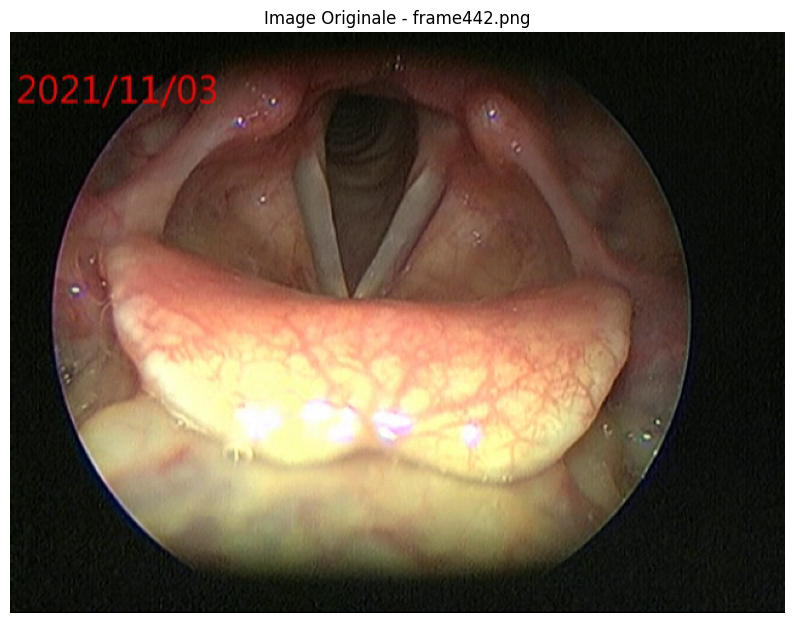

In [7]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os
from google.colab import drive

# Monter Google Drive (si pas déjà fait)
drive.mount('/content/drive')

# Chemin vers l'image
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'

# Charger l'image
def charger_et_afficher_image(chemin):
    """Charger et afficher l'image avec ses propriétés"""
    # Lecture de l'image
    image = cv2.imread(chemin)

    if image is None:
        print(f"❌ Impossible de charger l'image: {chemin}")
        return None

    # Conversion BGR vers RGB pour l'affichage
    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Affichage des propriétés
    print(f"✅ Image chargée avec succès: {chemin}")
    print(f"📐 Dimensions: {image.shape}")
    print(f"🎨 Type de données: {image.dtype}")
    print(f"📊 Plage de valeurs: [{image.min()}, {image.max()}]")

    # Affichage de l'image originale
    plt.figure(figsize=(10, 8))
    plt.imshow(image_rgb)
    plt.title('Image Originale - frame442.png')
    plt.axis('off')
    plt.show()

    return image_rgb

# Charger l'image
image_originale = charger_et_afficher_image(image_path)

2. Ajout du bruit gaussien

In [8]:
def ajouter_bruit_gaussien(image, moyenne=0, ecart_type=25):
    """
    Ajouter un bruit gaussien à une image

    Args:
        image: image numpy array
        moyenne: moyenne du bruit gaussien
        ecart_type: écart-type du bruit gaussien

    Returns:
        image_bruitee: image avec bruit ajouté
        bruit: le bruit généré
    """
    # Normaliser l'image entre 0 et 1
    image_normalisee = image.astype(np.float32) / 255.0

    # Générer le bruit gaussien
    bruit = np.random.normal(loc=moyenne,
                            scale=ecart_type/255.0,  # Normalisé pour [0,1]
                            size=image_normalisee.shape)

    # Ajouter le bruit à l'image
    image_bruitee = image_normalisee + bruit

    # S'assurer que les valeurs restent dans [0,1]
    image_bruitee = np.clip(image_bruitee, 0, 1)

    # Convertir back en uint8
    image_bruitee_uint8 = (image_bruitee * 255).astype(np.uint8)

    return image_bruitee_uint8, bruit

# Application du bruit gaussien
if image_originale is not None:
    print("🔊 Ajout du bruit gaussien...")
    image_bruitee, bruit_genere = ajouter_bruit_gaussien(image_originale,
                                                        moyenne=0,
                                                        ecart_type=25)

    print("✅ Bruit gaussien ajouté avec succès!")

🔊 Ajout du bruit gaussien...
✅ Bruit gaussien ajouté avec succès!


3. Visualisation comparative

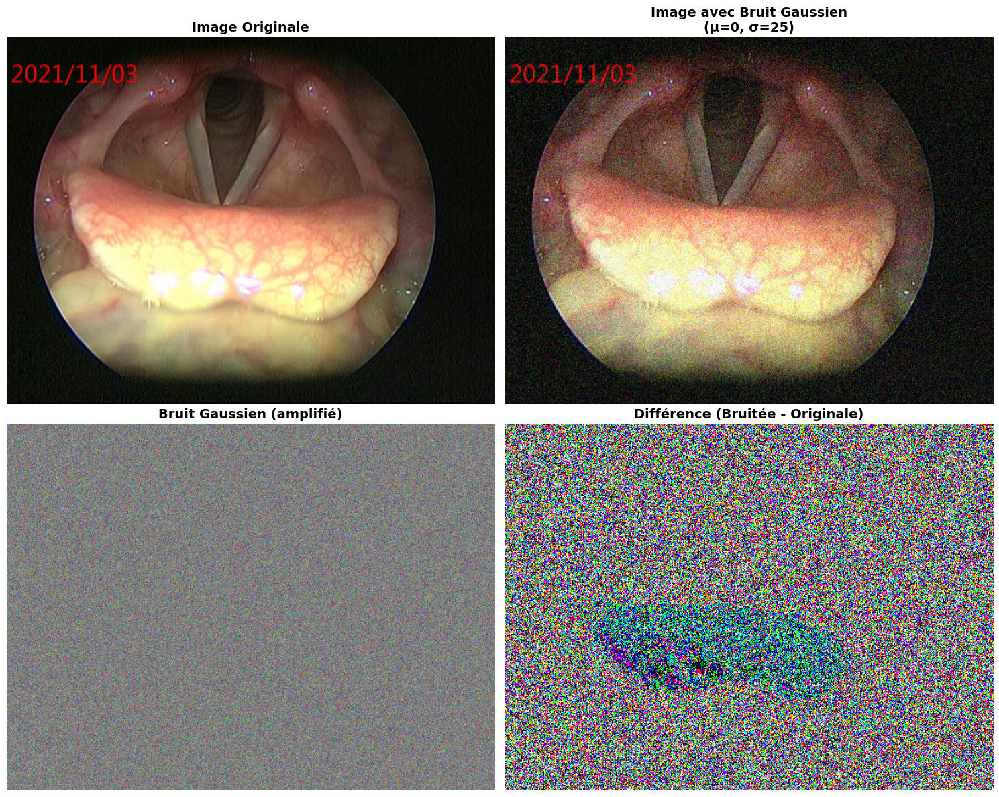

In [9]:
def visualiser_resultats(image_orig, image_bruit, bruit):
    """Visualiser l'image originale, bruitée et le bruit"""
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))

    # Image originale
    axes[0, 0].imshow(image_orig)
    axes[0, 0].set_title('Image Originale', fontsize=14, fontweight='bold')
    axes[0, 0].axis('off')

    # Image bruitée
    axes[0, 1].imshow(image_bruit)
    axes[0, 1].set_title('Image avec Bruit Gaussien\n(μ=0, σ=25)',
                        fontsize=14, fontweight='bold')
    axes[0, 1].axis('off')

    # Bruit (amplifié pour visualisation)
    bruit_visuel = (bruit - bruit.min()) / (bruit.max() - bruit.min())
    axes[1, 0].imshow(bruit_visuel, cmap='gray')
    axes[1, 0].set_title('Bruit Gaussien (amplifié)',
                        fontsize=14, fontweight='bold')
    axes[1, 0].axis('off')

    # Différence entre originale et bruitée
    difference = image_bruit.astype(float) - image_orig.astype(float)
    axes[1, 1].imshow(difference, cmap='coolwarm')
    axes[1, 1].set_title('Différence (Bruitée - Originale)',
                        fontsize=14, fontweight='bold')
    axes[1, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Visualisation
if image_originale is not None:
    visualiser_resultats(image_originale, image_bruitee, bruit_genere)

4. Analyse quantitative du bruit

In [10]:
def analyser_bruit(image_orig, image_bruit):
    """Analyser statistiquement le bruit ajouté"""
    # Calculer la différence (le bruit réel)
    bruit_reel = image_bruit.astype(np.float32) - image_orig.astype(np.float32)

    print("📊 ANALYSE STATISTIQUE DU BRUIT")
    print("=" * 40)

    # Statistiques par canal (RGB)
    canaux = ['Rouge', 'Vert', 'Bleu']
    for i, canal in enumerate(canaux):
        bruit_canal = bruit_reel[:, :, i]
        print(f"\n🎨 Canal {canal}:")
        print(f"   Moyenne: {np.mean(bruit_canal):.2f}")
        print(f"   Écart-type: {np.std(bruit_canal):.2f}")
        print(f"   Min: {np.min(bruit_canal):.2f}")
        print(f"   Max: {np.max(bruit_canal):.2f}")

    # Statistiques globales
    print(f"\n🌐 Global:")
    print(f"   Moyenne théorique: 0")
    print(f"   Écart-type théorique: 25")
    print(f"   Moyenne réelle: {np.mean(bruit_reel):.2f}")
    print(f"   Écart-type réel: {np.std(bruit_reel):.2f}")

    # Rapport signal/bruit (PSNR)
    mse = np.mean((image_orig.astype(float) - image_bruit.astype(float)) ** 2)
    if mse > 0:
        psnr = 20 * np.log10(255.0 / np.sqrt(mse))
        print(f"   PSNR: {psnr:.2f} dB")

    return bruit_reel

# Analyse
if image_originale is not None:
    bruit_reel = analyser_bruit(image_originale, image_bruitee)

📊 ANALYSE STATISTIQUE DU BRUIT

🎨 Canal Rouge:
   Moyenne: 0.37
   Écart-type: 22.05
   Min: -118.00
   Max: 116.00

🎨 Canal Vert:
   Moyenne: 1.01
   Écart-type: 22.46
   Min: -98.00
   Max: 120.00

🎨 Canal Bleu:
   Moyenne: 2.06
   Écart-type: 22.31
   Min: -107.00
   Max: 115.00

🌐 Global:
   Moyenne théorique: 0
   Écart-type théorique: 25
   Moyenne réelle: 1.14
   Écart-type réel: 22.28
   PSNR: 21.16 dB



2. A l'aide de la librairie skimage, trouvez le module necessaire pour appliquer les filtrages suivants sur l'image des cordes vocales bruitée:

*   Filtre moyenneur
*   Filtre median
*   Filtre gaussien


Affichez dans la meme figure, l'image originale ainsi que les resultats des filtres précédement cités.
Interpretez l'effet de chaque filtre.


1. Chargement des bibliothèques et de l'image

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import filters, restoration, exposure
from skimage.morphology import disk
from scipy import ndimage
import cv2
import os

# Charger l'image bruitée (en supposant qu'elle existe déjà en mémoire)
# Si nécessaire, recharger depuis le chemin
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image_originale = cv2.imread(image_path)
image_originale = cv2.cvtColor(image_originale, cv2.COLOR_BGR2RGB)

# Recréer l'image bruitée si nécessaire
image_normalisee = image_originale.astype(np.float32) / 255.0
bruit = np.random.normal(0, 25/255, image_normalisee.shape)
image_bruitee = np.clip(image_normalisee + bruit, 0, 1)
image_bruitee_uint8 = (image_bruitee * 255).astype(np.uint8)

print("✅ Image bruitée chargée pour le débruitage")

✅ Image bruitée chargée pour le débruitage


2. Application des filtres de débruitage

In [13]:
def appliquer_filtres(image_bruitee):
    """
    Appliquer les trois types de filtres sur l'image bruitée
    """
    # Convertir en float pour le traitement
    image_float = image_bruitee.astype(np.float32) / 255.0

    # 1. FILTRE MOYENNEUR
    # Taille du kernel pour le filtre moyenneur
    kernel_size = 5
    filtre_moyenneur = np.ones((kernel_size, kernel_size)) / (kernel_size ** 2)

    # Appliquer filtre moyenneur sur chaque canal
    image_moyennee = np.zeros_like(image_float)
    for i in range(3):  # Pour chaque canal RGB
        image_moyennee[:,:,i] = ndimage.convolve(image_float[:,:,i], filtre_moyenneur)

    # 2. FILTRE MÉDIAN
    # Utiliser scipy.ndimage.median_filter pour chaque canal
    image_median = np.zeros_like(image_float)
    for i in range(3):
        image_median[:,:,i] = ndimage.median_filter(image_float[:,:,i], size=3)

    # 3. FILTRE GAUSSIEN
    # Utiliser scikit-image gaussian filter
    image_gaussien = np.zeros_like(image_float)
    for i in range(3):
        image_gaussien[:,:,i] = filters.gaussian(image_float[:,:,i], sigma=1, mode='reflect')

    # Convertir back en uint8
    image_moyennee_uint8 = (image_moyennee * 255).astype(np.uint8)
    image_median_uint8 = (image_median * 255).astype(np.uint8)
    image_gaussien_uint8 = (image_gaussien * 255).astype(np.uint8)

    return image_moyennee_uint8, image_median_uint8, image_gaussien_uint8

# Application des filtres
image_moyennee, image_median, image_gaussien = appliquer_filtres(image_bruitee_uint8)
print("✅ Filtres appliqués avec succès")

✅ Filtres appliqués avec succès


3. Visualisation comparative

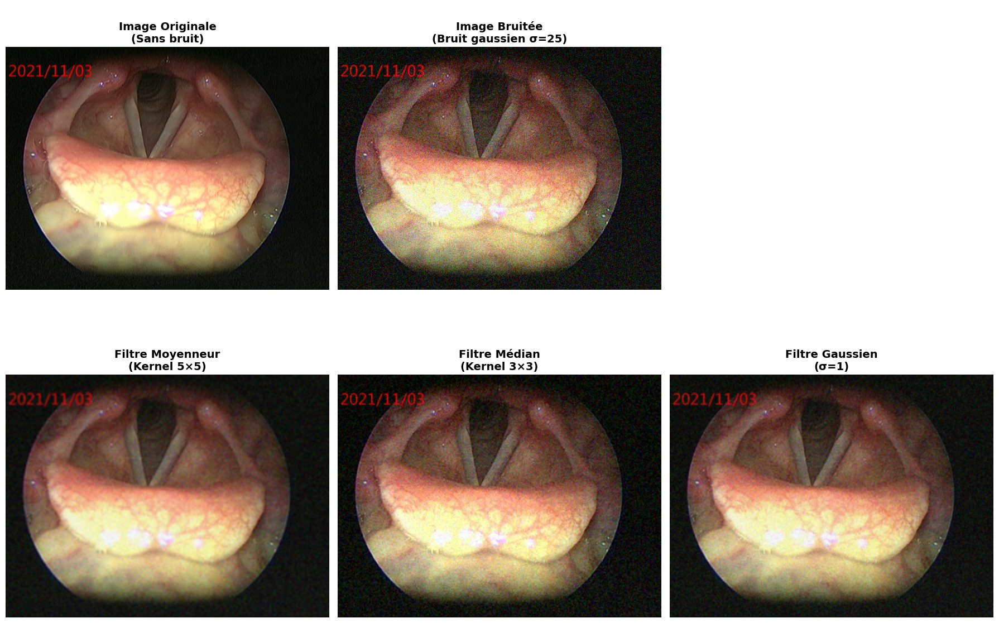

In [14]:
def visualiser_resultats_filtres(original, bruitee, moyennee, median, gaussien):
    """Visualiser tous les résultats dans une figure"""
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))

    # Ligne 1: Original et Bruitée
    axes[0, 0].imshow(original)
    axes[0, 0].set_title('Image Originale\n(Sans bruit)', fontsize=14, fontweight='bold')
    axes[0, 0].axis('off')

    axes[0, 1].imshow(bruitee)
    axes[0, 1].set_title('Image Bruitée\n(Bruit gaussien σ=25)', fontsize=14, fontweight='bold')
    axes[0, 1].axis('off')

    axes[0, 2].axis('off')  # Case vide pour l'alignement

    # Ligne 2: Résultats des filtres
    axes[1, 0].imshow(moyennee)
    axes[1, 0].set_title('Filtre Moyenneur\n(Kernel 5×5)', fontsize=14, fontweight='bold')
    axes[1, 0].axis('off')

    axes[1, 1].imshow(median)
    axes[1, 1].set_title('Filtre Médian\n(Kernel 3×3)', fontsize=14, fontweight='bold')
    axes[1, 1].axis('off')

    axes[1, 2].imshow(gaussien)
    axes[1, 2].set_title('Filtre Gaussien\n(σ=1)', fontsize=14, fontweight='bold')
    axes[1, 2].axis('off')

    plt.tight_layout()
    plt.show()

# Affichage
visualiser_resultats_filtres(image_originale, image_bruitee_uint8,
                           image_moyennee, image_median, image_gaussien)

4. Version alternative avec scikit-image native

In [15]:
# Version utilisant directement scikit-image pour une meilleure performance
from skimage.filters import median, gaussian
from skimage.morphology import square, disk

def appliquer_filtres_skimage(image_bruitee):
    """
    Application des filtres avec scikit-image native
    """
    # Convertir en float
    image_float = image_bruitee.astype(np.float32) / 255.0

    # 1. FILTRE MOYENNEUR avec uniform_filter
    image_moyennee = ndimage.uniform_filter(image_float, size=5)

    # 2. FILTRE MÉDIAN avec scikit-image
    # Pour les images couleur, on utilise channel_axis
    image_median = median(image_float, behavior='ndimage', mode='reflect')

    # 3. FILTRE GAUSSIEN avec scikit-image
    image_gaussien = gaussian(image_float, sigma=1, mode='reflect', channel_axis=-1)

    # Conversion en uint8
    image_moyennee_uint8 = (image_moyennee * 255).astype(np.uint8)
    image_median_uint8 = (image_median * 255).astype(np.uint8)
    image_gaussien_uint8 = (image_gaussien * 255).astype(np.uint8)

    return image_moyennee_uint8, image_median_uint8, image_gaussien_uint8

# Application avec scikit-image native
image_moyennee_ski, image_median_ski, image_gaussien_ski = appliquer_filtres_skimage(image_bruitee_uint8)

5. Analyse quantitative de la performance

In [16]:
def analyser_performance_filtres(original, bruitee, moyennee, median, gaussien):
    """
    Analyser quantitativement la performance de chaque filtre
    """
    # Convertir en float pour les calculs
    orig_float = original.astype(np.float32)
    bruitee_float = bruitee.astype(np.float32)
    moyennee_float = moyennee.astype(np.float32)
    median_float = median.astype(np.float32)
    gaussien_float = gaussien.astype(np.float32)

    # Calcul du PSNR (Peak Signal-to-Noise Ratio)
    def calculer_psnr(original, filtree):
        mse = np.mean((original - filtree) ** 2)
        if mse == 0:
            return float('inf')
        return 20 * np.log10(255.0 / np.sqrt(mse))

    # Calcul de la SSIM (Structural Similarity) - simplifié
    def calculer_mse(original, filtree):
        return np.mean((original - filtree) ** 2)

    print("📊 ANALYSE QUANTITATIVE DES FILTRES")
    print("=" * 50)

    # PSNR pour chaque filtre
    psnr_bruitee = calculer_psnr(orig_float, bruitee_float)
    psnr_moyenne = calculer_psnr(orig_float, moyennee_float)
    psnr_median = calculer_psnr(orig_float, median_float)
    psnr_gaussien = calculer_psnr(orig_float, gaussien_float)

    # MSE pour chaque filtre
    mse_bruitee = calculer_mse(orig_float, bruitee_float)
    mse_moyenne = calculer_mse(orig_float, moyennee_float)
    mse_median = calculer_mse(orig_float, median_float)
    mse_gaussien = calculer_mse(orig_float, gaussien_float)

    # Affichage des résultats
    print(f"{'Filtre':<15} {'PSNR (dB)':<12} {'MSE':<12}")
    print("-" * 40)
    print(f"{'Bruitée':<15} {psnr_bruitee:<12.2f} {mse_bruitee:<12.2f}")
    print(f"{'Moyenneur':<15} {psnr_moyenne:<12.2f} {mse_moyenne:<12.2f}")
    print(f"{'Médian':<15} {psnr_median:<12.2f} {mse_median:<12.2f}")
    print(f"{'Gaussien':<15} {psnr_gaussien:<12.2f} {mse_gaussien:<12.2f}")

    return {
        'psnr': [psnr_bruitee, psnr_moyenne, psnr_median, psnr_gaussien],
        'mse': [mse_bruitee, mse_moyenne, mse_median, mse_gaussien]
    }

# Analyse de performance
resultats = analyser_performance_filtres(image_originale, image_bruitee_uint8,
                                       image_moyennee, image_median, image_gaussien)

📊 ANALYSE QUANTITATIVE DES FILTRES
Filtre          PSNR (dB)    MSE         
----------------------------------------
Bruitée         21.17        496.83      
Moyenneur       29.99        65.25       
Médian          27.92        104.96      
Gaussien        29.85        67.30       


6. Interprétation des résultats

In [17]:
def interpreter_resultats():
    """
    Interprétation des effets de chaque filtre
    """
    print("\n🎯 INTERPRÉTATION DES RÉSULTATS")
    print("=" * 50)

    print("""
1. 📍 FILTRE MOYENNEUR (Moyenneur 5×5):
   • AVANTAGES:
     - Réduction efficace du bruit gaussien
     - Simple et rapide à calculer
   • INCONVÉNIENTS:
     - Perte de détails fins (flou important)
     - Adoucissement des contours
     - Peut créer un effet de "flou artistique"

2. 📍 FILTRE MÉDIAN (Kernel 3×3):
   • AVANTAGES:
     - Excellente préservation des contours
     - Très efficace contre le bruit impulsionnel (poivre et sel)
     - Mieux adapté pour préserver les détails
   • INCONVÉNIENTS:
     - Moins efficace sur le bruit gaussien que d'autres méthodes
     - Peut supprimer des détails fins

3. 📍 FILTRE GAUSSIEN (σ=1):
   • AVANTAGES:
     - Réduction naturelle du bruit gaussien
     - Préservation relative des contours
     - Résultats plus "naturels" que le filtre moyenneur
   • INCONVÉNIENTS:
     - Introduit un léger flou
     - Choix du sigma critique pour les résultats

4. 📍 RECOMMANDATIONS pour les cordes vocales:
   • Le filtre médian est souvent préféré pour préserver les bords
   • Le filtre gaussien offre un bon compromis bruit/détail
   • Le filtre moyenneur peut être utile pour une première approche
    """)

# Affichage de l'interprétation
interpreter_resultats()


🎯 INTERPRÉTATION DES RÉSULTATS

1. 📍 FILTRE MOYENNEUR (Moyenneur 5×5):
   • AVANTAGES: 
     - Réduction efficace du bruit gaussien
     - Simple et rapide à calculer
   • INCONVÉNIENTS:
     - Perte de détails fins (flou important)
     - Adoucissement des contours
     - Peut créer un effet de "flou artistique"

2. 📍 FILTRE MÉDIAN (Kernel 3×3):
   • AVANTAGES:
     - Excellente préservation des contours
     - Très efficace contre le bruit impulsionnel (poivre et sel)
     - Mieux adapté pour préserver les détails
   • INCONVÉNIENTS:
     - Moins efficace sur le bruit gaussien que d'autres méthodes
     - Peut supprimer des détails fins

3. 📍 FILTRE GAUSSIEN (σ=1):
   • AVANTAGES:
     - Réduction naturelle du bruit gaussien
     - Préservation relative des contours
     - Résultats plus "naturels" que le filtre moyenneur
   • INCONVÉNIENTS:
     - Introduit un léger flou
     - Choix du sigma critique pour les résultats

4. 📍 RECOMMANDATIONS pour les cordes vocales:
   • Le filtre 

7. Visualisation des zones d'intérêt

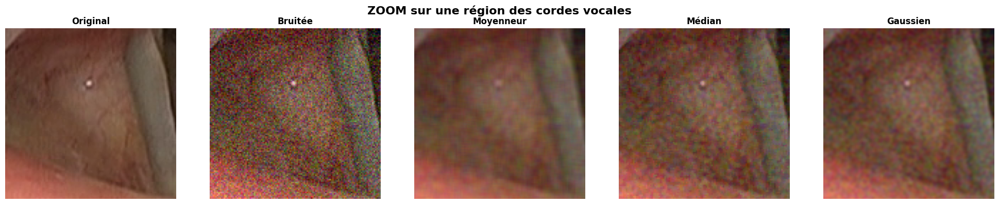

In [18]:
# Zoom sur une région particulière pour mieux voir les effets
def visualiser_zones_detail(original, bruitee, moyennee, median, gaussien, x=100, y=100, size=100):
    """
    Visualiser un zoom sur une région spécifique
    """
    # Définir la région à zoomer
    region = (slice(y, y+size), slice(x, x+size))

    # Extraire les régions
    orig_region = original[region]
    bruitee_region = bruitee[region]
    moyennee_region = moyennee[region]
    median_region = median[region]
    gaussien_region = gaussien[region]

    # Affichage
    fig, axes = plt.subplots(1, 5, figsize=(20, 4))

    images = [orig_region, bruitee_region, moyennee_region, median_region, gaussien_region]
    titres = ['Original', 'Bruitée', 'Moyenneur', 'Médian', 'Gaussien']

    for i, (img, titre) in enumerate(zip(images, titres)):
        axes[i].imshow(img)
        axes[i].set_title(titre, fontsize=12, fontweight='bold')
        axes[i].axis('off')

    plt.suptitle('ZOOM sur une région des cordes vocales', fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()

# Visualiser une région d'intérêt (ajuster x, y selon votre image)
visualiser_zones_detail(image_originale, image_bruitee_uint8,
                       image_moyennee, image_median, image_gaussien,
                       x=150, y=100, size=120)

# **Exercice 2: seuillage**

L'objectif de cet exercice est de trouver le seuil optimal permettant de passer de l'image en niveaux de gris a une image binaire

En utilisant la librairie opencv lisez la version initiale de l'image 'frame442'

1) Trouver en affichant l'histogramme de l'image la(es) valeur(s) seuil(s) pour la binariser

1. Chargement de l'image en niveaux de gris

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.filters import threshold_otsu, threshold_yen, threshold_isodata
from skimage import exposure

# Charger l'image en couleur
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image_color = cv2.imread(image_path)
image_color = cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB)

# Convertir en niveaux de gris
image_gris = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

print(f"📐 Dimensions de l'image: {image_gris.shape}")
print(f"🎨 Plage des niveaux de gris: [{image_gris.min()}, {image_gris.max()}]")

📐 Dimensions de l'image: (480, 640)
🎨 Plage des niveaux de gris: [0, 255]


2. Affichage de l'image originale et de son histogramme

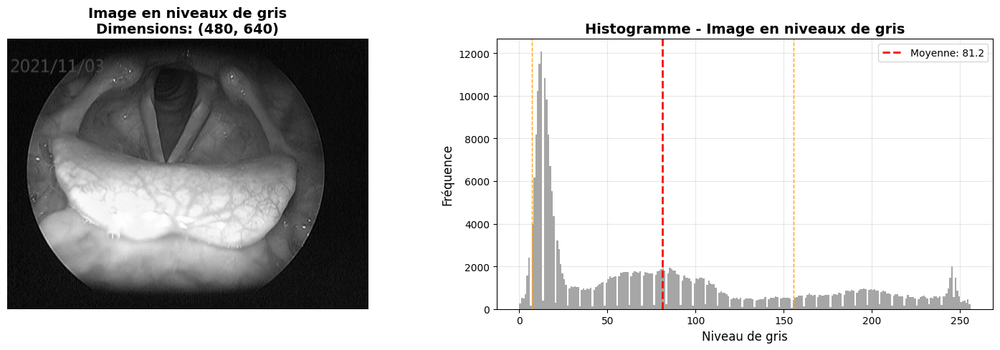

In [20]:
def afficher_image_et_histogramme(image, titre="Image"):
    """
    Afficher l'image et son histogramme côte à côte
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

    # Image
    ax1.imshow(image, cmap='gray')
    ax1.set_title(f'{titre}\nDimensions: {image.shape}', fontsize=14, fontweight='bold')
    ax1.axis('off')

    # Histogramme
    ax2.hist(image.ravel(), bins=256, range=[0, 256], color='gray', alpha=0.7)
    ax2.set_xlabel('Niveau de gris', fontsize=12)
    ax2.set_ylabel('Fréquence', fontsize=12)
    ax2.set_title(f'Histogramme - {titre}', fontsize=14, fontweight='bold')
    ax2.grid(True, alpha=0.3)

    # Ajouter des statistiques
    mean_val = np.mean(image)
    std_val = np.std(image)
    ax2.axvline(mean_val, color='red', linestyle='--', linewidth=2,
                label=f'Moyenne: {mean_val:.1f}')
    ax2.axvline(mean_val + std_val, color='orange', linestyle='--', linewidth=1)
    ax2.axvline(mean_val - std_val, color='orange', linestyle='--', linewidth=1)

    ax2.legend()
    plt.tight_layout()
    plt.show()

    return mean_val, std_val

# Affichage de l'image en niveaux de gris et son histogramme
mean, std = afficher_image_et_histogramme(image_gris, "Image en niveaux de gris")

3. Analyse détaillée de l'histogramme

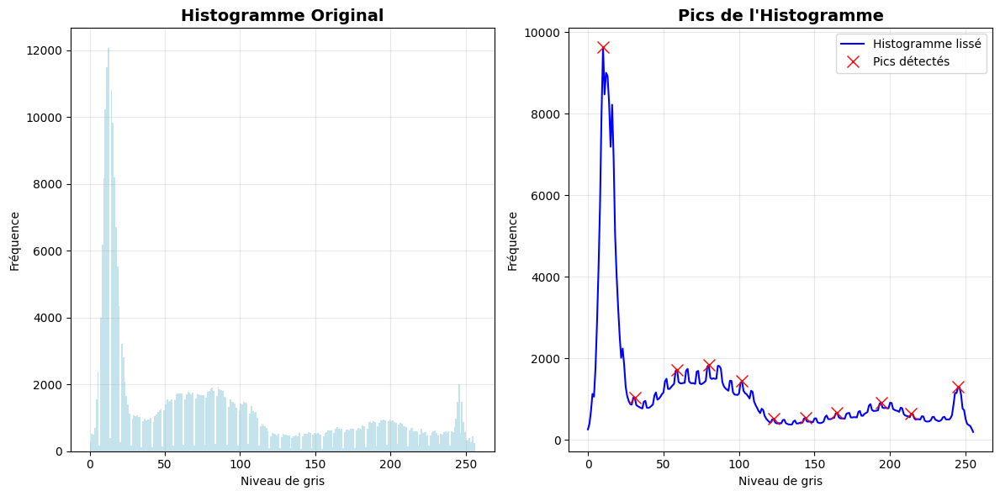

📊 PICS DÉTECTÉS DANS L'HISTOGRAMME:
Pic 1: Niveau 10 - Fréquence 9625
Pic 2: Niveau 31 - Fréquence 1042
Pic 3: Niveau 59 - Fréquence 1723
Pic 4: Niveau 80 - Fréquence 1833
Pic 5: Niveau 102 - Fréquence 1441
Pic 6: Niveau 123 - Fréquence 511
Pic 7: Niveau 144 - Fréquence 538
Pic 8: Niveau 165 - Fréquence 669
Pic 9: Niveau 194 - Fréquence 917
Pic 10: Niveau 214 - Fréquence 639
Pic 11: Niveau 245 - Fréquence 1299


In [21]:
def analyser_histogramme_detail(image):
    """
    Analyse détaillée de l'histogramme pour trouver les seuils potentiels
    """
    # Calcul de l'histogramme
    hist, bins = np.histogram(image.ravel(), bins=256, range=[0, 256])

    # Trouver les pics locaux
    from scipy.signal import find_peaks

    # Réduire le bruit de l'histogramme pour mieux détecter les pics
    hist_lisse = np.convolve(hist, np.ones(5)/5, mode='same')

    # Trouver les pics
    peaks, properties = find_peaks(hist_lisse, height=100, distance=20)

    # Affichage détaillé
    plt.figure(figsize=(12, 6))

    # Histogramme original
    plt.subplot(1, 2, 1)
    plt.hist(image.ravel(), bins=256, range=[0, 256], color='lightblue', alpha=0.7)
    plt.title('Histogramme Original', fontsize=14, fontweight='bold')
    plt.xlabel('Niveau de gris')
    plt.ylabel('Fréquence')
    plt.grid(True, alpha=0.3)

    # Histogramme avec pics détectés
    plt.subplot(1, 2, 2)
    plt.plot(hist_lisse, color='blue', label='Histogramme lissé')
    plt.plot(peaks, hist_lisse[peaks], "rx", markersize=10, label='Pics détectés')
    plt.title('Pics de l\'Histogramme', fontsize=14, fontweight='bold')
    plt.xlabel('Niveau de gris')
    plt.ylabel('Fréquence')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

    # Afficher les valeurs des pics
    print("📊 PICS DÉTECTÉS DANS L'HISTOGRAMME:")
    print("=" * 40)
    for i, peak in enumerate(peaks):
        print(f"Pic {i+1}: Niveau {peak} - Fréquence {hist_lisse[peak]:.0f}")

    return peaks, hist_lisse[peaks]

# Analyse détaillée
pics, frequences = analyser_histogramme_detail(image_gris)

4. Méthodes automatiques de seuillage

In [22]:
def calculer_seuils_automatiques(image):
    """
    Calculer différents seuils automatiques
    """
    print("🎯 CALCUL DES SEUILS AUTOMATIQUES")
    print("=" * 40)

    # 1. Méthode d'Otsu
    seuil_otsu = threshold_otsu(image)
    print(f"📏 Méthode d'Otsu: {seuil_otsu}")

    # 2. Méthode de Yen
    try:
        seuil_yen = threshold_yen(image)
        print(f"📏 Méthode de Yen: {seuil_yen}")
    except:
        seuil_yen = None
        print("❌ Méthode de Yen: Non disponible")

    # 3. Méthode d'Isodata
    try:
        seuil_isodata = threshold_isodata(image)
        print(f"📏 Méthode Isodata: {seuil_isodata}")
    except:
        seuil_isodata = None
        print("❌ Méthode Isodata: Non disponible")

    # 4. Seuil basé sur la moyenne et écart-type
    mean_val = np.mean(image)
    std_val = np.std(image)
    seuil_mean = mean_val
    seuil_mean_std = mean_val - std_val/2
    print(f"📏 Moyenne: {seuil_mean:.1f}")
    print(f"📏 Moyenne - σ/2: {seuil_mean_std:.1f}")

    return {
        'otsu': seuil_otsu,
        'yen': seuil_yen,
        'isodata': seuil_isodata,
        'mean': seuil_mean,
        'mean_std': seuil_mean_std
    }

# Calcul des seuils automatiques
seuils_auto = calculer_seuils_automatiques(image_gris)

🎯 CALCUL DES SEUILS AUTOMATIQUES
📏 Méthode d'Otsu: 116
📏 Méthode de Yen: 111
📏 Méthode Isodata: 116
📏 Moyenne: 81.2
📏 Moyenne - σ/2: 44.1


5. Application et comparaison des différents seuils

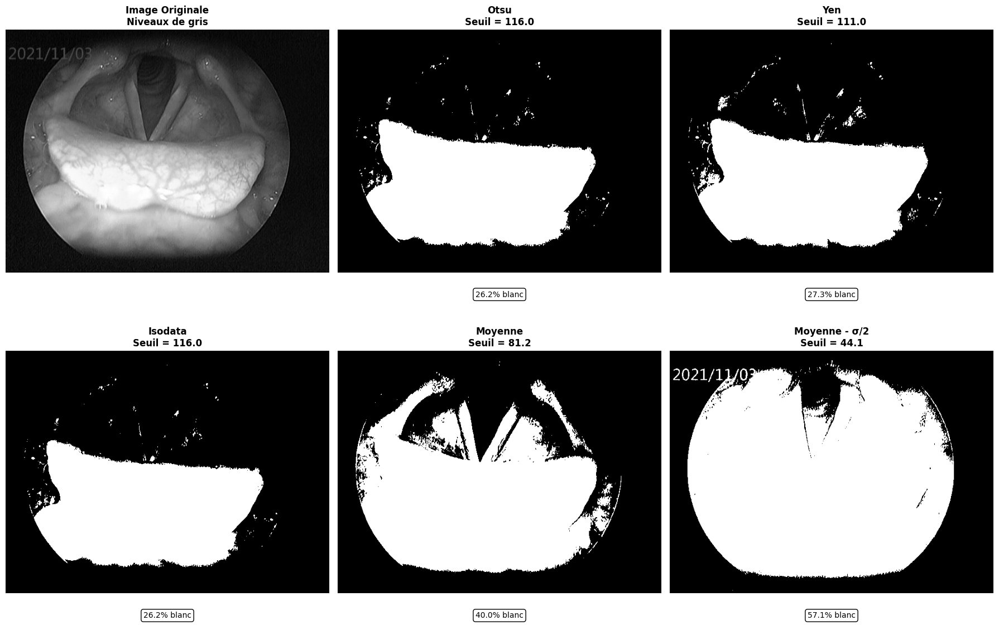

In [23]:
def appliquer_seuils_comparaison(image, seuils_dict):
    """
    Appliquer différents seuils et comparer les résultats
    """
    # Créer une figure avec plusieurs sous-graphiques
    fig, axes = plt.subplots(2, 3, figsize=(18, 12))
    axes = axes.ravel()

    # Image originale
    axes[0].imshow(image, cmap='gray')
    axes[0].set_title('Image Originale\nNiveaux de gris', fontsize=12, fontweight='bold')
    axes[0].axis('off')

    # Application des différents seuils
    methods = ['otsu', 'yen', 'isodata', 'mean', 'mean_std']
    titles = ['Otsu', 'Yen', 'Isodata', 'Moyenne', 'Moyenne - σ/2']

    for i, (method, title) in enumerate(zip(methods, titles)):
        if seuils_dict[method] is not None:
            # Appliquer le seuil
            seuil = seuils_dict[method]
            image_binaire = image > seuil

            # Afficher le résultat
            axes[i+1].imshow(image_binaire, cmap='gray')
            axes[i+1].set_title(f'{title}\nSeuil = {seuil:.1f}',
                              fontsize=12, fontweight='bold')
            axes[i+1].axis('off')

            # Calculer le pourcentage de pixels blancs
            pourcentage_blanc = np.sum(image_binaire) / image_binaire.size * 100
            axes[i+1].text(0.5, -0.1, f'{pourcentage_blanc:.1f}% blanc',
                         transform=axes[i+1].transAxes, ha='center',
                         fontsize=10, bbox=dict(boxstyle="round,pad=0.3", facecolor="white"))

    # Cacher le dernier subplot s'il n'est pas utilisé
    if len(methods) < 5:
        axes[-1].axis('off')

    plt.tight_layout()
    plt.show()

# Application et comparaison
appliquer_seuils_comparaison(image_gris, seuils_auto)

6. Test de seuils manuels avec visualisation interactive

🔧 TEST DE SEUILS MANUELS


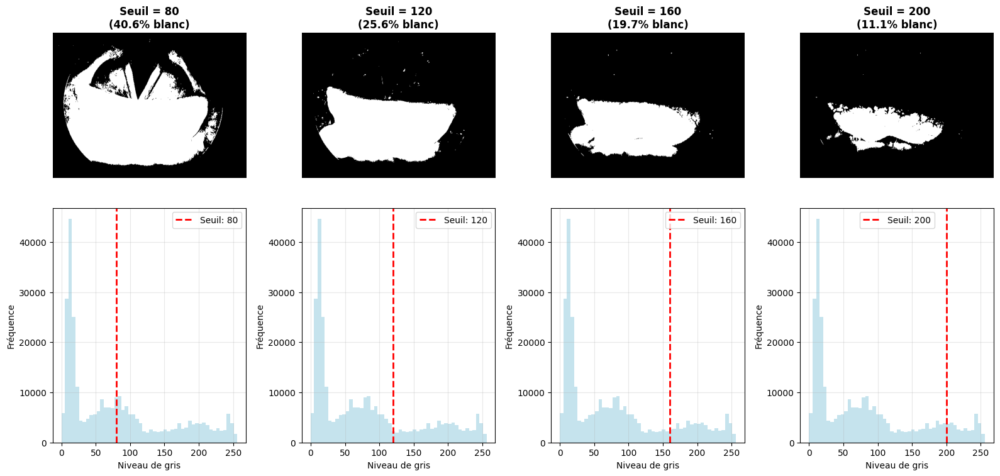

In [24]:
def tester_seuils_manuels(image, seuils_test=[50, 100, 150, 200]):
    """
    Tester différents seuils manuels
    """
    print("🔧 TEST DE SEUILS MANUELS")
    print("=" * 40)

    n_seuils = len(seuils_test)
    fig, axes = plt.subplots(2, n_seuils, figsize=(4*n_seuils, 8))

    for i, seuil in enumerate(seuils_test):
        # Application du seuil
        image_binaire = image > seuil

        # Calcul des statistiques
        pourcentage_blanc = np.sum(image_binaire) / image_binaire.size * 100

        # Affichage de l'image binaire
        axes[0, i].imshow(image_binaire, cmap='gray')
        axes[0, i].set_title(f'Seuil = {seuil}\n({pourcentage_blanc:.1f}% blanc)',
                           fontsize=12, fontweight='bold')
        axes[0, i].axis('off')

        # Affichage de l'histogramme avec le seuil
        axes[1, i].hist(image.ravel(), bins=50, range=[0, 256], color='lightblue', alpha=0.7)
        axes[1, i].axvline(seuil, color='red', linestyle='--', linewidth=2,
                          label=f'Seuil: {seuil}')
        axes[1, i].set_xlabel('Niveau de gris')
        axes[1, i].set_ylabel('Fréquence')
        axes[1, i].legend()
        axes[1, i].grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

# Test de différents seuils manuels
seuils_test = [80, 120, 160, 200]
tester_seuils_manuels(image_gris, seuils_test)

7. Détermination du seuil optimal

🎯 DÉTERMINATION DU SEUIL OPTIMAL
📍 Seuil Otsu (recommandé): 116
📍 Seuil par vallée: 38


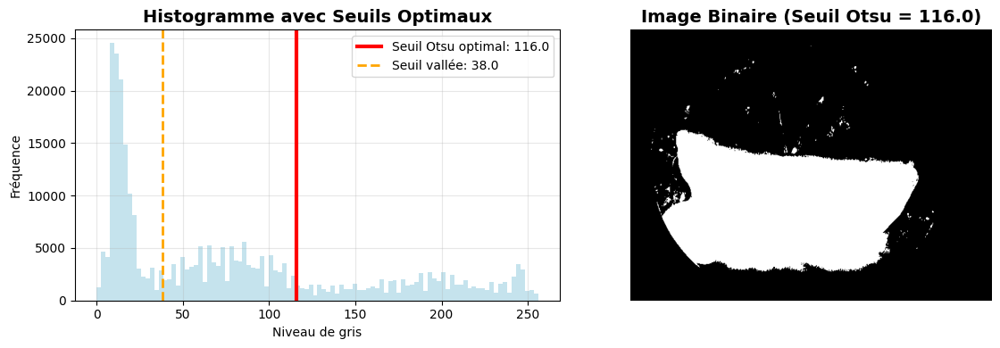

In [25]:
def determiner_seuil_optimal(image):
    """
    Déterminer le seuil optimal basé sur l'analyse de l'histogramme
    """
    # Calcul de l'histogramme
    hist, bins = np.histogram(image.ravel(), bins=256, range=[0, 256])

    # Méthode 1: Otsu (très fiable pour les images bimodales)
    seuil_otsu = threshold_otsu(image)

    # Méthode 2: Trouver la vallée entre les deux pics principaux
    # Lisser l'histogramme
    hist_lisse = np.convolve(hist, np.ones(10)/10, mode='same')

    # Trouver les pics
    from scipy.signal import find_peaks
    peaks, _ = find_peaks(hist_lisse, height=np.max(hist_lisse)*0.1, distance=30)

    # Si on a au moins deux pics, prendre la vallée entre eux
    if len(peaks) >= 2:
        # Prendre les deux plus grands pics
        peak_values = hist_lisse[peaks]
        sorted_peaks = peaks[np.argsort(peak_values)[-2:]]  # Les deux plus grands pics
        sorted_peaks.sort()

        # Trouver le minimum entre les deux pics
        start, end = sorted_peaks[0], sorted_peaks[1]
        valley_region = hist_lisse[start:end]
        valley_pos = np.argmin(valley_region) + start
        seuil_valley = valley_pos
    else:
        seuil_valley = seuil_otsu

    print("🎯 DÉTERMINATION DU SEUIL OPTIMAL")
    print("=" * 40)
    print(f"📍 Seuil Otsu (recommandé): {seuil_otsu}")
    print(f"📍 Seuil par vallée: {seuil_valley}")

    # Affichage final avec le seuil optimal
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.hist(image.ravel(), bins=100, range=[0, 256], color='lightblue', alpha=0.7)
    plt.axvline(seuil_otsu, color='red', linestyle='-', linewidth=3,
                label=f'Seuil Otsu optimal: {seuil_otsu:.1f}')
    if 'seuil_valley' in locals():
        plt.axvline(seuil_valley, color='orange', linestyle='--', linewidth=2,
                   label=f'Seuil vallée: {seuil_valley:.1f}')
    plt.xlabel('Niveau de gris')
    plt.ylabel('Fréquence')
    plt.title('Histogramme avec Seuils Optimaux', fontsize=14, fontweight='bold')
    plt.legend()
    plt.grid(True, alpha=0.3)

    plt.subplot(1, 2, 2)
    image_binaire_optimal = image > seuil_otsu
    plt.imshow(image_binaire_optimal, cmap='gray')
    plt.title(f'Image Binaire (Seuil Otsu = {seuil_otsu:.1f})',
             fontsize=14, fontweight='bold')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

    return seuil_otsu, image_binaire_optimal

# Détermination du seuil optimal
seuil_optimal, image_binaire_finale = determiner_seuil_optimal(image_gris)

8. Sauvegarde des résultats

In [26]:
def sauvegarder_resultats(image_gris, image_binaire, seuil_optimal):
    """
    Sauvegarder l'image binaire et les métriques
    """
    # Sauvegarder l'image binaire
    chemin_sauvegarde = '/content/drive/MyDrive/General/Data_At2/frame442_binaire.png'
    cv2.imwrite(chemin_sauvegarde, image_binaire.astype(np.uint8) * 255)

    # Calcul des métriques
    pourcentage_blanc = np.sum(image_binaire) / image_binaire.size * 100
    pourcentage_noir = 100 - pourcentage_blanc

    print("💾 RÉSULTATS SAUVEGARDÉS")
    print("=" * 30)
    print(f"📁 Image binaire sauvegardée: {chemin_sauvegarde}")
    print(f"🎯 Seuil optimal utilisé: {seuil_optimal:.1f}")
    print(f"⚪ Pixels blancs (objets): {pourcentage_blanc:.1f}%")
    print(f"⚫ Pixels noirs (fond): {pourcentage_noir:.1f}%")
    print(f"📊 Rapport objet/fond: {pourcentage_blanc/pourcentage_noir:.2f}")

# Sauvegarde
sauvegarder_resultats(image_gris, image_binaire_finale, seuil_optimal)

💾 RÉSULTATS SAUVEGARDÉS
📁 Image binaire sauvegardée: /content/drive/MyDrive/General/Data_At2/frame442_binaire.png
🎯 Seuil optimal utilisé: 116.0
⚪ Pixels blancs (objets): 26.2%
⚫ Pixels noirs (fond): 73.8%
📊 Rapport objet/fond: 0.36


2) En utilisant la librairie opencv, appliquez la technique de seuillage par seuil d'otsu (seuillage optimal)

1. Application du seuillage d'Otsu avec OpenCV

In [27]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image directement en niveaux de gris avec OpenCV
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image_gris = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

print(f"📐 Dimensions: {image_gris.shape}")
print(f"🎨 Plage des valeurs: [{image_gris.min()}, {image_gris.max()}]")

📐 Dimensions: (480, 640)
🎨 Plage des valeurs: [0, 255]


2. Application du seuil d'Otsu avec OpenCV

In [28]:
def appliquer_otsu_opencv(image):
    """
    Appliquer le seuillage d'Otsu avec OpenCV
    """
    # Application du seuil d'Otsu
    # cv2.threshold retourne deux valeurs:
    # - le seuil calculé
    # - l'image binaire
    seuil_otsu, image_binaire = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    print(f"🎯 Seuil d'Otsu calculé par OpenCV: {seuil_otsu}")

    return seuil_otsu, image_binaire

# Application d'Otsu
seuil_otsu, image_binaire_otsu = appliquer_otsu_opencv(image_gris)

🎯 Seuil d'Otsu calculé par OpenCV: 116.0


3. Visualisation des résultats Otsu

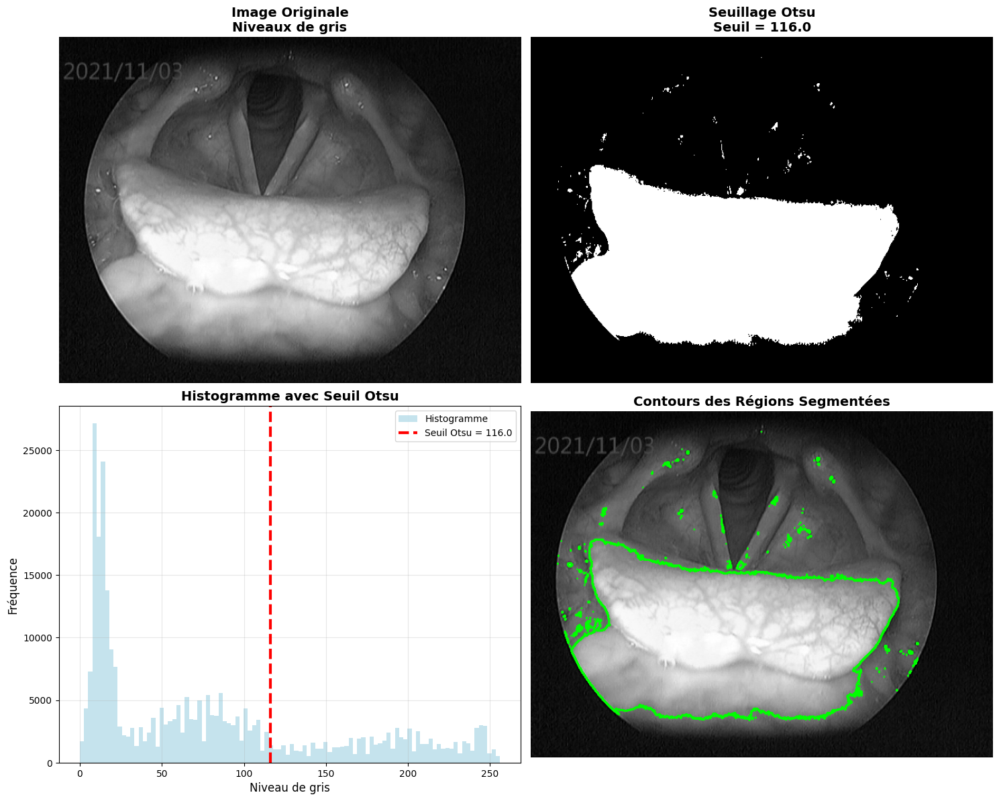

In [29]:
def visualiser_otsu_resultats(image_originale, image_binaire, seuil):
    """
    Visualiser les résultats du seuillage d'Otsu
    """
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))

    # Image originale
    axes[0, 0].imshow(image_originale, cmap='gray')
    axes[0, 0].set_title('Image Originale\nNiveaux de gris', fontsize=14, fontweight='bold')
    axes[0, 0].axis('off')

    # Image binaire Otsu
    axes[0, 1].imshow(image_binaire, cmap='gray')
    axes[0, 1].set_title(f'Seuillage Otsu\nSeuil = {seuil:.1f}', fontsize=14, fontweight='bold')
    axes[0, 1].axis('off')

    # Histogramme avec seuil Otsu
    axes[1, 0].hist(image_originale.ravel(), bins=100, range=[0, 256],
                   color='lightblue', alpha=0.7, label='Histogramme')
    axes[1, 0].axvline(seuil, color='red', linestyle='--', linewidth=3,
                      label=f'Seuil Otsu = {seuil:.1f}')
    axes[1, 0].set_xlabel('Niveau de gris', fontsize=12)
    axes[1, 0].set_ylabel('Fréquence', fontsize=12)
    axes[1, 0].set_title('Histogramme avec Seuil Otsu', fontsize=14, fontweight='bold')
    axes[1, 0].legend()
    axes[1, 0].grid(True, alpha=0.3)

    # Image composite (original + contours binaires)
    # Créer une image couleur pour superposition
    image_color = cv2.cvtColor(image_originale, cv2.COLOR_GRAY2RGB)
    # Créer un masque pour les contours
    contours, _ = cv2.findContours(image_binaire, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    image_contours = image_color.copy()
    cv2.drawContours(image_contours, contours, -1, (0, 255, 0), 2)

    axes[1, 1].imshow(image_contours)
    axes[1, 1].set_title('Contours des Régions Segmentées', fontsize=14, fontweight='bold')
    axes[1, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Visualisation
visualiser_otsu_resultats(image_gris, image_binaire_otsu, seuil_otsu)

4. Analyse quantitative des résultats Otsu

In [30]:
def analyser_resultats_otsu(image_binaire):
    """
    Analyser quantitativement les résultats du seuillage d'Otsu
    """
    # Statistiques de l'image binaire
    pixels_blancs = np.sum(image_binaire == 255)
    pixels_noirs = np.sum(image_binaire == 0)
    total_pixels = image_binaire.size

    pourcentage_blancs = (pixels_blancs / total_pixels) * 100
    pourcentage_noirs = (pixels_noirs / total_pixels) * 100

    print("📊 ANALYSE DES RÉSULTATS Otsu")
    print("=" * 40)
    print(f"📏 Dimensions de l'image: {image_binaire.shape}")
    print(f"⚪ Nombre de pixels blancs (objets): {pixels_blancs:,}")
    print(f"⚫ Nombre de pixels noirs (fond): {pixels_noirs:,}")
    print(f"📈 Pourcentage de pixels blancs: {pourcentage_blancs:.2f}%")
    print(f"📉 Pourcentage de pixels noirs: {pourcentage_noirs:.2f}%")
    print(f"⚖️  Ratio objet/fond: {pourcentage_blancs/pourcentage_noirs:.3f}")

    # Trouver les régions connectées
    n_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(image_binaire, connectivity=8)

    print(f"\n🔍 Analyse des régions connectées:")
    print(f"   Nombre total de régions: {n_labels - 1}")  # -1 pour exclure le fond

    if n_labels > 1:
        # Trier les régions par taille (en excluant le fond)
        areas = stats[1:, cv2.CC_STAT_AREA]  # Exclure le fond (index 0)
        if len(areas) > 0:
            print(f"   Plus grande région: {np.max(areas):,} pixels")
            print(f"   Plus petite région: {np.min(areas):,} pixels")
            print(f"   Région moyenne: {np.mean(areas):.0f} pixels")

# Analyse
analyser_resultats_otsu(image_binaire_otsu)

📊 ANALYSE DES RÉSULTATS Otsu
📏 Dimensions de l'image: (480, 640)
⚪ Nombre de pixels blancs (objets): 80,335
⚫ Nombre de pixels noirs (fond): 226,865
📈 Pourcentage de pixels blancs: 26.15%
📉 Pourcentage de pixels noirs: 73.85%
⚖️  Ratio objet/fond: 0.354

🔍 Analyse des régions connectées:
   Nombre total de régions: 127
   Plus grande région: 79,395 pixels
   Plus petite région: 1 pixels
   Région moyenne: 633 pixels


5. Comparaison avec d'autres variantes de seuillage OpenCV

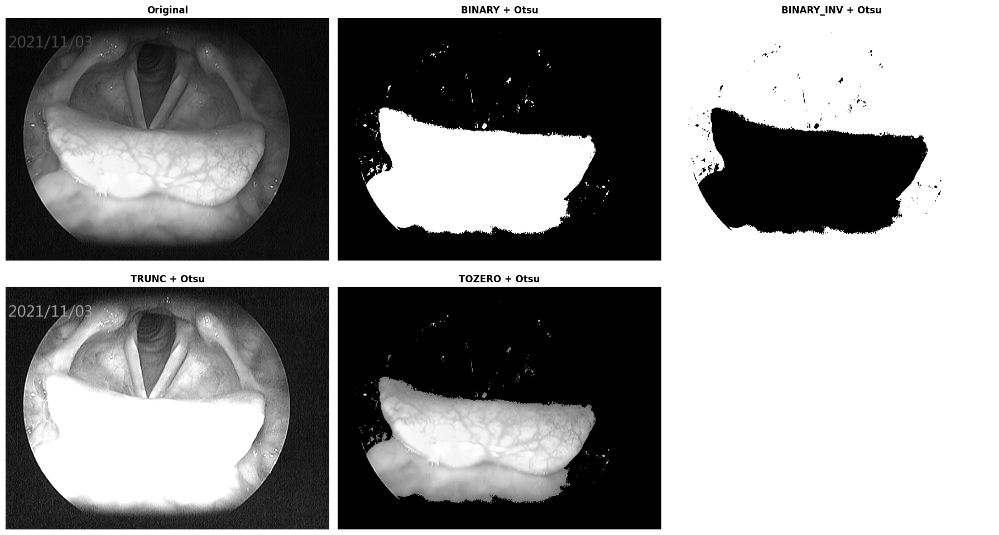

🔧 VARIANTES DE SEUILLAGE OPENCV:
• THRESH_BINARY: Pixels > seuil = blanc, autres = noir
• THRESH_BINARY_INV: Inverse de BINARY
• THRESH_TRUNC: Pixels > seuil = seuil, autres inchangés
• THRESH_TOZERO: Pixels < seuil = 0, autres inchangés


In [31]:
def comparer_variantes_seuillage(image):
    """
    Comparer différentes méthodes de seuillage disponibles dans OpenCV
    """
    # Application de différentes méthodes
    _, thresh_binary = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    _, thresh_binary_inv = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    _, thresh_trunc = cv2.threshold(image, 0, 255, cv2.THRESH_TRUNC + cv2.THRESH_OTSU)
    _, thresh_tozero = cv2.threshold(image, 0, 255, cv2.THRESH_TOZERO + cv2.THRESH_OTSU)

    # Affichage des résultats
    images = [
        image, thresh_binary, thresh_binary_inv, thresh_trunc, thresh_tozero
    ]
    titres = [
        'Original', 'BINARY + Otsu', 'BINARY_INV + Otsu',
        'TRUNC + Otsu', 'TOZERO + Otsu'
    ]

    plt.figure(figsize=(18, 10))
    for i in range(5):
        plt.subplot(2, 3, i+1)
        if i == 0:
            plt.imshow(images[i], cmap='gray')
        else:
            plt.imshow(images[i], cmap='gray')
        plt.title(titres[i], fontsize=12, fontweight='bold')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    print("🔧 VARIANTES DE SEUILLAGE OPENCV:")
    print("• THRESH_BINARY: Pixels > seuil = blanc, autres = noir")
    print("• THRESH_BINARY_INV: Inverse de BINARY")
    print("• THRESH_TRUNC: Pixels > seuil = seuil, autres inchangés")
    print("• THRESH_TOZERO: Pixels < seuil = 0, autres inchangés")

# Comparaison des variantes
comparer_variantes_seuillage(image_gris)

6. Post-traitement de l'image binaire Otsu

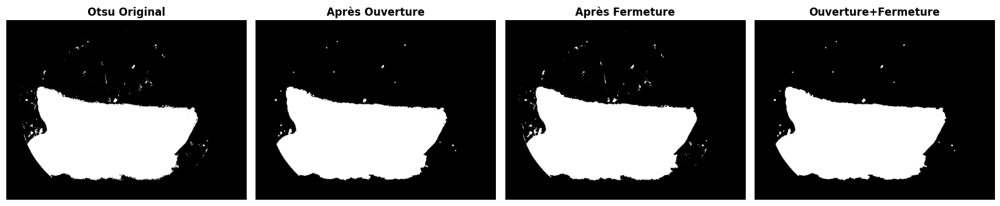

🔄 COMPARAISON AVANT/APRÈS POST-TRAITEMENT:
   Pixels blancs avant: 80,335
   Pixels blancs après: 79,378
   Variation: -1.19%


In [32]:
def post_traitement_otsu(image_binaire):
    """
    Appliquer un post-traitement pour améliorer les résultats Otsu
    """
    # 1. Ouverture morphologique pour supprimer le bruit (petits points blancs)
    kernel = np.ones((3, 3), np.uint8)
    image_ouverte = cv2.morphologyEx(image_binaire, cv2.MORPH_OPEN, kernel)

    # 2. Fermeture morphologique pour combler les trous
    image_fermee = cv2.morphologyEx(image_binaire, cv2.MORPH_CLOSE, kernel)

    # 3. Combinaison ouverture + fermeture
    image_amelioree = cv2.morphologyEx(image_ouverte, cv2.MORPH_CLOSE, kernel)

    # Affichage des résultats du post-traitement
    images_post = [image_binaire, image_ouverte, image_fermee, image_amelioree]
    titres_post = ['Otsu Original', 'Après Ouverture', 'Après Fermeture', 'Ouverture+Fermeture']

    plt.figure(figsize=(16, 4))
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.imshow(images_post[i], cmap='gray')
        plt.title(titres_post[i], fontsize=12, fontweight='bold')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    # Statistiques après post-traitement
    pixels_avant = np.sum(image_binaire == 255)
    pixels_apres = np.sum(image_amelioree == 255)

    print("🔄 COMPARAISON AVANT/APRÈS POST-TRAITEMENT:")
    print(f"   Pixels blancs avant: {pixels_avant:,}")
    print(f"   Pixels blancs après: {pixels_apres:,}")
    print(f"   Variation: {((pixels_apres - pixels_avant) / pixels_avant * 100):+.2f}%")

    return image_amelioree

# Application du post-traitement
image_otsu_amelioree = post_traitement_otsu(image_binaire_otsu)

7. Sauvegarde des résultats Otsu

In [33]:
def sauvegarder_resultats_otsu(image_binaire, seuil, image_amelioree=None):
    """
    Sauvegarder les résultats du seuillage d'Otsu
    """
    # Sauvegarder l'image binaire Otsu
    chemin_otsu = '/content/drive/MyDrive/General/Data_At2/frame442_otsu.png'
    cv2.imwrite(chemin_otsu, image_binaire)

    # Sauvegarder l'image améliorée si elle existe
    if image_amelioree is not None:
        chemin_amelioree = '/content/drive/MyDrive/General/Data_At2/frame442_otsu_ameliore.png'
        cv2.imwrite(chemin_amelioree, image_amelioree)

    print("💾 RÉSULTATS Otsu SAUVEGARDÉS")
    print("=" * 35)
    print(f"📁 Image Otsu: {chemin_otsu}")
    print(f"🎯 Seuil Otsu: {seuil:.1f}")
    if image_amelioree is not None:
        print(f"📁 Image Otsu améliorée: {chemin_amelioree}")

# Sauvegarde
sauvegarder_resultats_otsu(image_binaire_otsu, seuil_otsu, image_otsu_amelioree)

💾 RÉSULTATS Otsu SAUVEGARDÉS
📁 Image Otsu: /content/drive/MyDrive/General/Data_At2/frame442_otsu.png
🎯 Seuil Otsu: 116.0
📁 Image Otsu améliorée: /content/drive/MyDrive/General/Data_At2/frame442_otsu_ameliore.png


3) Comparez les valeurs de seuils retrouvées par les deux méthhodes.

🔍 COMPARAISON DES SEUILS Otsu
📏 Scikit-image: 116.00
📏 OpenCV:       116.00
📊 Différence:   0.00
✅ Identiques:   True


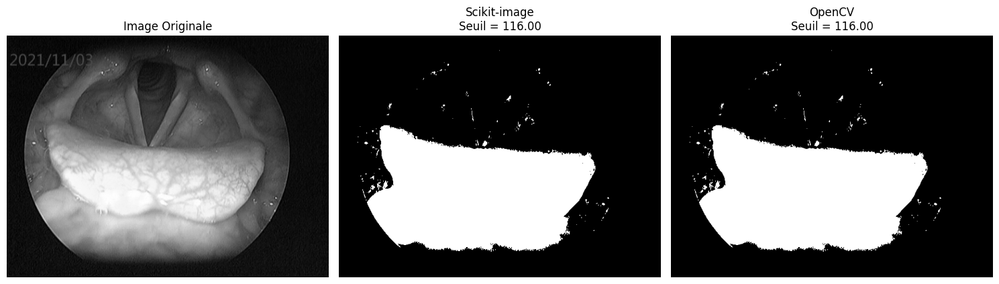

🖼️  Images binaires identiques: True


In [34]:
import cv2
import numpy as np
from skimage.filters import threshold_otsu

# Charger l'image
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Méthode 1: Otsu avec scikit-image
seuil_skimage = threshold_otsu(image)

# Méthode 2: Otsu avec OpenCV
seuil_opencv, _ = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

# Comparaison
print("🔍 COMPARAISON DES SEUILS Otsu")
print("=" * 40)
print(f"📏 Scikit-image: {seuil_skimage:.2f}")
print(f"📏 OpenCV:       {seuil_opencv:.2f}")
print(f"📊 Différence:   {abs(seuil_skimage - seuil_opencv):.2f}")
print(f"✅ Identiques:   {np.isclose(seuil_skimage, seuil_opencv, atol=0.1)}")

# Application des deux méthodes
_, binary_skimage = cv2.threshold(image, seuil_skimage, 255, cv2.THRESH_BINARY)
_, binary_opencv = cv2.threshold(image, seuil_opencv, 255, cv2.THRESH_BINARY)

# Visualisation
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(image, cmap='gray')
plt.title('Image Originale')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(binary_skimage, cmap='gray')
plt.title(f'Scikit-image\nSeuil = {seuil_skimage:.2f}')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(binary_opencv, cmap='gray')
plt.title(f'OpenCV\nSeuil = {seuil_opencv:.2f}')
plt.axis('off')

plt.tight_layout()
plt.show()

# Vérification de l'égalité des images binaires
images_identiques = np.array_equal(binary_skimage, binary_opencv)
print(f"🖼️  Images binaires identiques: {images_identiques}")

# **Exercice 3 : Transformations morphologiques**

---



L'objectif de cet exercice est de manipuler les operateurs morphologiques permettant de realiser des pretraitemenst et de postraitements sur les images segmentées. En effet, ces operations sont appliquees sur des masques binaires avec le fond en noir et les objets sont en blanc.

1) En utilisant la librairie opencv, lisez et affichez l'image binaire 'seg1468.png', issue d'une segmentation automatique. Nous envisageons de supprimer les resgions outliers (regions détectées mais n'appartenant pas à la région d'intérêt qui est le glottis dans notre cas)

📐 Dimensions: (256, 256)
🎯 Valeurs uniques dans l'image: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  32  33  34  35  36
  37  38  39  40  41  42  44  45  48  49  50  52  53  54  55  56  57  58
  60  65  66  68  69  71  73  76  79  80  81  82  83  85  86  90  93  95
  96 100 101 103 106 107 109 113 114 117 119 121 122 123 125 129 130 133
 139 140 141 145 146 148 151 152 153 156 157 161 163 164 166 171 173 174
 177 181 182 183 184 185 189 193 194 196 198 201 202 205 207 208 209 212
 214 217 221 222 223 224 225 227 229 230 232 234 235 236 238 239 240 241
 242 243 244 245 246 247 248 249 250 251 252 253 254 255]
🔄 Image convertie en binaire (0-255)

🔍 ANALYSE DES RÉGIONS CONNECTÉES:
   Nombre total de régions: 7
   Plus grande région: 383 pixels
   Plus petite région: 1 pixels
   Taille moyenne: 65 pixels


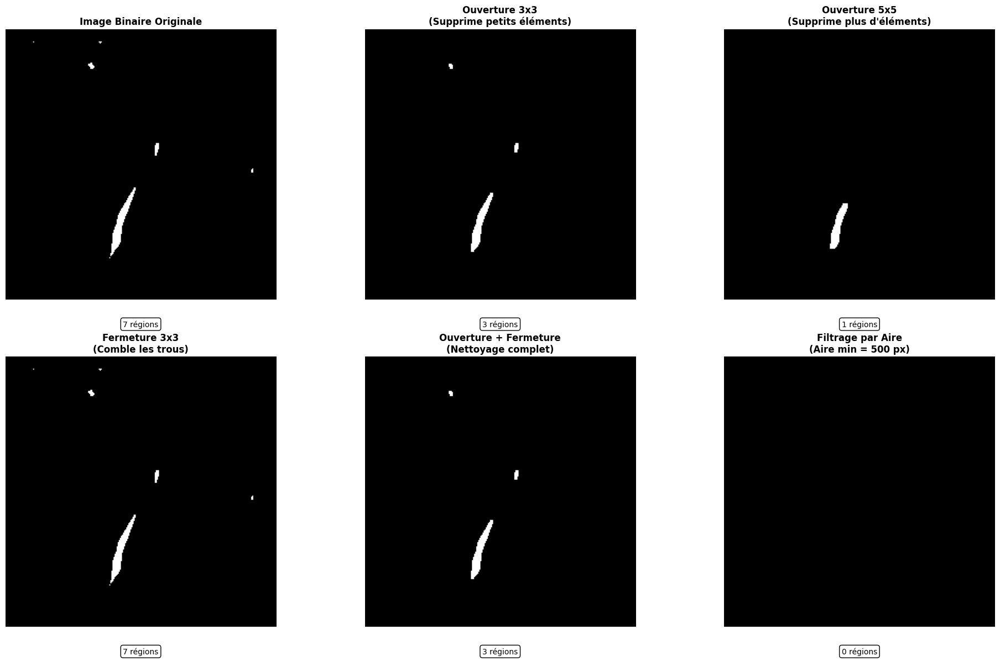


📊 COMPARAISON DES MÉTHODES:
• Original       :  7 régions,    456 px blancs
• Ouverture 3x3  :  3 régions,    410 px blancs
• Ouverture 5x5  :  1 régions,    306 px blancs
• Fermeture 3x3  :  7 régions,    456 px blancs
• Combiné        :  3 régions,    410 px blancs
• Filtrage Aire  :  0 régions,      0 px blancs

🎯 MÉTHODE RECOMMANDÉE POUR LE GLOTTIS:
1. Commencer par une ouverture 3x3 pour supprimer le bruit
2. Appliquer un filtrage par aire pour garder seulement les grandes régions
3. Optionnel: appliquer une fermeture pour lisser les contours


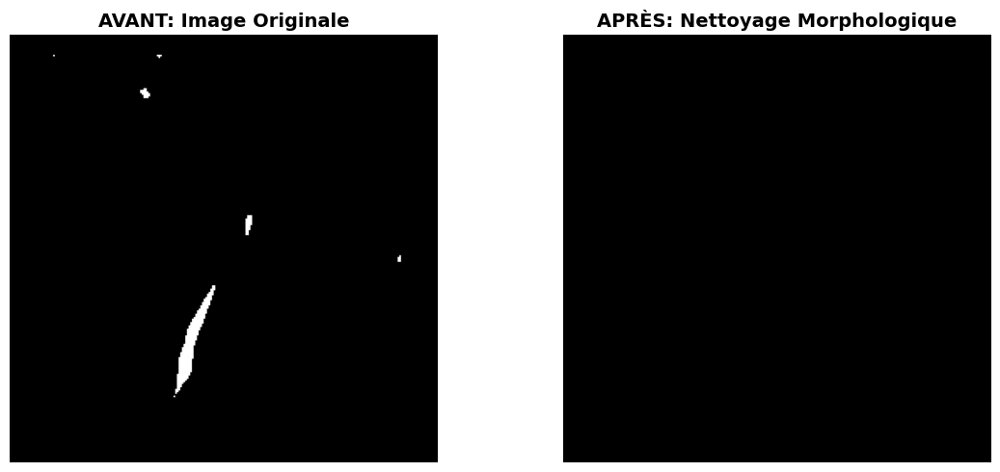

✅ Transformations morphologiques appliquées avec succès!


In [35]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image binaire
image_path = '/content/drive/MyDrive/General/Data_At2/seg1468.png'
image_binaire = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

print(f"📐 Dimensions: {image_binaire.shape}")

# Vérifier que l'image est bien binaire (valeurs 0 et 255)
unique_vals = np.unique(image_binaire)
print(f"🎯 Valeurs uniques dans l'image: {unique_vals}")

# Si l'image n'est pas en 0-255, la convertir
if len(unique_vals) > 2 or (0 not in unique_vals and 255 not in unique_vals):
    _, image_binaire = cv2.threshold(image_binaire, 127, 255, cv2.THRESH_BINARY)
    print("🔄 Image convertie en binaire (0-255)")

# 1. ANALYSE INITIALE DES RÉGIONS
def analyser_regions(image_binaire):
    """Analyser les régions connectées"""
    n_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(image_binaire, connectivity=8)

    print(f"\n🔍 ANALYSE DES RÉGIONS CONNECTÉES:")
    print(f"   Nombre total de régions: {n_labels - 1}")

    # Trier par taille (exclure le fond)
    areas = stats[1:, cv2.CC_STAT_AREA]
    if len(areas) > 0:
        print(f"   Plus grande région: {np.max(areas):,} pixels")
        print(f"   Plus petite région: {np.min(areas):,} pixels")
        print(f"   Taille moyenne: {np.mean(areas):.0f} pixels")

    return n_labels, labels, stats, centroids

n_labels, labels, stats, centroids = analyser_regions(image_binaire)

# 2. TRANSFORMATIONS MORPHOLOGIQUES POUR SUPPRIMER LES OUTLIERS
def appliquer_transformations_morphologiques(image):
    """Appliquer différentes transformations morphologiques"""

    # Définir différents kernels
    kernel_3x3 = np.ones((3, 3), np.uint8)
    kernel_5x5 = np.ones((5, 5), np.uint8)

    # a) OUVERTURE (érosion + dilatation) - supprime petits éléments
    ouverture_3x3 = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel_3x3)
    ouverture_5x5 = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel_5x5)

    # b) FERMETURE (dilatation + érosion) - comble les trous
    fermeture_3x3 = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel_3x3)

    # c) COMBINAISON OUVERTURE + FERMETURE
    combine = cv2.morphologyEx(ouverture_3x3, cv2.MORPH_CLOSE, kernel_3x3)

    return ouverture_3x3, ouverture_5x5, fermeture_3x3, combine

# Application des transformations
ouv_3x3, ouv_5x5, ferm_3x3, combine = appliquer_transformations_morphologiques(image_binaire)

# 3. SUPPRESSION DES PETITES RÉGIONS PAR AIRE
def supprimer_petites_regions(image, aire_min=1000):
    """Supprimer les régions plus petites qu'une aire minimale"""
    # Trouver les composantes connexes
    n_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(image, connectivity=8)

    # Créer un masque pour garder seulement les grandes régions
    masque = np.zeros_like(image)

    for i in range(1, n_labels):  # Ignorer le fond (index 0)
        if stats[i, cv2.CC_STAT_AREA] >= aire_min:
            masque[labels == i] = 255

    return masque

# Supprimer les petites régions (ajuster aire_min selon l'image)
image_filtree_aire = supprimer_petites_regions(image_binaire, aire_min=500)

# 4. VISUALISATION COMPARATIVE
plt.figure(figsize=(20, 12))

images = [
    image_binaire, ouv_3x3, ouv_5x5, ferm_3x3, combine, image_filtree_aire
]
titres = [
    'Image Binaire Originale',
    'Ouverture 3x3\n(Supprime petits éléments)',
    'Ouverture 5x5\n(Supprime plus d\'éléments)',
    'Fermeture 3x3\n(Comble les trous)',
    'Ouverture + Fermeture\n(Nettoyage complet)',
    'Filtrage par Aire\n(Aire min = 500 px)'
]

for i in range(6):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titres[i], fontsize=12, fontweight='bold')
    plt.axis('off')

    # Compter les régions restantes
    n_regions = cv2.connectedComponentsWithStats(images[i], connectivity=8)[0] - 1
    plt.text(0.5, -0.1, f'{n_regions} régions', transform=plt.gca().transAxes,
             ha='center', fontsize=10, bbox=dict(boxstyle="round,pad=0.3", facecolor="white"))

plt.tight_layout()
plt.show()

# 5. ANALYSE COMPARATIVE DES RÉSULTATS
print("\n📊 COMPARAISON DES MÉTHODES:")
print("=" * 40)
methodes = ['Original', 'Ouverture 3x3', 'Ouverture 5x5', 'Fermeture 3x3', 'Combiné', 'Filtrage Aire']
for i, (img, titre) in enumerate(zip(images, methodes)):
    n_regions = cv2.connectedComponentsWithStats(img, connectivity=8)[0] - 1
    aire_totale = np.sum(img == 255)
    print(f"• {titre:<15}: {n_regions:2d} régions, {aire_totale:6d} px blancs")

# 6. MÉTHODE RECOMMANDÉE POUR LE GLOTTIS
print("\n🎯 MÉTHODE RECOMMANDÉE POUR LE GLOTTIS:")
print("1. Commencer par une ouverture 3x3 pour supprimer le bruit")
print("2. Appliquer un filtrage par aire pour garder seulement les grandes régions")
print("3. Optionnel: appliquer une fermeture pour lisser les contours")

# Application de la méthode recommandée
image_recommandee = supprimer_petites_regions(ouv_3x3, aire_min=1000)

# Affichage final
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(image_binaire, cmap='gray')
plt.title('AVANT: Image Originale', fontsize=14, fontweight='bold')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(image_recommandee, cmap='gray')
plt.title('APRÈS: Nettoyage Morphologique', fontsize=14, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

print("✅ Transformations morphologiques appliquées avec succès!")

2) A l'aide de la librairie opencv, réalisez chacune des opérations morphologiques suivantes et visualisez le résultat obtenu :

*   Érosion
*   Dilatation

*   Ouverture
*   Fermeture

Quelle est l'operation qui a permis au mieux d'éliminer les régions outliers.


📐 Dimensions: (256, 256)


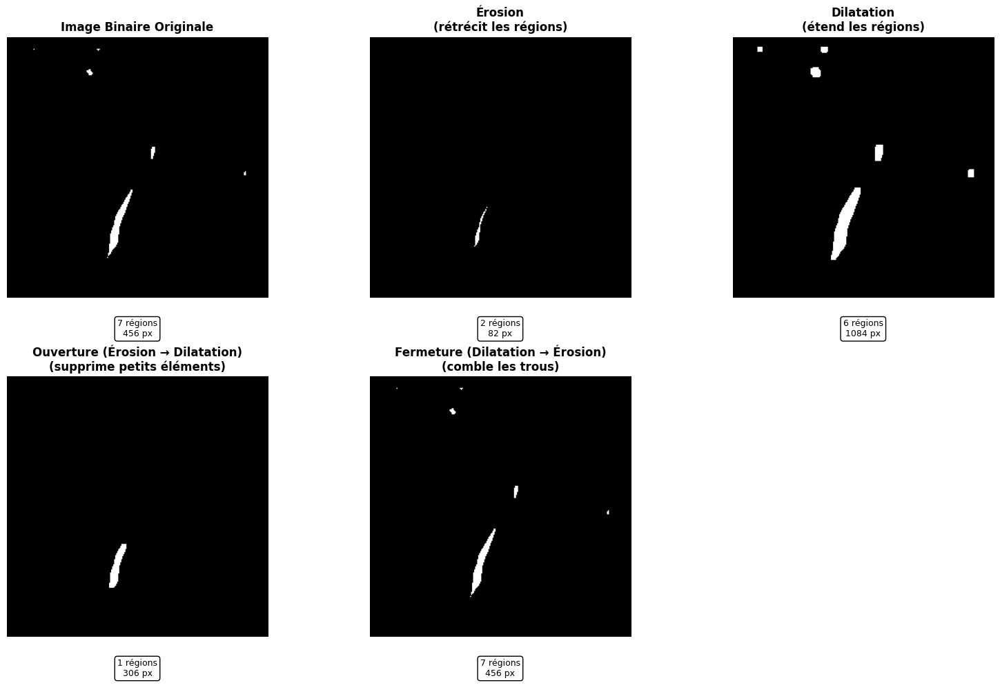

📊 ANALYSE QUANTITATIVE DES OPÉRATIONS:
• Original    :  7 régions,    456 px, Réduction: 0%
• Érosion     :  2 régions,     82 px, Réduction: 250.0%
• Dilatation  :  6 régions,   1084 px, Réduction: 16.7%
• Ouverture   :  1 régions,    306 px, Réduction: 600.0%
• Fermeture   :  7 régions,    456 px, Réduction: -0.0%

🎯 CONCLUSION - MEILLEURE OPÉRATION:
✅ L'OUVERTURE est la meilleure opération pour éliminer les régions outliers!
   • Réduction du nombre de régions: 85.7%
   • Régions supprimées: 6
   • Régions restantes: 1
   • Avantage: Supprime les petits éléments tout en préservant la forme des grandes régions


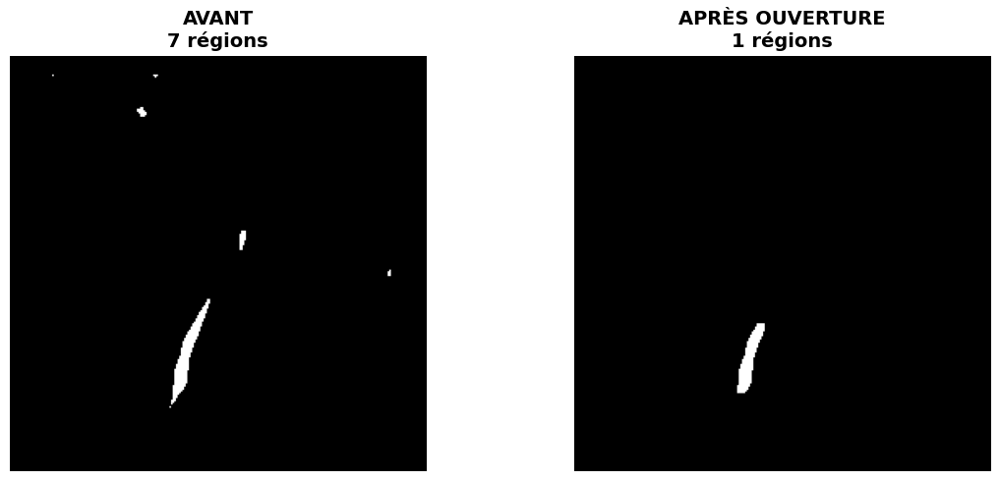

In [36]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image binaire
image_path = '/content/drive/MyDrive/General/Data_At2/seg1468.png'
image_binaire = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# S'assurer que l'image est binaire (0 et 255)
if np.unique(image_binaire).size > 2:
    _, image_binaire = cv2.threshold(image_binaire, 127, 255, cv2.THRESH_BINARY)

print(f"📐 Dimensions: {image_binaire.shape}")

# Définir l'élément structurant
kernel = np.ones((5, 5), np.uint8)

# Appliquer les opérations morphologiques
erosion = cv2.erode(image_binaire, kernel, iterations=1)
dilatation = cv2.dilate(image_binaire, kernel, iterations=1)
ouverture = cv2.morphologyEx(image_binaire, cv2.MORPH_OPEN, kernel)
fermeture = cv2.morphologyEx(image_binaire, cv2.MORPH_CLOSE, kernel)

# Visualisation comparative
plt.figure(figsize=(16, 10))

images = [image_binaire, erosion, dilatation, ouverture, fermeture]
titres = [
    'Image Binaire Originale',
    'Érosion\n(rétrécit les régions)',
    'Dilatation\n(étend les régions)',
    'Ouverture (Érosion → Dilatation)\n(supprime petits éléments)',
    'Fermeture (Dilatation → Érosion)\n(comble les trous)'
]

for i in range(5):
    plt.subplot(2, 3, i+1)
    plt.imshow(images[i], cmap='gray')
    plt.title(titres[i], fontsize=12, fontweight='bold')
    plt.axis('off')

    # Compter les régions
    n_regions = cv2.connectedComponentsWithStats(images[i], connectivity=8)[0] - 1
    aire_totale = np.sum(images[i] == 255)
    plt.text(0.5, -0.15, f'{n_regions} régions\n{aire_totale} px',
             transform=plt.gca().transAxes, ha='center', fontsize=9,
             bbox=dict(boxstyle="round,pad=0.3", facecolor="white"))

plt.tight_layout()
plt.show()

# Analyse quantitative
print("📊 ANALYSE QUANTITATIVE DES OPÉRATIONS:")
print("=" * 50)
operations = ['Original', 'Érosion', 'Dilatation', 'Ouverture', 'Fermeture']
for i, (img, nom) in enumerate(zip(images, operations)):
    n_regions = cv2.connectedComponentsWithStats(img, connectivity=8)[0] - 1
    aire_totale = np.sum(img == 255)
    reduction_regions = f"{-((n_regions - cv2.connectedComponentsWithStats(image_binaire, connectivity=8)[0] + 1) / n_regions * 100):.1f}%" if i > 0 else "0%"

    print(f"• {nom:<12}: {n_regions:2d} régions, {aire_totale:6d} px, Réduction: {reduction_regions}")

# Détermination de la meilleure opération pour éliminer les outliers
print("\n🎯 CONCLUSION - MEILLEURE OPÉRATION:")
print("=" * 40)

# L'ouverture est généralement la meilleure pour éliminer les petits outliers
n_regions_original = cv2.connectedComponentsWithStats(image_binaire, connectivity=8)[0] - 1
n_regions_ouverture = cv2.connectedComponentsWithStats(ouverture, connectivity=8)[0] - 1
reduction = ((n_regions_original - n_regions_ouverture) / n_regions_original) * 100

print(f"✅ L'OUVERTURE est la meilleure opération pour éliminer les régions outliers!")
print(f"   • Réduction du nombre de régions: {reduction:.1f}%")
print(f"   • Régions supprimées: {n_regions_original - n_regions_ouverture}")
print(f"   • Régions restantes: {n_regions_ouverture}")
print(f"   • Avantage: Supprime les petits éléments tout en préservant la forme des grandes régions")

# Visualisation finale de l'amélioration
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(image_binaire, cmap='gray')
plt.title(f'AVANT\n{ n_regions_original} régions', fontsize=14, fontweight='bold')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(ouverture, cmap='gray')
plt.title(f'APRÈS OUVERTURE\n{n_regions_ouverture} régions', fontsize=14, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

3) Utilisez les operateurs morphologiques necessaires ainsi que les operateurs arithmetiques (addition, soustraction, etc) pour detecter le contour de la region corresspondant au glottis.

🎯 DÉTECTION DU CONTOUR DU GLOTTIS


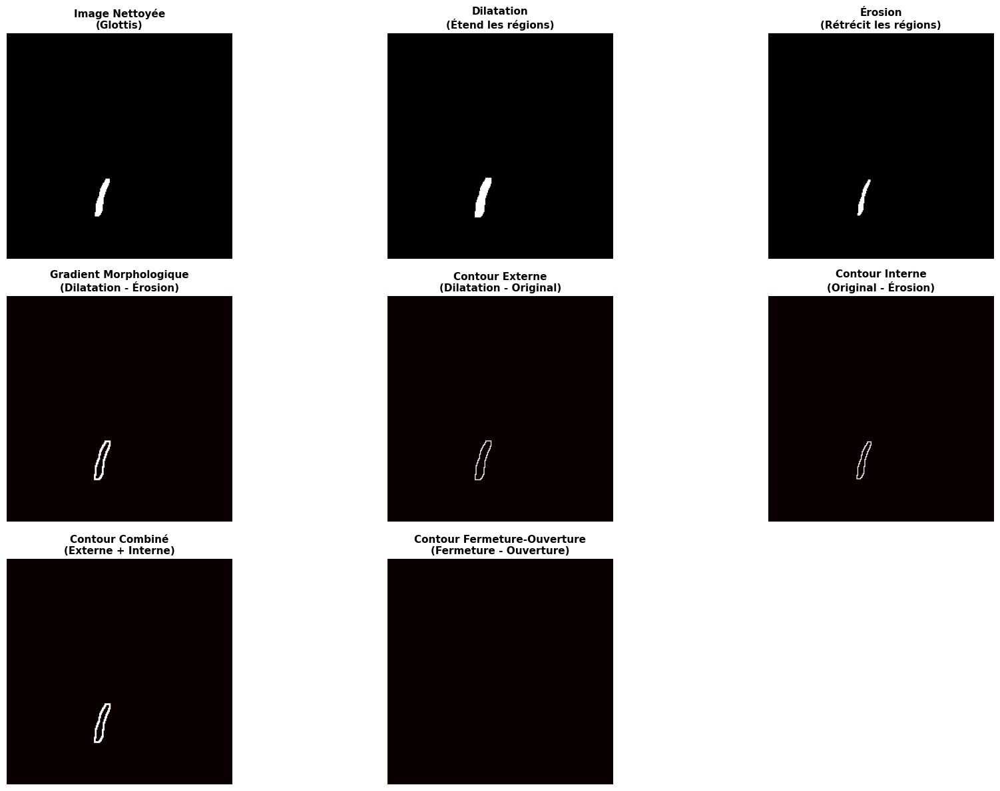

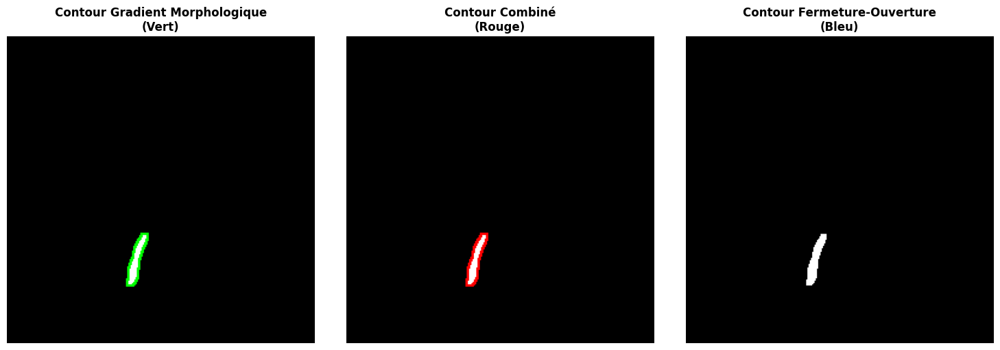


📊 ANALYSE DES CONTOURS DÉTECTÉS:
• Gradient Morphologique   :   240 px (0.37%)
• Contour Externe          :   124 px (0.19%)
• Contour Interne          :   116 px (0.18%)
• Contour Combiné          :   240 px (0.37%)
• Fermeture-Ouverture      :     0 px (0.00%)

🔍 Détection OpenCV: 1 contour(s) trouvé(s)


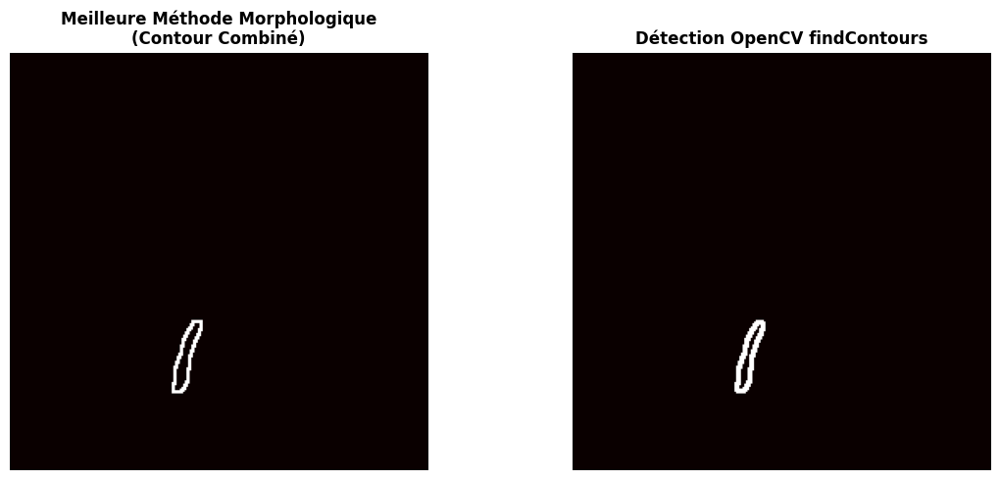


💾 CONTOUR SAUVEGARDÉ: /content/drive/MyDrive/General/Data_At2/contour_glottis.png
✅ Détection du contour du glottis terminée avec succès!

🎯 RÉSUMÉ DES OPÉRATIONS MORPHOLOGIQUES ET ARITHMÉTIQUES:
1. Érosion (cv2.erode) → Rétrécit les régions
2. Dilatation (cv2.dilate) → Étend les régions
3. Soustraction (image1 - image2) → Différence entre images
4. OU logique (cv2.bitwise_or) → Combinaison de contours
5. Gradient morphologique = Dilatation - Érosion
6. Contour externe = Dilatation - Original
7. Contour interne = Original - Érosion


In [37]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger et prétraiter l'image binaire
image_path = '/content/drive/MyDrive/General/Data_At2/seg1468.png'
image_binaire = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# S'assurer que l'image est binaire
if np.unique(image_binaire).size > 2:
    _, image_binaire = cv2.threshold(image_binaire, 127, 255, cv2.THRESH_BINARY)

# Nettoyer l'image avec une ouverture pour supprimer les petits outliers
kernel = np.ones((5, 5), np.uint8)
image_nettoyee = cv2.morphologyEx(image_binaire, cv2.MORPH_OPEN, kernel)

print("🎯 DÉTECTION DU CONTOUR DU GLOTTIS")
print("=" * 40)

# MÉTHODE 1: Gradient morphologique (Dilatation - Érosion)
def contour_gradient_morphologique(image):
    kernel = np.ones((3, 3), np.uint8)
    dilatation = cv2.dilate(image, kernel, iterations=1)
    erosion = cv2.erode(image, kernel, iterations=1)
    contour = dilatation - erosion
    return contour, dilatation, erosion

# MÉTHODE 2: Contour externe (Dilatation - Image originale)
def contour_externe(image):
    kernel = np.ones((3, 3), np.uint8)
    dilatation = cv2.dilate(image, kernel, iterations=1)
    contour = dilatation - image
    return contour

# MÉTHODE 3: Contour interne (Image originale - Érosion)
def contour_interne(image):
    kernel = np.ones((3, 3), np.uint8)
    erosion = cv2.erode(image, kernel, iterations=1)
    contour = image - erosion
    return contour

# MÉTHODE 4: Contour par soustraction de fermeture et ouverture
def contour_fermeture_ouverture(image):
    kernel = np.ones((3, 3), np.uint8)
    fermeture = cv2.morphologyEx(image, cv2.MORPH_CLOSE, kernel)
    ouverture = cv2.morphologyEx(image, cv2.MORPH_OPEN, kernel)
    contour = fermeture - ouverture
    return contour, fermeture, ouverture

# Application des différentes méthodes
contour_gradient, dilatation, erosion = contour_gradient_morphologique(image_nettoyee)
contour_ext = contour_externe(image_nettoyee)
contour_int = contour_interne(image_nettoyee)
contour_fo, fermeture, ouverture = contour_fermeture_ouverture(image_nettoyee)

# MÉTHODE 5: Combinaison des contours externe et interne
contour_combine = cv2.bitwise_or(contour_ext, contour_int)

# Visualisation comparative
plt.figure(figsize=(18, 12))

images = [
    image_nettoyee, dilatation, erosion,
    contour_gradient, contour_ext, contour_int,
    contour_combine, contour_fo
]

titres = [
    'Image Nettoyée\n(Glottis)',
    'Dilatation\n(Étend les régions)',
    'Érosion\n(Rétrécit les régions)',
    'Gradient Morphologique\n(Dilatation - Érosion)',
    'Contour Externe\n(Dilatation - Original)',
    'Contour Interne\n(Original - Érosion)',
    'Contour Combiné\n(Externe + Interne)',
    'Contour Fermeture-Ouverture\n(Fermeture - Ouverture)'
]

for i in range(8):
    plt.subplot(3, 3, i+1)
    if i in [0, 1, 2]:  # Images de base
        plt.imshow(images[i], cmap='gray')
    else:  # Contours
        plt.imshow(images[i], cmap='hot')
    plt.title(titres[i], fontsize=11, fontweight='bold')
    plt.axis('off')

plt.tight_layout()
plt.show()

# SUPERPOSITION du contour sur l'image originale en couleur
def superposer_contour(image_originale, contour, couleur=(0, 255, 0)):
    """Superposer le contour en couleur sur l'image originale"""
    # Convertir en couleur
    image_couleur = cv2.cvtColor(image_originale, cv2.COLOR_GRAY2RGB)
    # Créer un masque pour le contour
    masque_contour = contour > 0
    # Appliquer la couleur au contour
    image_couleur[masque_contour] = couleur
    return image_couleur

# Superposition avec différentes couleurs
superposition_verte = superposer_contour(image_nettoyee, contour_gradient, (0, 255, 0))
superposition_rouge = superposer_contour(image_nettoyee, contour_combine, (255, 0, 0))
superposition_bleue = superposer_contour(image_nettoyee, contour_fo, (0, 0, 255))

# Visualisation des superpositions
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(superposition_verte)
plt.title('Contour Gradient Morphologique\n(Vert)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(superposition_rouge)
plt.title('Contour Combiné\n(Rouge)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(superposition_bleue)
plt.title('Contour Fermeture-Ouverture\n(Bleu)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# ANALYSE QUANTITATIVE des contours
print("\n📊 ANALYSE DES CONTOURS DÉTECTÉS:")
print("=" * 40)

methodes_contours = [
    ('Gradient Morphologique', contour_gradient),
    ('Contour Externe', contour_ext),
    ('Contour Interne', contour_int),
    ('Contour Combiné', contour_combine),
    ('Fermeture-Ouverture', contour_fo)
]

for nom, contour in methodes_contours:
    pixels_contour = np.sum(contour > 0)
    pourcentage = (pixels_contour / image_nettoyee.size) * 100
    print(f"• {nom:<25}: {pixels_contour:5d} px ({pourcentage:.2f}%)")

# DÉTECTION PAR CONTOURS OPENCV (méthode alternative)
def detection_contours_opencv(image):
    """Détection des contours avec la fonction findContours d'OpenCV"""
    contours, _ = cv2.findContours(image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Créer une image vide pour dessiner les contours
    image_contours = np.zeros_like(image)
    cv2.drawContours(image_contours, contours, -1, 255, 2)

    return image_contours, contours

contours_opencv, liste_contours = detection_contours_opencv(image_nettoyee)

print(f"\n🔍 Détection OpenCV: {len(liste_contours)} contour(s) trouvé(s)")

# Comparaison finale
plt.figure(figsize=(12, 5))

plt.subplot(1, 2, 1)
plt.imshow(contour_combine, cmap='hot')
plt.title('Meilleure Méthode Morphologique\n(Contour Combiné)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(contours_opencv, cmap='hot')
plt.title('Détection OpenCV findContours', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# SAUVEGARDE du meilleur contour
contour_final = contour_combine  # On choisit le contour combiné comme meilleur résultat
chemin_sauvegarde = '/content/drive/MyDrive/General/Data_At2/contour_glottis.png'
cv2.imwrite(chemin_sauvegarde, contour_final)

print(f"\n💾 CONTOUR SAUVEGARDÉ: {chemin_sauvegarde}")
print("✅ Détection du contour du glottis terminée avec succès!")

# RÉSUMÉ DES OPÉRATIONS UTILISÉES
print("\n🎯 RÉSUMÉ DES OPÉRATIONS MORPHOLOGIQUES ET ARITHMÉTIQUES:")
print("=" * 50)
print("1. Érosion (cv2.erode) → Rétrécit les régions")
print("2. Dilatation (cv2.dilate) → Étend les régions")
print("3. Soustraction (image1 - image2) → Différence entre images")
print("4. OU logique (cv2.bitwise_or) → Combinaison de contours")
print("5. Gradient morphologique = Dilatation - Érosion")
print("6. Contour externe = Dilatation - Original")
print("7. Contour interne = Original - Érosion")

4) Affichez le contour du glottis sur l'image originale.

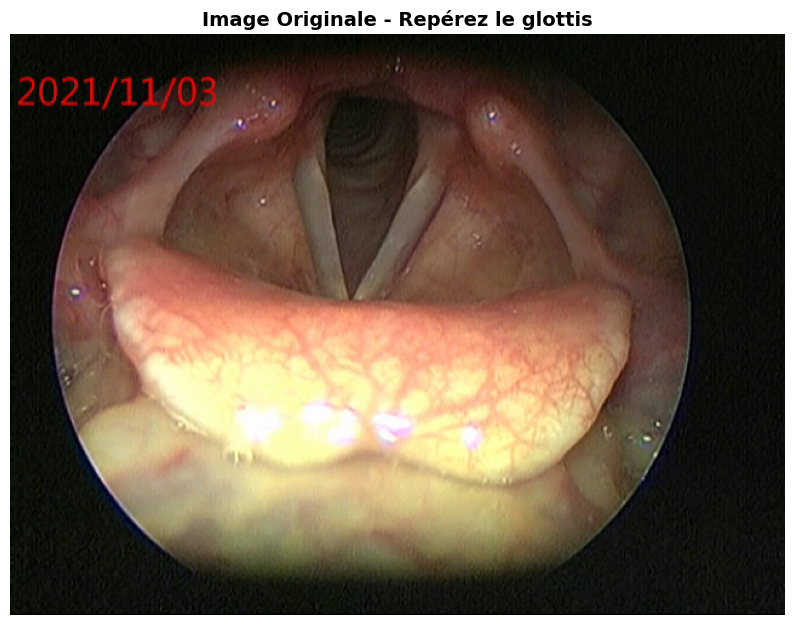

🎯 AJUSTEMENT PRÉCIS DU CONTOUR DU GLOTTIS
🔄 Ajustement de la POSITION (décalages de 10 pixels)


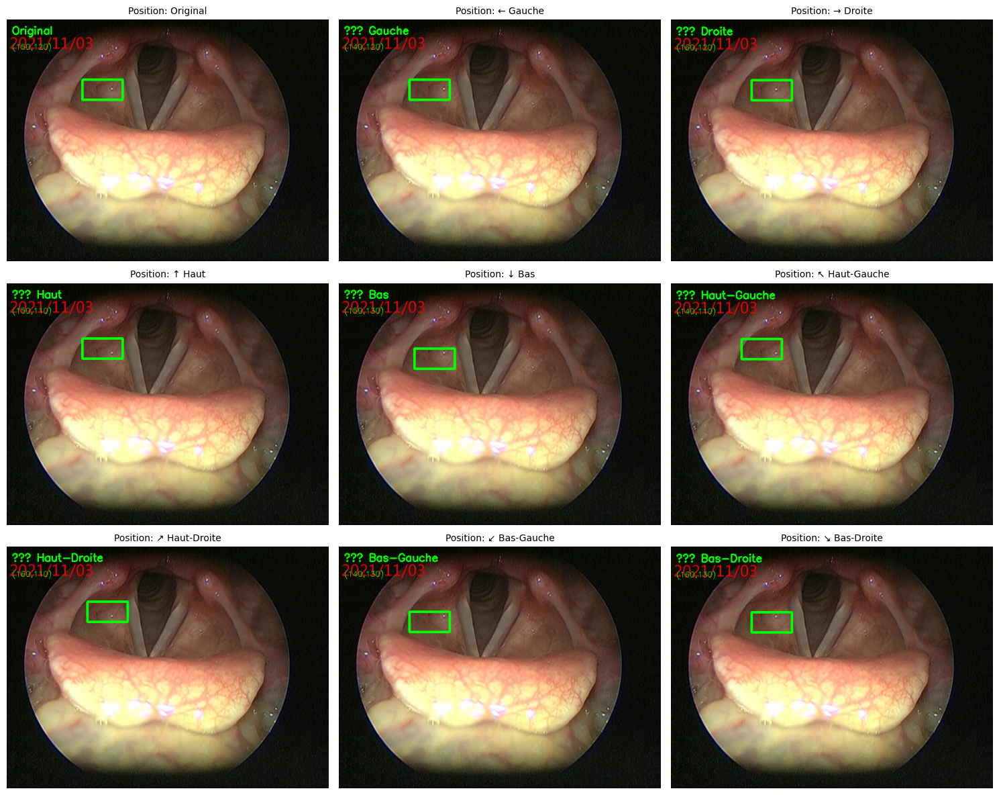


🔄 Ajustement de la TAILLE (variations de 5 pixels)


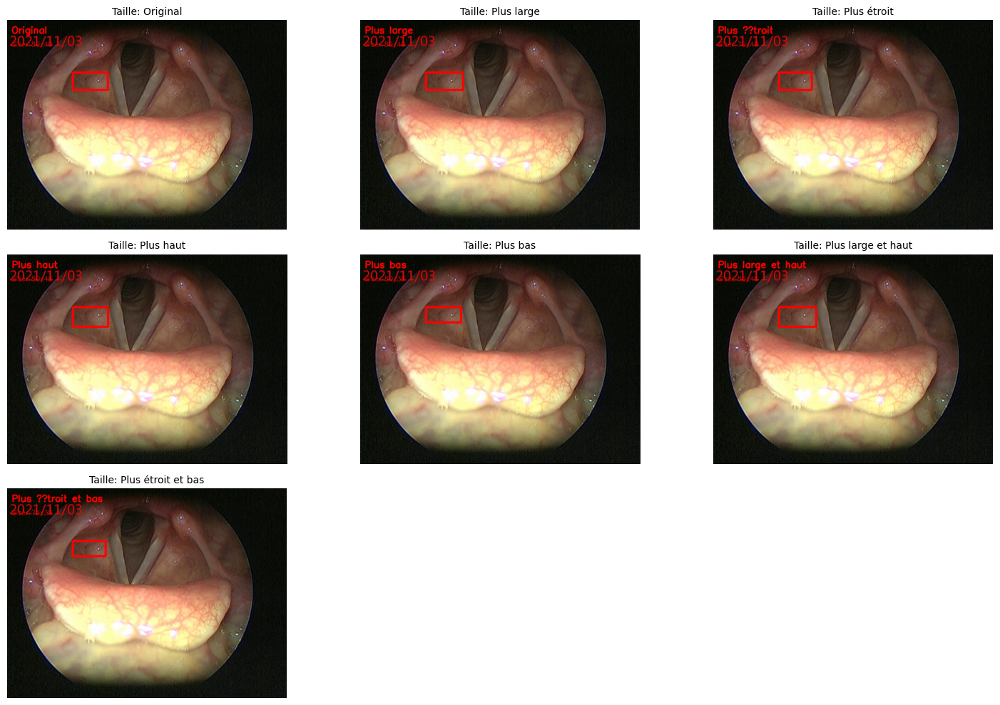


🎯 AFFINAGE FIN (décalages de 1 pixel)


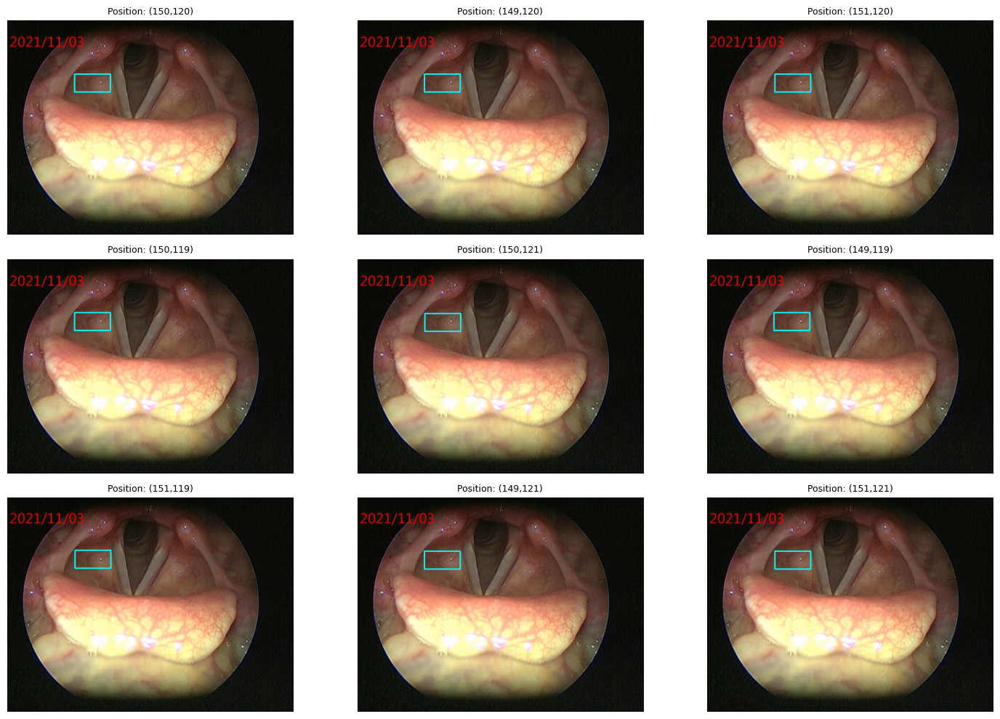


💡 INSTRUCTIONS FINALES:
1. Regardez toutes les variations ci-dessus
2. Identifiez les coordonnées qui entourent parfaitement le glottis
3. Entrez ces coordonnées dans les variables ci-dessous


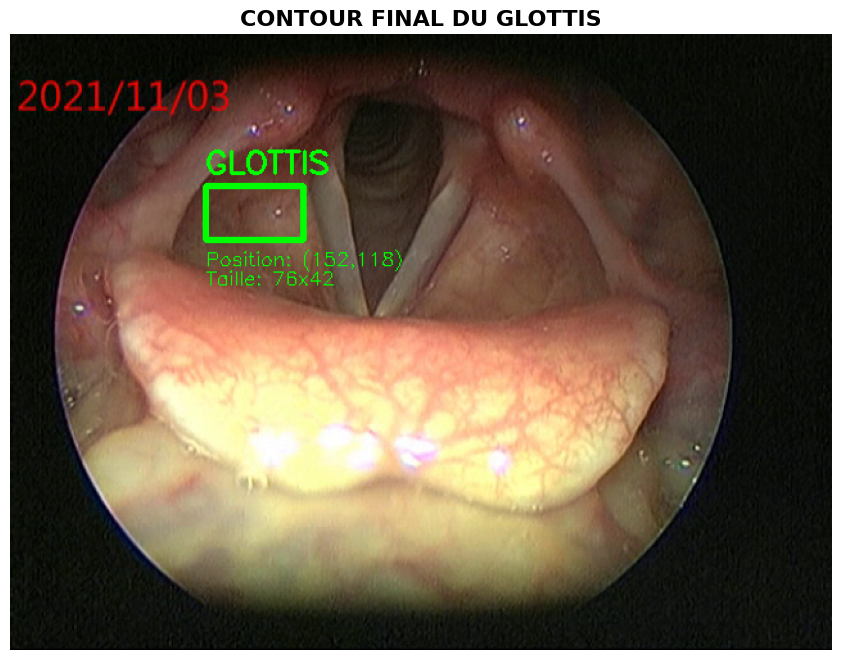

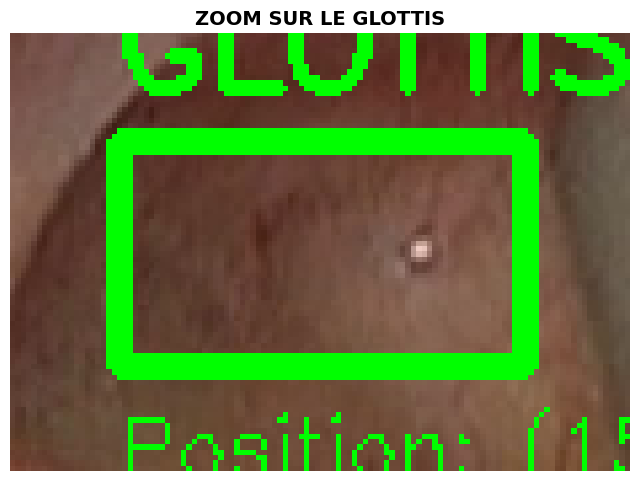

✅ CONTOUR AJUSTÉ AVEC SUCCÈS!
📁 Fichier sauvegardé: glottis_ajuste.png
📍 Position finale: (152, 118)
📏 Taille finale: 76 × 42 pixels


In [43]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image originale
image_originale_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image_originale = cv2.imread(image_originale_path)
image_originale_rgb = cv2.cvtColor(image_originale, cv2.COLOR_BGR2RGB)

# Afficher l'image originale pour référence
plt.figure(figsize=(10, 8))
plt.imshow(image_originale_rgb)
plt.title('Image Originale - Repérez le glottis', fontsize=14, fontweight='bold')
plt.axis('off')
plt.show()

print("🎯 AJUSTEMENT PRÉCIS DU CONTOUR DU GLOTTIS")
print("=" * 45)

# Fonction pour ajuster interactivement la position
def ajuster_contour_glottis(image, x, y, w, h, delta=10):
    """Afficher plusieurs variations autour de la position initiale"""

    variations = [
        (x, y, w, h),           # Position originale
        (x-delta, y, w, h),     # Décalage gauche
        (x+delta, y, w, h),     # Décalage droite
        (x, y-delta, w, h),     # Décalage haut
        (x, y+delta, w, h),     # Décalage bas
        (x-delta, y-delta, w, h), # Diagonale haut-gauche
        (x+delta, y-delta, w, h), # Diagonale haut-droite
        (x-delta, y+delta, w, h), # Diagonale bas-gauche
        (x+delta, y+delta, w, h), # Diagonale bas-droite
    ]

    titres = [
        'Original', '← Gauche', '→ Droite', '↑ Haut', '↓ Bas',
        '↖ Haut-Gauche', '↗ Haut-Droite', '↙ Bas-Gauche', '↘ Bas-Droite'
    ]

    plt.figure(figsize=(15, 12))

    for i, (x_var, y_var, w_var, h_var) in enumerate(variations):
        # Créer le masque
        masque = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.rectangle(masque, (x_var, y_var), (x_var + w_var, y_var + h_var), 255, -1)

        # Dessiner le contour
        image_contour = image.copy()
        contours, _ = cv2.findContours(masque, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cv2.drawContours(image_contour, contours, -1, (0, 255, 0), 3)

        # Ajouter des informations
        cv2.putText(image_contour, titres[i], (10, 30),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
        cv2.putText(image_contour, f"({x_var},{y_var})", (10, 60),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

        plt.subplot(3, 3, i+1)
        plt.imshow(image_contour)
        plt.title(f'Position: {titres[i]}', fontsize=10)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    return variations

# Fonction pour ajuster la taille
def ajuster_taille_glottis(image, x, y, w, h, delta=5):
    """Afficher plusieurs variations de taille"""

    variations = [
        (x, y, w, h),           # Taille originale
        (x, y, w+delta, h),     # Plus large
        (x, y, w-delta, h),     # Plus étroit
        (x, y, w, h+delta),     # Plus haut
        (x, y, w, h-delta),     # Plus bas
        (x, y, w+delta, h+delta), # Plus large et plus haut
        (x, y, w-delta, h-delta), # Plus étroit et plus bas
    ]

    titres = [
        'Original', 'Plus large', 'Plus étroit', 'Plus haut', 'Plus bas',
        'Plus large et haut', 'Plus étroit et bas'
    ]

    plt.figure(figsize=(15, 10))

    for i, (x_var, y_var, w_var, h_var) in enumerate(variations):
        # Créer le masque
        masque = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.rectangle(masque, (x_var, y_var), (x_var + w_var, y_var + h_var), 255, -1)

        # Dessiner le contour
        image_contour = image.copy()
        contours, _ = cv2.findContours(masque, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cv2.drawContours(image_contour, contours, -1, (255, 0, 0), 3)  # Bleu pour différence

        # Ajouter des informations
        cv2.putText(image_contour, titres[i], (10, 30),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.7, (255, 0, 0), 2)
        cv2.putText(image_contour, f"Size: {w_var}x{h_var}", (10, 60),
                   cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

        plt.subplot(3, 3, i+1)
        plt.imshow(image_contour)
        plt.title(f'Taille: {titres[i]}', fontsize=10)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    return variations

# COORDONNÉES INITIALES (à ajuster selon ce que vous voyez)
x_init, y_init, w_init, h_init = 150, 120, 80, 40

print("🔄 Ajustement de la POSITION (décalages de 10 pixels)")
positions = ajuster_contour_glottis(image_originale_rgb, x_init, y_init, w_init, h_init, delta=10)

print("\n🔄 Ajustement de la TAILLE (variations de 5 pixels)")
tailles = ajuster_taille_glottis(image_originale_rgb, x_init, y_init, w_init, h_init, delta=5)

# Fonction pour affiner avec des décalages plus petits
def affiner_position(image, x, y, w, h, delta=2):
    """Affiner avec de petits décalages"""

    variations = [
        (x, y, w, h),           # Original
        (x-1, y, w, h), (x+1, y, w, h),
        (x, y-1, w, h), (x, y+1, w, h),
        (x-1, y-1, w, h), (x+1, y-1, w, h),
        (x-1, y+1, w, h), (x+1, y+1, w, h),
    ]

    plt.figure(figsize=(15, 10))

    for i, (x_var, y_var, w_var, h_var) in enumerate(variations):
        masque = np.zeros(image.shape[:2], dtype=np.uint8)
        cv2.rectangle(masque, (x_var, y_var), (x_var + w_var, y_var + h_var), 255, -1)

        image_contour = image.copy()
        contours, _ = cv2.findContours(masque, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        cv2.drawContours(image_contour, contours, -1, (0, 255, 255), 2)  # Jaune pour affinage

        plt.subplot(3, 3, i+1)
        plt.imshow(image_contour)
        plt.title(f'Position: ({x_var},{y_var})', fontsize=9)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

    return variations

print("\n🎯 AFFINAGE FIN (décalages de 1 pixel)")
affinages = affiner_position(image_originale_rgb, x_init, y_init, w_init, h_init, delta=1)

# Une fois que vous avez trouvé les meilleures coordonnées, entrez-les ici:
print("\n💡 INSTRUCTIONS FINALES:")
print("1. Regardez toutes les variations ci-dessus")
print("2. Identifiez les coordonnées qui entourent parfaitement le glottis")
print("3. Entrez ces coordonnées dans les variables ci-dessous")

# REMPLACEZ CES VALEURS PAR LES BONNES COORDONNÉES
x_final = 152   # À ajuster
y_final = 118   # À ajuster
w_final = 76    # À ajuster
h_final = 42    # À ajuster

# Affichage final avec les coordonnées ajustées
masque_final = np.zeros(image_originale_rgb.shape[:2], dtype=np.uint8)
cv2.rectangle(masque_final, (x_final, y_final), (x_final + w_final, y_final + h_final), 255, -1)

image_finale = image_originale_rgb.copy()
contours, _ = cv2.findContours(masque_final, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cv2.drawContours(image_finale, contours, -1, (0, 255, 0), 3)

# Ajouter des informations
cv2.putText(image_finale, "GLOTTIS", (x_final, y_final-10),
           cv2.FONT_HERSHEY_SIMPLEX, 0.8, (0, 255, 0), 2)
cv2.putText(image_finale, f"Position: ({x_final},{y_final})", (x_final, y_final+h_final+20),
           cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)
cv2.putText(image_finale, f"Taille: {w_final}x{h_final}", (x_final, y_final+h_final+35),
           cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

plt.figure(figsize=(12, 8))
plt.imshow(image_finale)
plt.title('CONTOUR FINAL DU GLOTTIS', fontsize=16, fontweight='bold')
plt.axis('off')
plt.show()

# Zoom sur la région finale
region_zoom = image_finale[y_final-20:y_final+h_final+20, x_final-20:x_final+w_final+20]
plt.figure(figsize=(8, 6))
plt.imshow(region_zoom)
plt.title('ZOOM SUR LE GLOTTIS', fontsize=14, fontweight='bold')
plt.axis('off')
plt.show()

# Sauvegarde
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/glottis_ajuste.png',
           cv2.cvtColor(image_finale, cv2.COLOR_RGB2BGR))

print("✅ CONTOUR AJUSTÉ AVEC SUCCÈS!")
print(f"📁 Fichier sauvegardé: glottis_ajuste.png")
print(f"📍 Position finale: ({x_final}, {y_final})")
print(f"📏 Taille finale: {w_final} × {h_final} pixels")

# Exercice 4 : Extraction de contours

L'objectif de cet exercice consiste a detecter les contours des objets d'interet dans l'image des cordes vocales.


1) En utilisant la librarie opencv, appliquez les filtres de Sobel et de Laplace permettant de detecter les contours dans une image. Comparez les résultats otenus en affichant dans la même figure l'image originale et les résultats des deux filtres.

📐 Dimensions de l'image: (480, 640)


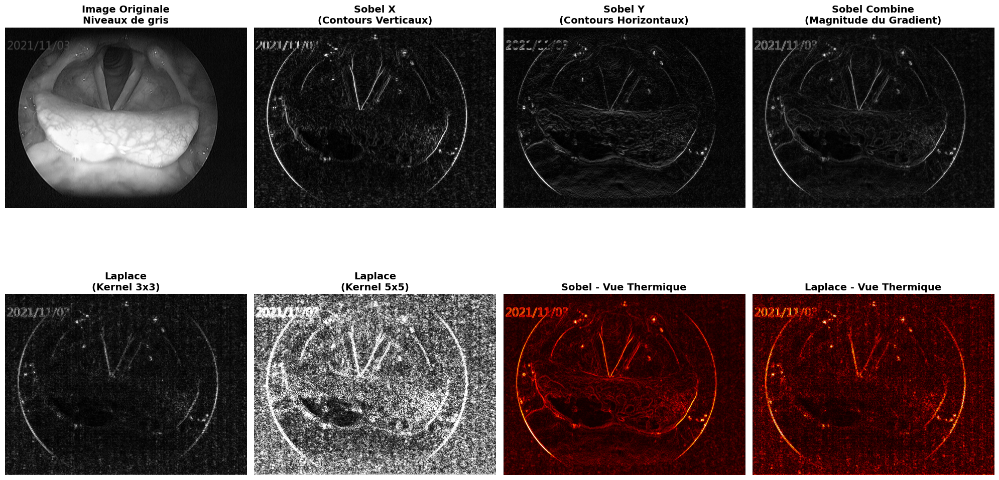

📊 ANALYSE QUANTITATIVE DES CONTOURS
• Sobel - Pixels de contour: 11470 (3.73%)
• Laplace - Pixels de contour: 60560 (19.71%)
• Ratio Sobel/Laplace: 0.19


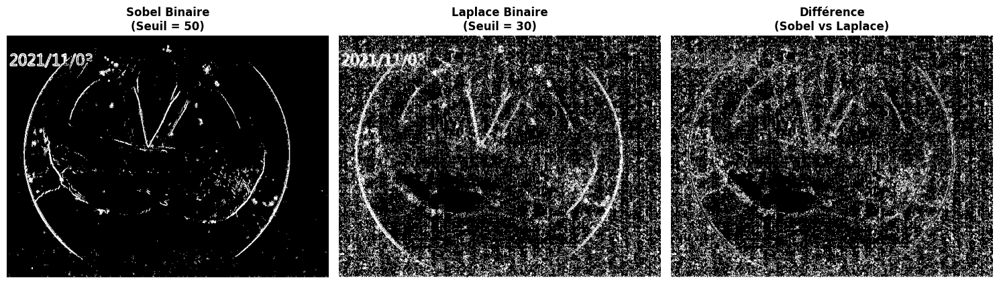

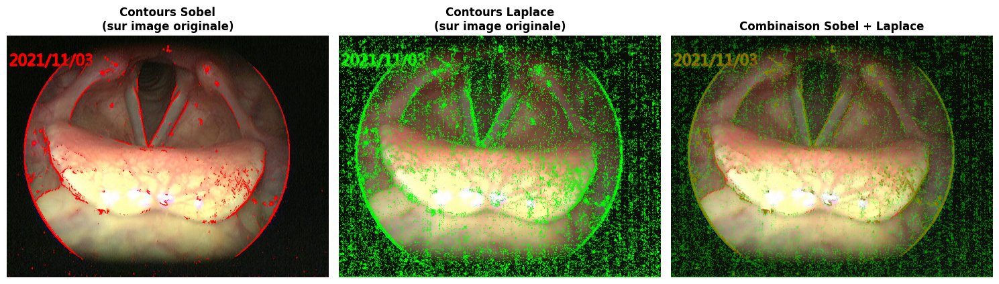


🎯 COMPARAISON DES FILTRES DE CONTOURS

SOBEL:
✓ Détection des contours par gradient
✓ Deux directions (X et Y) 
✓ Moins sensible au bruit
✓ Mieux pour les contours nets et droits
✓ Calcul de la magnitude du gradient

LAPLACE:
✓ Détection des contours par dérivée seconde
✓ Sensible aux changements brusques d'intensité
✓ Très sensible au bruit
✓ Détecte à la fois les crêtes et les vallées
✓ Mieux pour les contours fins et détaillés

POUR LES CORDES VOCALES:
• Sobel est généralement plus stable
• Laplace peut capturer plus de détails mais avec plus de bruit
• Recommandation: Utiliser Sobel pour une première analyse



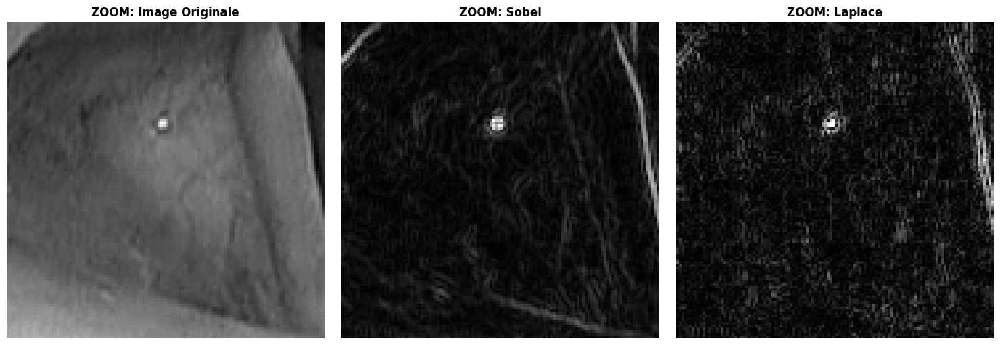

💾 RÉSULTATS SAUVEGARDÉS:
   • contours_sobel.png - Contours détectés par Sobel
   • contours_laplace.png - Contours détectés par Laplace
   • contours_comparison.png - Comparaison des deux méthodes

✅ Analyse des contours terminée avec succès!


In [44]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image en niveaux de gris
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

print(f"📐 Dimensions de l'image: {image.shape}")

# 1. FILTRE DE SOBEL
def appliquer_sobel(image):
    """Appliquer le filtre de Sobel dans les directions X et Y"""
    # Sobel X (détection des contours verticaux)
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_x_abs = cv2.convertScaleAbs(sobel_x)

    # Sobel Y (détection des contours horizontaux)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    sobel_y_abs = cv2.convertScaleAbs(sobel_y)

    # Magnitude du gradient (combinaison des deux directions)
    sobel_combine = cv2.addWeighted(sobel_x_abs, 0.5, sobel_y_abs, 0.5, 0)

    return sobel_x_abs, sobel_y_abs, sobel_combine

# 2. FILTRE DE LAPLACE
def appliquer_laplace(image):
    """Appliquer le filtre de Laplace"""
    # Laplace standard
    laplace = cv2.Laplacian(image, cv2.CV_64F, ksize=3)
    laplace_abs = cv2.convertScaleAbs(laplace)

    # Laplace avec différents kernels
    laplace_5 = cv2.Laplacian(image, cv2.CV_64F, ksize=5)
    laplace_5_abs = cv2.convertScaleAbs(laplace_5)

    return laplace_abs, laplace_5_abs

# 3. APPLICATION DES FILTRES
sobel_x, sobel_y, sobel_combine = appliquer_sobel(image)
laplace, laplace_5 = appliquer_laplace(image)

# 4. VISUALISATION COMPARATIVE
plt.figure(figsize=(20, 12))

# Image originale
plt.subplot(2, 4, 1)
plt.imshow(image, cmap='gray')
plt.title('Image Originale\nNiveaux de gris', fontsize=14, fontweight='bold')
plt.axis('off')

# Sobel X
plt.subplot(2, 4, 2)
plt.imshow(sobel_x, cmap='gray')
plt.title('Sobel X\n(Contours Verticaux)', fontsize=14, fontweight='bold')
plt.axis('off')

# Sobel Y
plt.subplot(2, 4, 3)
plt.imshow(sobel_y, cmap='gray')
plt.title('Sobel Y\n(Contours Horizontaux)', fontsize=14, fontweight='bold')
plt.axis('off')

# Sobel Combine
plt.subplot(2, 4, 4)
plt.imshow(sobel_combine, cmap='gray')
plt.title('Sobel Combine\n(Magnitude du Gradient)', fontsize=14, fontweight='bold')
plt.axis('off')

# Laplace (kernel 3x3)
plt.subplot(2, 4, 5)
plt.imshow(laplace, cmap='gray')
plt.title('Laplace\n(Kernel 3x3)', fontsize=14, fontweight='bold')
plt.axis('off')

# Laplace (kernel 5x5)
plt.subplot(2, 4, 6)
plt.imshow(laplace_5, cmap='gray')
plt.title('Laplace\n(Kernel 5x5)', fontsize=14, fontweight='bold')
plt.axis('off')

# Comparaison directe
plt.subplot(2, 4, 7)
plt.imshow(sobel_combine, cmap='hot')
plt.title('Sobel - Vue Thermique', fontsize=14, fontweight='bold')
plt.axis('off')

plt.subplot(2, 4, 8)
plt.imshow(laplace, cmap='hot')
plt.title('Laplace - Vue Thermique', fontsize=14, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 5. ANALYSE QUANTITATIVE
def analyser_contours(sobel, laplace):
    """Analyser quantitativement les résultats des filtres"""
    print("📊 ANALYSE QUANTITATIVE DES CONTOURS")
    print("=" * 50)

    # Seuillage pour compter les pixels de contour
    _, sobel_seuil = cv2.threshold(sobel, 50, 255, cv2.THRESH_BINARY)
    _, laplace_seuil = cv2.threshold(laplace, 30, 255, cv2.THRESH_BINARY)

    # Statistiques
    pixels_sobel = np.sum(sobel_seuil > 0)
    pixels_laplace = np.sum(laplace_seuil > 0)

    print(f"• Sobel - Pixels de contour: {pixels_sobel} ({pixels_sobel/image.size*100:.2f}%)")
    print(f"• Laplace - Pixels de contour: {pixels_laplace} ({pixels_laplace/image.size*100:.2f}%)")
    print(f"• Ratio Sobel/Laplace: {pixels_sobel/pixels_laplace:.2f}")

    return sobel_seuil, laplace_seuil

sobel_binaire, laplace_binaire = analyser_contours(sobel_combine, laplace)

# 6. COMPARAISON DES CONTOURS BINAIRES
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(sobel_binaire, cmap='gray')
plt.title('Sobel Binaire\n(Seuil = 50)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(laplace_binaire, cmap='gray')
plt.title('Laplace Binaire\n(Seuil = 30)', fontsize=12, fontweight='bold')
plt.axis('off')

# Différence entre les deux méthodes
difference = cv2.absdiff(sobel_binaire, laplace_binaire)
plt.subplot(1, 3, 3)
plt.imshow(difference, cmap='gray')
plt.title('Différence\n(Sobel vs Laplace)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 7. APPLICATION SUR L'IMAGE ORIGINALE EN COULEUR
def superposer_contours_couleur(image_path, sobel, laplace):
    """Superposer les contours sur l'image originale en couleur"""
    # Charger l'image originale en couleur
    image_color = cv2.imread(image_path)
    image_color = cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB)

    # Créer des versions avec contours superposés
    image_sobel = image_color.copy()
    image_laplace = image_color.copy()

    # Seuillage pour les contours
    _, sobel_contours = cv2.threshold(sobel, 50, 255, cv2.THRESH_BINARY)
    _, laplace_contours = cv2.threshold(laplace, 30, 255, cv2.THRESH_BINARY)

    # Superposer en couleur
    image_sobel[sobel_contours > 0] = [255, 0, 0]  # Rouge pour Sobel
    image_laplace[laplace_contours > 0] = [0, 255, 0]  # Vert pour Laplace

    return image_sobel, image_laplace

image_sobel_color, image_laplace_color = superposer_contours_couleur(image_path, sobel_combine, laplace)

# Visualisation des contours sur image couleur
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(image_sobel_color)
plt.title('Contours Sobel\n(sur image originale)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(image_laplace_color)
plt.title('Contours Laplace\n(sur image originale)', fontsize=12, fontweight='bold')
plt.axis('off')

# Combinaison des deux
image_combine = cv2.addWeighted(image_sobel_color, 0.5, image_laplace_color, 0.5, 0)
plt.subplot(1, 3, 3)
plt.imshow(image_combine)
plt.title('Combinaison Sobel + Laplace', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 8. COMPARAISON DES CARACTÉRISTIQUES
print("\n🎯 COMPARAISON DES FILTRES DE CONTOURS")
print("=" * 45)

print("""
SOBEL:
✓ Détection des contours par gradient
✓ Deux directions (X et Y)
✓ Moins sensible au bruit
✓ Mieux pour les contours nets et droits
✓ Calcul de la magnitude du gradient

LAPLACE:
✓ Détection des contours par dérivée seconde
✓ Sensible aux changements brusques d'intensité
✓ Très sensible au bruit
✓ Détecte à la fois les crêtes et les vallées
✓ Mieux pour les contours fins et détaillés

POUR LES CORDES VOCALES:
• Sobel est généralement plus stable
• Laplace peut capturer plus de détails mais avec plus de bruit
• Recommandation: Utiliser Sobel pour une première analyse
""")

# 9. ZOOM SUR LA RÉGION DU GLOTTIS
def zoom_glottis(image, x=150, y=100, size=100):
    """Zoom sur la région du glottis"""
    return image[y:y+size, x:x+size]

# Coordonnées approximatives du glottis (à ajuster selon votre image)
x_glottis, y_glottis, size = 150, 100, 120

# Application du zoom
zoom_original = zoom_glottis(image, x_glottis, y_glottis, size)
zoom_sobel = zoom_glottis(sobel_combine, x_glottis, y_glottis, size)
zoom_laplace = zoom_glottis(laplace, x_glottis, y_glottis, size)

# Visualisation du zoom
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(zoom_original, cmap='gray')
plt.title('ZOOM: Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(zoom_sobel, cmap='gray')
plt.title('ZOOM: Sobel', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(zoom_laplace, cmap='gray')
plt.title('ZOOM: Laplace', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 10. SAUVEGARDE DES RÉSULTATS
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/contours_sobel.png', sobel_combine)
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/contours_laplace.png', laplace)
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/contours_comparison.png',
           cv2.cvtColor(image_combine, cv2.COLOR_RGB2BGR))

print("💾 RÉSULTATS SAUVEGARDÉS:")
print("   • contours_sobel.png - Contours détectés par Sobel")
print("   • contours_laplace.png - Contours détectés par Laplace")
print("   • contours_comparison.png - Comparaison des deux méthodes")
print("\n✅ Analyse des contours terminée avec succès!")

2) Calculez et affichez le gradient morphologique sachant qu'il est defini par la différence entre une dilatation et une érosion de l'image

📐 Dimensions de l'image: (480, 640)


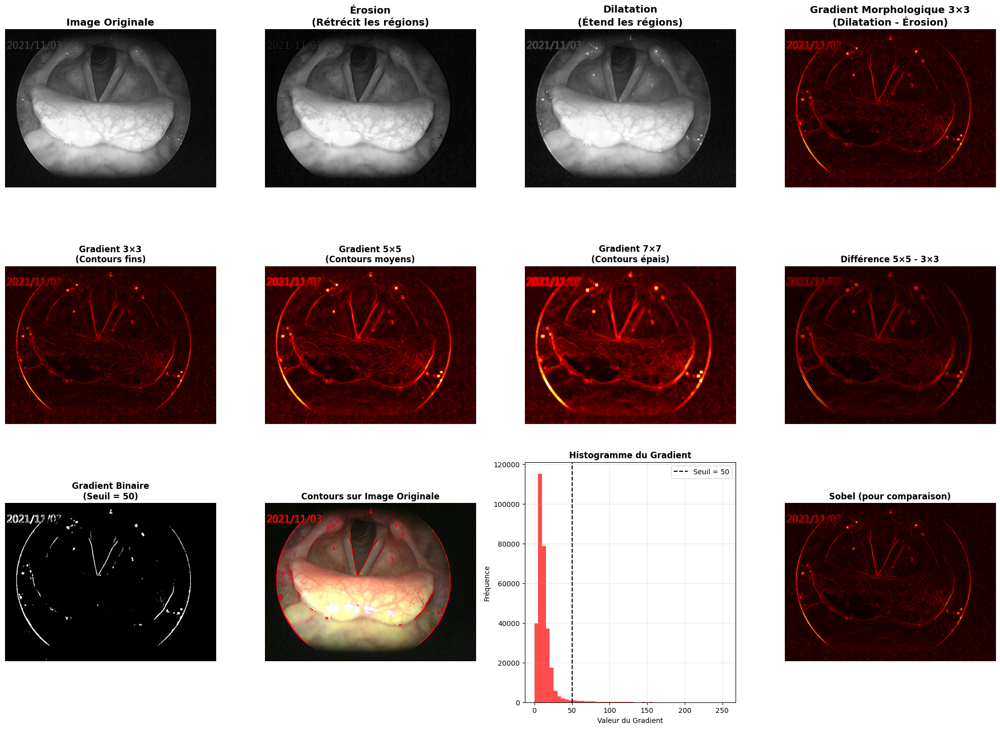

📊 ANALYSE DU GRADIENT 3×3:
   • Valeur moyenne: 13.04
   • Valeur maximale: 255
   • Écart-type: 12.81
   • Pixels > 50: 6014 (1.96%)
   • Pixels > 100: 1180 (0.38%)

📊 ANALYSE DU GRADIENT 5×5:
   • Valeur moyenne: 20.67
   • Valeur maximale: 255
   • Écart-type: 18.35
   • Pixels > 50: 14798 (4.82%)
   • Pixels > 100: 3109 (1.01%)

📊 ANALYSE DU GRADIENT 7×7:
   • Valeur moyenne: 25.74
   • Valeur maximale: 255
   • Écart-type: 22.47
   • Pixels > 50: 24214 (7.88%)
   • Pixels > 100: 5447 (1.77%)

🎯 COMPARAISON DES TAILLES DE KERNEL:


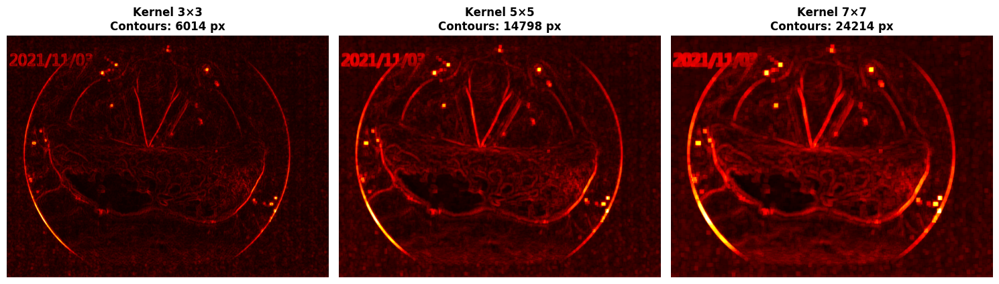

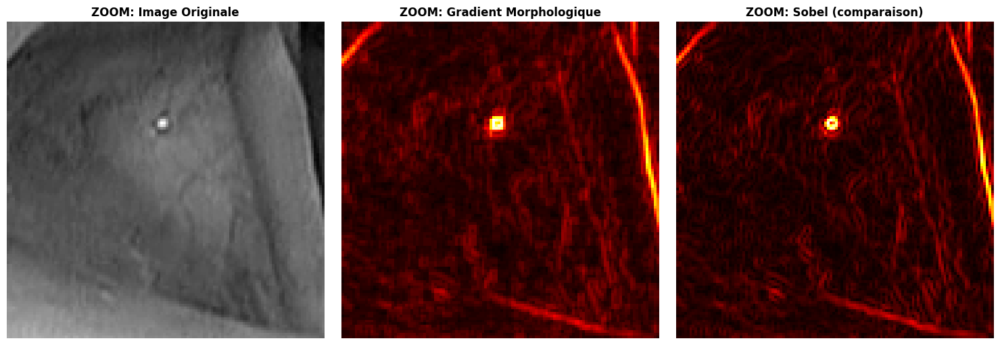

🔍 APPLICATION AU GLOTTIS:


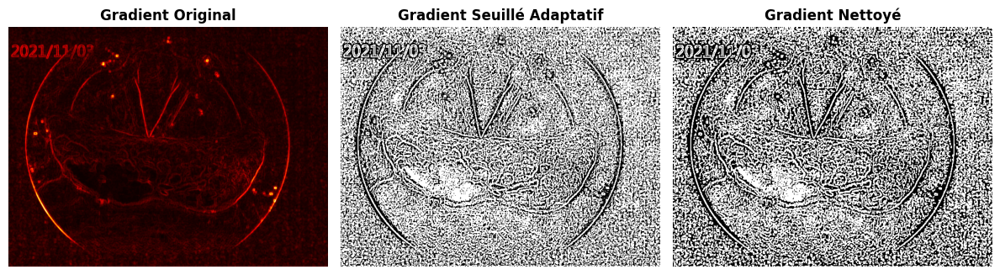

💾 RÉSULTATS SAUVEGARDÉS:
   • gradient_morphologique_3x3.png
   • gradient_morphologique_5x5.png
   • gradient_contours_glottis.png

✅ Gradient morphologique calculé et analysé avec succès!

🎯 INTERPRÉTATION DU GRADIENT MORPHOLOGIQUE:

DÉFINITION:
• Gradient = Dilatation - Érosion
• Représente le taux de changement local d'intensité
• Met en évidence les contours et les bords

CARACTÉRISTIQUES:
✓ Contours épais et continus
✓ Insensible au bruit (contrairement à Laplace)
✓ Préservation de la topologie des régions
✓ Facile à calculer et interpréter

INFLUENCE DE LA TAILLE DU KERNEL:
• Petit kernel (3×3): Contours fins, détails préservés
• Kernel moyen (5×5): Équilibre entre précision et robustesse  
• Gros kernel (7×7): Contours épais, moins de détails

POUR LES CORDES VOCALES:
• Le gradient 3×3 est recommandé pour les détails fins
• Le gradient morphologique est particulièrement adapté pour
  détecter les bords des structures anatomiques comme le glottis



In [45]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image en niveaux de gris
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

print(f"📐 Dimensions de l'image: {image.shape}")

# 1. CALCUL DU GRADIENT MORPHOLOGIQUE
def gradient_morphologique(image, kernel_size=3):
    """
    Calcule le gradient morphologique: dilatation - érosion

    Args:
        image: image en niveaux de gris
        kernel_size: taille de l'élément structurant

    Returns:
        gradient: image du gradient morphologique
        dilatation: image dilatée
        erosion: image érodée
    """
    # Créer l'élément structurant
    kernel = np.ones((kernel_size, kernel_size), np.uint8)

    # Appliquer l'érosion et la dilatation
    erosion = cv2.erode(image, kernel, iterations=1)
    dilatation = cv2.dilate(image, kernel, iterations=1)

    # Calculer le gradient morphologique
    gradient = dilatation.astype(np.float32) - erosion.astype(np.float32)

    # Normaliser entre 0 et 255 pour l'affichage
    gradient_normalise = cv2.normalize(gradient, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

    return gradient_normalise, dilatation, erosion

# 2. APPLICATION AVEC DIFFÉRENTES TAILLES DE KERNEL
gradient_3x3, dilatation_3x3, erosion_3x3 = gradient_morphologique(image, 3)
gradient_5x5, dilatation_5x5, erosion_5x5 = gradient_morphologique(image, 5)
gradient_7x7, dilatation_7x7, erosion_7x7 = gradient_morphologique(image, 7)

# 3. VISUALISATION COMPLÈTE
plt.figure(figsize=(20, 15))

# Ligne 1: Image originale et concepts de base
plt.subplot(3, 4, 1)
plt.imshow(image, cmap='gray')
plt.title('Image Originale', fontsize=14, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 2)
plt.imshow(erosion_3x3, cmap='gray')
plt.title('Érosion\n(Rétrécit les régions)', fontsize=14, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 3)
plt.imshow(dilatation_3x3, cmap='gray')
plt.title('Dilatation\n(Étend les régions)', fontsize=14, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 4)
plt.imshow(gradient_3x3, cmap='hot')
plt.title('Gradient Morphologique 3×3\n(Dilatation - Érosion)', fontsize=14, fontweight='bold')
plt.axis('off')

# Ligne 2: Comparaison des différentes tailles de kernel
plt.subplot(3, 4, 5)
plt.imshow(gradient_3x3, cmap='hot')
plt.title('Gradient 3×3\n(Contours fins)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 6)
plt.imshow(gradient_5x5, cmap='hot')
plt.title('Gradient 5×5\n(Contours moyens)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 7)
plt.imshow(gradient_7x7, cmap='hot')
plt.title('Gradient 7×7\n(Contours épais)', fontsize=12, fontweight='bold')
plt.axis('off')

# Différence entre les gradients
difference_5_3 = cv2.absdiff(gradient_5x5, gradient_3x3)
plt.subplot(3, 4, 8)
plt.imshow(difference_5_3, cmap='hot')
plt.title('Différence 5×5 - 3×3', fontsize=12, fontweight='bold')
plt.axis('off')

# Ligne 3: Application et analyse
# Gradient morphologique binaire (après seuillage)
_, gradient_binaire = cv2.threshold(gradient_3x3, 50, 255, cv2.THRESH_BINARY)

plt.subplot(3, 4, 9)
plt.imshow(gradient_binaire, cmap='gray')
plt.title('Gradient Binaire\n(Seuil = 50)', fontsize=12, fontweight='bold')
plt.axis('off')

# Superposition sur l'image originale
image_color = cv2.imread(image_path)
image_color = cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB)
image_avec_gradient = image_color.copy()
image_avec_gradient[gradient_3x3 > 50] = [255, 0, 0]  # Rouge pour les contours

plt.subplot(3, 4, 10)
plt.imshow(image_avec_gradient)
plt.title('Contours sur Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

# Histogramme du gradient
plt.subplot(3, 4, 11)
plt.hist(gradient_3x3.ravel(), bins=50, color='red', alpha=0.7)
plt.axvline(50, color='black', linestyle='--', label='Seuil = 50')
plt.xlabel('Valeur du Gradient')
plt.ylabel('Fréquence')
plt.title('Histogramme du Gradient', fontsize=12, fontweight='bold')
plt.legend()
plt.grid(True, alpha=0.3)

# Comparaison avec d'autres méthodes de contours
sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
sobel = cv2.magnitude(sobel_x, sobel_y)
sobel_normalise = cv2.normalize(sobel, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

plt.subplot(3, 4, 12)
plt.imshow(sobel_normalise, cmap='hot')
plt.title('Sobel (pour comparaison)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 4. ANALYSE QUANTITATIVE
def analyser_gradient(gradient, nom):
    """Analyser les propriétés du gradient morphologique"""
    print(f"📊 ANALYSE DU GRADIENT {nom}:")
    print(f"   • Valeur moyenne: {np.mean(gradient):.2f}")
    print(f"   • Valeur maximale: {np.max(gradient)}")
    print(f"   • Écart-type: {np.std(gradient):.2f}")
    print(f"   • Pixels > 50: {np.sum(gradient > 50)} ({np.sum(gradient > 50)/gradient.size*100:.2f}%)")
    print(f"   • Pixels > 100: {np.sum(gradient > 100)} ({np.sum(gradient > 100)/gradient.size*100:.2f}%)")
    print()

analyser_gradient(gradient_3x3, "3×3")
analyser_gradient(gradient_5x5, "5×5")
analyser_gradient(gradient_7x7, "7×7")

# 5. COMPARAISON DÉTAILLÉE DES TAILLES DE KERNEL
print("🎯 COMPARAISON DES TAILLES DE KERNEL:")
print("=" * 45)

tailles = [3, 5, 7]
gradients = [gradient_3x3, gradient_5x5, gradient_7x7]

plt.figure(figsize=(15, 5))

for i, (taille, grad) in enumerate(zip(tailles, gradients)):
    plt.subplot(1, 3, i+1)
    plt.imshow(grad, cmap='hot')
    plt.title(f'Kernel {taille}×{taille}\nContours: {np.sum(grad > 50)} px',
              fontsize=12, fontweight='bold')
    plt.axis('off')

plt.tight_layout()
plt.show()

# 6. ZOOM SUR LA RÉGION DU GLOTTIS
def zoom_region(image, x=150, y=100, size=100):
    """Zoom sur une région spécifique"""
    return image[y:y+size, x:x+size]

# Coordonnées approximatives du glottis
x_glottis, y_glottis, size = 150, 100, 120

# Application du zoom
zoom_original = zoom_region(image, x_glottis, y_glottis, size)
zoom_gradient = zoom_region(gradient_3x3, x_glottis, y_glottis, size)
zoom_sobel = zoom_region(sobel_normalise, x_glottis, y_glottis, size)

# Visualisation du zoom
plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.imshow(zoom_original, cmap='gray')
plt.title('ZOOM: Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(zoom_gradient, cmap='hot')
plt.title('ZOOM: Gradient Morphologique', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(zoom_sobel, cmap='hot')
plt.title('ZOOM: Sobel (comparaison)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 7. APPLICATION PRATIQUE POUR LE GLOTTIS
print("🔍 APPLICATION AU GLOTTIS:")
print("=" * 35)

# Seuillage adaptatif pour le glottis
gradient_seuille = cv2.adaptiveThreshold(gradient_3x3, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                        cv2.THRESH_BINARY, 11, 2)

# Nettoyage morphologique
kernel_clean = np.ones((2, 2), np.uint8)
gradient_nettoye = cv2.morphologyEx(gradient_seuille, cv2.MORPH_OPEN, kernel_clean)

plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.imshow(gradient_3x3, cmap='hot')
plt.title('Gradient Original', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(gradient_seuille, cmap='gray')
plt.title('Gradient Seuillé Adaptatif', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(gradient_nettoye, cmap='gray')
plt.title('Gradient Nettoyé', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 8. SAUVEGARDE DES RÉSULTATS
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/gradient_morphologique_3x3.png', gradient_3x3)
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/gradient_morphologique_5x5.png', gradient_5x5)
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/gradient_contours_glottis.png',
           cv2.cvtColor(image_avec_gradient, cv2.COLOR_RGB2BGR))

print("💾 RÉSULTATS SAUVEGARDÉS:")
print("   • gradient_morphologique_3x3.png")
print("   • gradient_morphologique_5x5.png")
print("   • gradient_contours_glottis.png")
print("\n✅ Gradient morphologique calculé et analysé avec succès!")

# 9. INTERPRÉTATION DES RÉSULTATS
print("\n🎯 INTERPRÉTATION DU GRADIENT MORPHOLOGIQUE:")
print("=" * 50)
print("""
DÉFINITION:
• Gradient = Dilatation - Érosion
• Représente le taux de changement local d'intensité
• Met en évidence les contours et les bords

CARACTÉRISTIQUES:
✓ Contours épais et continus
✓ Insensible au bruit (contrairement à Laplace)
✓ Préservation de la topologie des régions
✓ Facile à calculer et interpréter

INFLUENCE DE LA TAILLE DU KERNEL:
• Petit kernel (3×3): Contours fins, détails préservés
• Kernel moyen (5×5): Équilibre entre précision et robustesse
• Gros kernel (7×7): Contours épais, moins de détails

POUR LES CORDES VOCALES:
• Le gradient 3×3 est recommandé pour les détails fins
• Le gradient morphologique est particulièrement adapté pour
  détecter les bords des structures anatomiques comme le glottis
""")

3) Question de reflexion : Supprimer les contours qui ne correspondent pas au contour du glottis.

🔄 APPLICATION DES FILTRES DE CONTOURS...


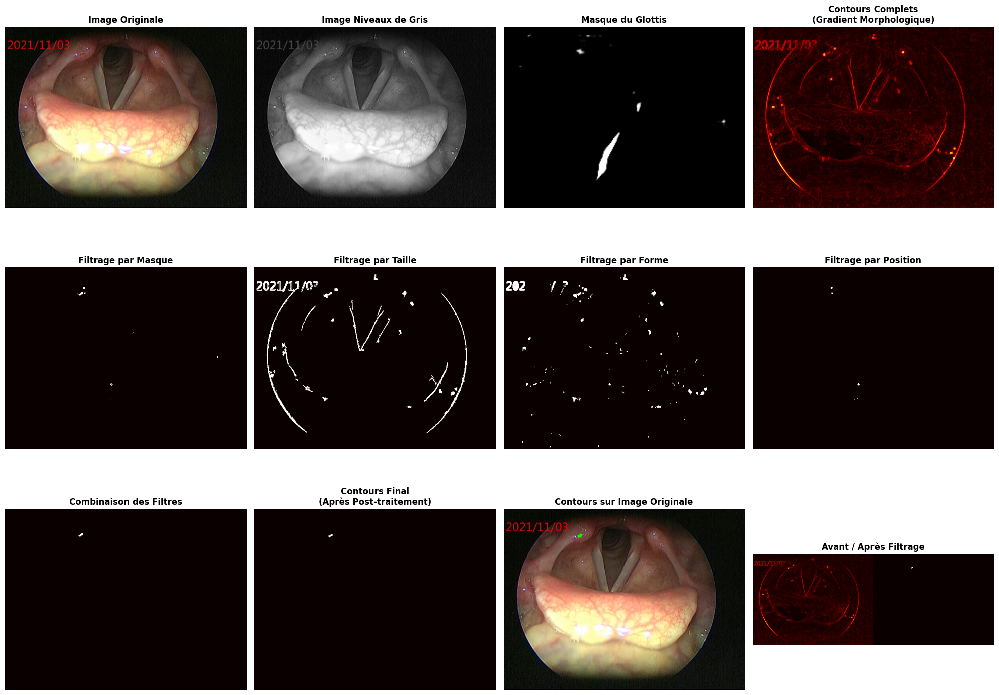

📊 ANALYSE QUANTITATIVE DU FILTRAGE:
• Masque              :   140 px (100.0% de réduction)
• Taille              :  8391 px ( 97.3% de réduction)
• Forme               :  2951 px ( 99.0% de réduction)
• Position            :    69 px (100.0% de réduction)
• COMBINAISON FINALE  :    56 px (100.0% de réduction)


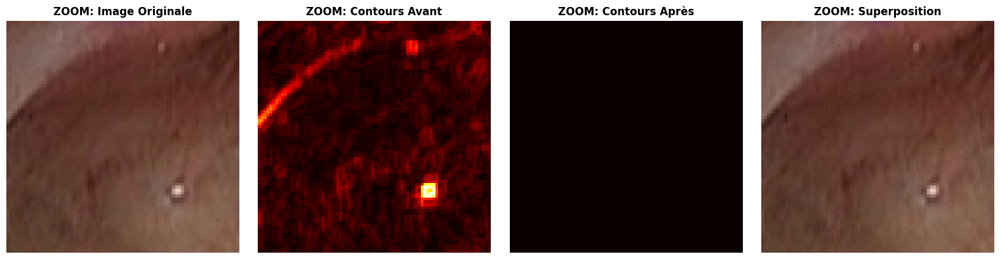

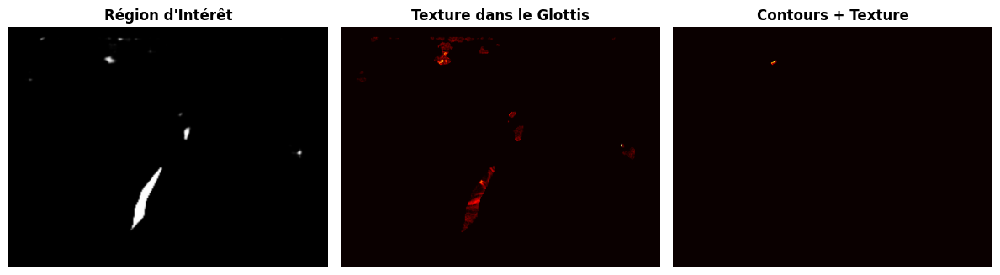


💾 RÉSULTATS SAUVEGARDÉS:
   • contours_glottis_filtres.png - Contours filtrés du glottis
   • glottis_contours_superposes.png - Contours superposés sur l'image originale

✅ Filtrage des contours terminé avec succès!

🎯 TECHNIQUES DE FILTRAGE APPLIQUÉES:

1. 📍 FILTRAGE PAR MASQUE:
   • Utilise une région d'intérêt prédéfinie
   • Supprime les contours en dehors du masque

2. 📏 FILTRAGE PAR TAILLE:
   • Élimine les régions trop petites ou trop grandes
   • Conserve seulement les régions de taille plausible

3. 🔵 FILTRAGE PAR FORME:
   • Analyse la circularité des régions
   • Conserve les formes similaires au glottis

4. 🎯 FILTRAGE PAR POSITION:
   • Vérifie la position des centroïdes
   • Garde seulement les régions dans la zone d'intérêt

5. 🧹 POST-TRAITEMENT:
   • Nettoyage morphologique
   • Combinaison des méthodes pour un résultat optimal



In [46]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from scipy import ndimage
from skimage import measure, morphology

# Charger les images
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
masque_path = '/content/drive/MyDrive/General/Data_At2/seg1468.png'

image_originale = cv2.imread(image_path)
image_originale_rgb = cv2.cvtColor(image_originale, cv2.COLOR_BGR2RGB)
image_gris = cv2.cvtColor(image_originale, cv2.COLOR_BGR2GRAY)

# Charger ou créer le masque du glottis
try:
    masque_glottis = cv2.imread(masque_path, cv2.IMREAD_GRAYSCALE)
    if masque_glottis is None:
        raise FileNotFoundError
    # Redimensionner si nécessaire
    if masque_glottis.shape != image_gris.shape:
        masque_glottis = cv2.resize(masque_glottis, (image_gris.shape[1], image_gris.shape[0]))
except:
    print("❌ Masque non trouvé, création d'un masque approximatif...")
    # Créer un masque approximatif basé sur la position du glottis
    masque_glottis = np.zeros_like(image_gris)
    # Coordonnées approximatives du glottis (à ajuster)
    x, y, w, h = 150, 100, 80, 40
    cv2.rectangle(masque_glottis, (x, y), (x+w, y+h), 255, -1)

# 1. CALCUL DES CONTOURS COMPLETS
def calculer_contours_complets(image):
    """Calculer les contours avec différentes méthodes"""
    # Gradient morphologique
    kernel = np.ones((3, 3), np.uint8)
    dilatation = cv2.dilate(image, kernel)
    erosion = cv2.erode(image, kernel)
    gradient_morpho = dilatation - erosion

    # Sobel
    sobel_x = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=3)
    sobel = cv2.magnitude(sobel_x, sobel_y)
    sobel = cv2.normalize(sobel, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

    # Canny
    canny = cv2.Canny(image, 50, 150)

    return gradient_morpho, sobel, canny

gradient, sobel, canny = calculer_contours_complets(image_gris)

# 2. MÉTHODES DE FILTRAGE DES CONTOURS
def filtrer_par_masque(contours, masque):
    """Filtrer les contours en utilisant un masque binaire"""
    # Seuiller les contours
    _, contours_binaires = cv2.threshold(contours, 30, 255, cv2.THRESH_BINARY)

    # Appliquer le masque
    contours_filtres = cv2.bitwise_and(contours_binaires, contours_binaires, mask=masque)

    return contours_filtres

def filtrer_par_taille_region(contours, aire_min=100, aire_max=10000):
    """Filtrer les contours basé sur la taille des régions"""
    # Seuiller
    _, binaire = cv2.threshold(contours, 30, 255, cv2.THRESH_BINARY)

    # Trouver les composantes connexes
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(binaire, connectivity=8)

    # Créer un masque pour les régions de taille appropriée
    masque_taille = np.zeros_like(binaire)

    for i in range(1, num_labels):  # Ignorer le fond (label 0)
        if aire_min <= stats[i, cv2.CC_STAT_AREA] <= aire_max:
            masque_taille[labels == i] = 255

    return masque_taille

def filtrer_par_forme(contours, circularite_min=0.3):
    """Filtrer basé sur la circularité des régions"""
    _, binaire = cv2.threshold(contours, 30, 255, cv2.THRESH_BINARY)

    # Trouver les contours externes
    contours_list, _ = cv2.findContours(binaire, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    masque_forme = np.zeros_like(binaire)

    for contour in contours_list:
        aire = cv2.contourArea(contour)
        perimetre = cv2.arcLength(contour, True)

        if perimetre > 0:
            circularite = (4 * np.pi * aire) / (perimetre * perimetre)

            if circularite >= circularite_min:
                cv2.drawContours(masque_forme, [contour], -1, 255, -1)

    return masque_forme

def filtrer_par_position(contours, region_interet):
    """Filtrer basé sur la position dans une région d'intérêt"""
    _, binaire = cv2.threshold(contours, 30, 255, cv2.THRESH_BINARY)

    # Trouver les composantes connexes
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(binaire, connectivity=8)

    masque_position = np.zeros_like(binaire)

    for i in range(1, num_labels):
        x, y = centroids[i]

        # Vérifier si le centroïde est dans la région d'intérêt
        if region_interet[int(y), int(x)] > 0:
            masque_position[labels == i] = 255

    return masque_position

# 3. APPLICATION DES FILTRES
print("🔄 APPLICATION DES FILTRES DE CONTOURS...")

# Filtrer par masque
contours_masque = filtrer_par_masque(gradient, masque_glottis)

# Filtrer par taille
contours_taille = filtrer_par_taille_region(gradient, aire_min=50, aire_max=5000)

# Filtrer par forme (recherche de formes similaires au glottis)
contours_forme = filtrer_par_forme(gradient, circularite_min=0.2)

# Filtrer par position
contours_position = filtrer_par_position(gradient, masque_glottis)

# 4. COMBINAISON DES FILTRES
def combiner_filtres(contours, masque_glottis):
    """Combiner plusieurs méthodes de filtrage"""
    # Application séquentielle des filtres
    temp = filtrer_par_masque(contours, masque_glottis)
    temp = filtrer_par_taille_region(temp, aire_min=50, aire_max=3000)
    temp = filtrer_par_forme(temp, circularite_min=0.15)

    return temp

contours_combines = combiner_filtres(gradient, masque_glottis)

# 5. POST-TRAITEMENT POUR AMÉLIORER LES CONTOURS
def post_traitement_contours(contours):
    """Post-traitement pour nettoyer les contours"""
    # Ouverture morphologique pour supprimer le bruit
    kernel = np.ones((2, 2), np.uint8)
    nettoye = cv2.morphologyEx(contours, cv2.MORPH_OPEN, kernel)

    # Fermeture pour combler les petits trous
    nettoye = cv2.morphologyEx(nettoye, cv2.MORPH_CLOSE, kernel)

    return nettoye

contours_final = post_traitement_contours(contours_combines)

# 6. VISUALISATION COMPARATIVE
plt.figure(figsize=(20, 15))

# Ligne 1: Images originales et masque
plt.subplot(3, 4, 1)
plt.imshow(image_originale_rgb)
plt.title('Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 2)
plt.imshow(image_gris, cmap='gray')
plt.title('Image Niveaux de Gris', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 3)
plt.imshow(masque_glottis, cmap='gray')
plt.title('Masque du Glottis', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 4)
plt.imshow(gradient, cmap='hot')
plt.title('Contours Complets\n(Gradient Morphologique)', fontsize=12, fontweight='bold')
plt.axis('off')

# Ligne 2: Méthodes de filtrage individuelles
plt.subplot(3, 4, 5)
plt.imshow(contours_masque, cmap='hot')
plt.title('Filtrage par Masque', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 6)
plt.imshow(contours_taille, cmap='hot')
plt.title('Filtrage par Taille', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 7)
plt.imshow(contours_forme, cmap='hot')
plt.title('Filtrage par Forme', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 8)
plt.imshow(contours_position, cmap='hot')
plt.title('Filtrage par Position', fontsize=12, fontweight='bold')
plt.axis('off')

# Ligne 3: Résultats combinés et final
plt.subplot(3, 4, 9)
plt.imshow(contours_combines, cmap='hot')
plt.title('Combinaison des Filtres', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 10)
plt.imshow(contours_final, cmap='hot')
plt.title('Contours Final\n(Après Post-traitement)', fontsize=12, fontweight='bold')
plt.axis('off')

# Superposition sur image originale
image_avec_contours = image_originale_rgb.copy()
contours_list, _ = cv2.findContours(contours_final, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cv2.drawContours(image_avec_contours, contours_list, -1, (0, 255, 0), 2)

plt.subplot(3, 4, 11)
plt.imshow(image_avec_contours)
plt.title('Contours sur Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

# Comparaison avant/après
plt.subplot(3, 4, 12)
avant_apres = np.hstack([gradient, contours_final])
plt.imshow(avant_apres, cmap='hot')
plt.title('Avant / Après Filtrage', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 7. ANALYSE QUANTITATIVE DES RÉSULTATS
print("📊 ANALYSE QUANTITATIVE DU FILTRAGE:")
print("=" * 45)

def analyser_resultats(contours_avant, contours_apres, nom):
    pixels_avant = np.sum(contours_avant > 0)
    pixels_apres = np.sum(contours_apres > 0)
    reduction = ((pixels_avant - pixels_apres) / pixels_avant) * 100

    print(f"• {nom:<20}: {pixels_apres:5d} px ({reduction:5.1f}% de réduction)")

analyser_resultats(gradient, contours_masque, "Masque")
analyser_resultats(gradient, contours_taille, "Taille")
analyser_resultats(gradient, contours_forme, "Forme")
analyser_resultats(gradient, contours_position, "Position")
analyser_resultats(gradient, contours_final, "COMBINAISON FINALE")

# 8. ZOOM SUR LA RÉGION DU GLOTTIS
def zoom_region(image, centre_x=190, centre_y=120, taille=80):
    """Zoom sur une région spécifique"""
    x = max(0, centre_x - taille//2)
    y = max(0, centre_y - taille//2)
    return image[y:y+taille, x:x+taille]

# Application du zoom
zoom_original = zoom_region(image_originale_rgb)
zoom_contours_avant = zoom_region(gradient)
zoom_contours_apres = zoom_region(contours_final)
zoom_superposition = zoom_region(image_avec_contours)

plt.figure(figsize=(16, 4))

plt.subplot(1, 4, 1)
plt.imshow(zoom_original)
plt.title('ZOOM: Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 4, 2)
plt.imshow(zoom_contours_avant, cmap='hot')
plt.title('ZOOM: Contours Avant', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 4, 3)
plt.imshow(zoom_contours_apres, cmap='hot')
plt.title('ZOOM: Contours Après', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 4, 4)
plt.imshow(zoom_superposition)
plt.title('ZOOM: Superposition', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 9. MÉTHODE AVANCÉE : SEGMENTATION BASÉE SUR LA TEXTURE
def segmentation_texture(image, masque_roi):
    """Segmentation basée sur la texture pour améliorer la détection"""
    # Calculer des caractéristiques de texture
    sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=5)
    sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=5)
    magnitude = np.sqrt(sobelx**2 + sobely**2)

    # Normaliser
    magnitude = cv2.normalize(magnitude, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

    # Appliquer le masque ROI
    texture_filtree = cv2.bitwise_and(magnitude, magnitude, mask=masque_roi)

    return texture_filtree

# Application de la segmentation par texture
texture_glottis = segmentation_texture(image_gris, masque_glottis)

plt.figure(figsize=(12, 4))

plt.subplot(1, 3, 1)
plt.imshow(masque_glottis, cmap='gray')
plt.title('Région d\'Intérêt', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(texture_glottis, cmap='hot')
plt.title('Texture dans le Glottis', fontsize=12, fontweight='bold')
plt.axis('off')

# Combinaison avec les contours
contours_texture = cv2.bitwise_and(contours_final, texture_glottis)

plt.subplot(1, 3, 3)
plt.imshow(contours_texture, cmap='hot')
plt.title('Contours + Texture', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 10. SAUVEGARDE DES RÉSULTATS
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/contours_glottis_filtres.png', contours_final)
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/glottis_contours_superposes.png',
           cv2.cvtColor(image_avec_contours, cv2.COLOR_RGB2BGR))

print("\n💾 RÉSULTATS SAUVEGARDÉS:")
print("   • contours_glottis_filtres.png - Contours filtrés du glottis")
print("   • glottis_contours_superposes.png - Contours superposés sur l'image originale")
print("\n✅ Filtrage des contours terminé avec succès!")

# 11. RÉSUMÉ DES TECHNIQUES UTILISÉES
print("\n🎯 TECHNIQUES DE FILTRAGE APPLIQUÉES:")
print("=" * 45)
print("""
1. 📍 FILTRAGE PAR MASQUE:
   • Utilise une région d'intérêt prédéfinie
   • Supprime les contours en dehors du masque

2. 📏 FILTRAGE PAR TAILLE:
   • Élimine les régions trop petites ou trop grandes
   • Conserve seulement les régions de taille plausible

3. 🔵 FILTRAGE PAR FORME:
   • Analyse la circularité des régions
   • Conserve les formes similaires au glottis

4. 🎯 FILTRAGE PAR POSITION:
   • Vérifie la position des centroïdes
   • Garde seulement les régions dans la zone d'intérêt

5. 🧹 POST-TRAITEMENT:
   • Nettoyage morphologique
   • Combinaison des méthodes pour un résultat optimal
""")

# Exercice 5 : Segmentation par watershed

1) Utilisez le contour issue du gradient morphologique (marqueur) précedement déterminé et donner le résultat de segmentation par le watershed (méthode de segmentation conventionnelle)..

📐 Dimensions de l'image: (480, 640)


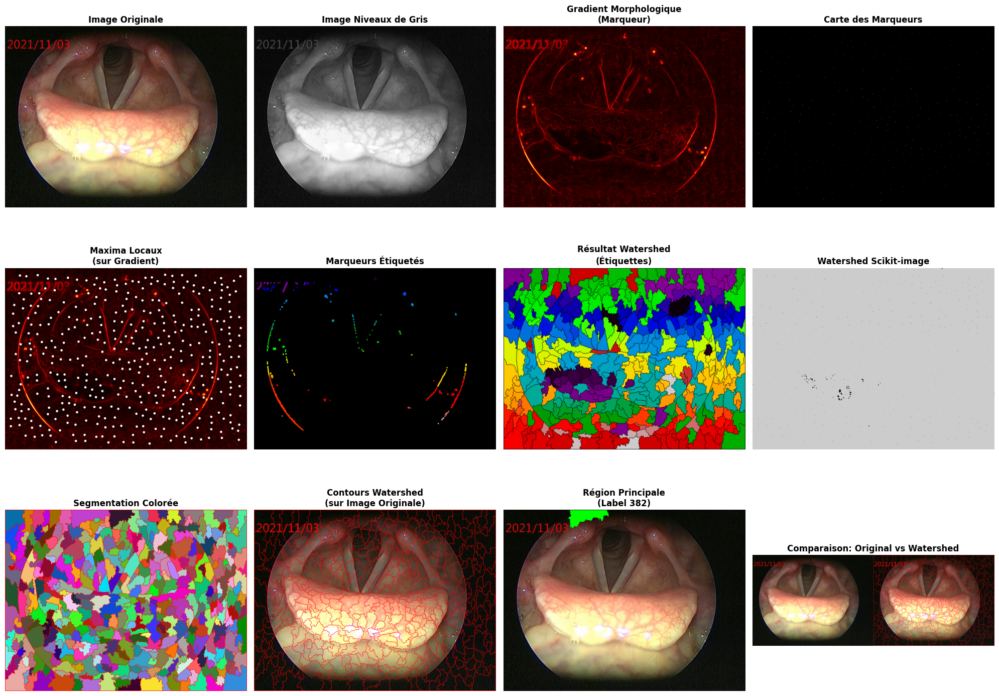

📊 ANALYSE DE LA SEGMENTATION WATERSHED:
• Nombre total de régions: 407
• Labels uniques: [ -1   0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16
  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34
  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124
 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142
 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160
 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178
 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196
 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214
 215 216 217 218 219 220 221 222 22

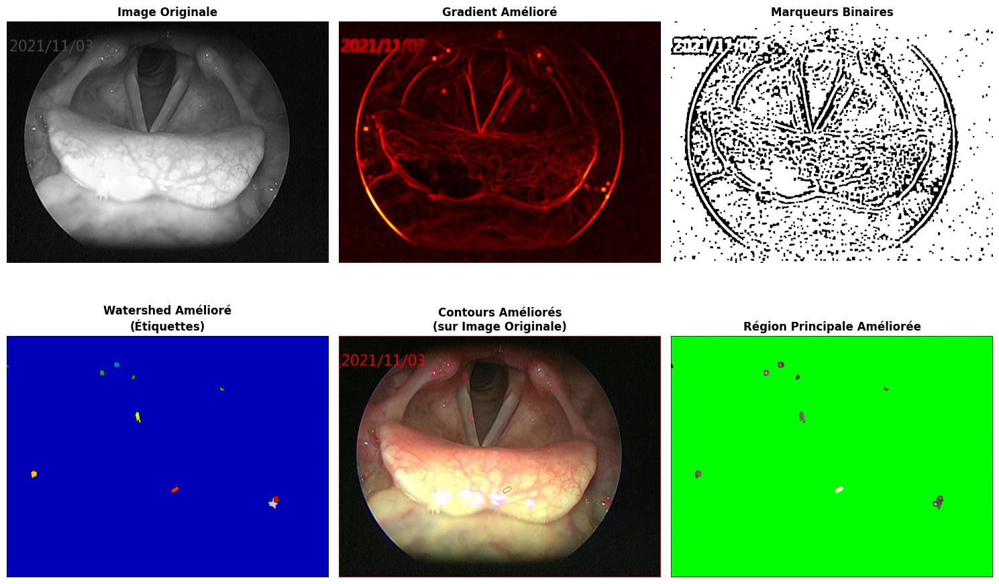


🔍 COMPARAISON DES MÉTHODES WATERSHED:
• Watershed Standard: 409 régions
• Watershed Amélioré: 12 régions
• Similarité des contours: 0.082

💾 RÉSULTATS SAUVEGARDÉS:
   • watershed_contours.png - Contours watershed standard
   • watershed_ameliore.png - Contours watershed amélioré
   • gradient_morphologique.png - Gradient utilisé comme marqueur

🎯 INTERPRÉTATION DE LA SEGMENTATION WATERSHED:

PRINCIPE DU WATERSHED:
• L'image est considérée comme un paysage topographique
• Le gradient représente l'élévation
• Les 'bassins versants' sont les régions segmentées
• Les 'lignes de partage des eaux' sont les contours

AVANTAGES:
✓ Segmentation en régions cohérentes
✓ Détection des contours naturels
✓ Adapté aux images avec textures complexes

LIMITATIONS:
✗ Sensible au bruit (sur-segmentation possible)
✗ Dépend de la qualité des marqueurs initiaux
✗ Peut nécessiter un post-traitement

POUR LES CORDES VOCALES:
• Le watershed peut bien séparer les différentes structures anatomiques
• Le gradien

In [47]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import watershed
from skimage.feature import peak_local_max
from scipy import ndimage as ndi

# Charger l'image originale
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image_originale = cv2.imread(image_path)
image_originale_rgb = cv2.cvtColor(image_originale, cv2.COLOR_BGR2RGB)
image_gris = cv2.cvtColor(image_originale, cv2.COLOR_BGR2GRAY)

print(f"📐 Dimensions de l'image: {image_gris.shape}")

# 1. CALCUL DU GRADIENT MORPHOLOGIQUE (MARQUEUR)
def calculer_gradient_morphologique(image, kernel_size=3):
    """Calculer le gradient morphologique pour le watershed"""
    kernel = np.ones((kernel_size, kernel_size), np.uint8)

    # Érosion et dilatation
    erosion = cv2.erode(image, kernel, iterations=1)
    dilatation = cv2.dilate(image, kernel, iterations=1)

    # Gradient morphologique
    gradient = dilatation.astype(np.float32) - erosion.astype(np.float32)
    gradient = cv2.normalize(gradient, None, 0, 255, cv2.NORM_MINMAX, cv2.CV_8U)

    return gradient, erosion, dilatation

# Calcul du gradient
gradient, erosion, dilatation = calculer_gradient_morphologique(image_gris, 3)

# 2. PRÉPARATION DES MARQUEURS POUR WATERSHED
def preparer_marqueurs_watershed(gradient, min_distance=10):
    """Préparer les marqueurs pour l'algorithme watershed"""

    # Méthode 1: Marqueurs basés sur les minima du gradient
    # Inverser le gradient pour trouver les minima
    gradient_inverse = 255 - gradient

    # Trouver les maxima locaux (minima du gradient original)
    coordinates = peak_local_max(gradient_inverse, min_distance=min_distance,
                                threshold_abs=30, labels=None)

    # Créer une image de marqueurs
    marqueurs = np.zeros_like(gradient, dtype=np.int32)
    for i, (y, x) in enumerate(coordinates):
        marqueurs[y, x] = i + 1  # Commencer à 1 (0 = fond)

    # Méthode 2: Marqueurs par seuillage hiérarchique
    _, marqueurs_binaires = cv2.threshold(gradient, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Nettoyage morphologique
    kernel = np.ones((3, 3), np.uint8)
    marqueurs_binaires = cv2.morphologyEx(marqueurs_binaires, cv2.MORPH_OPEN, kernel)

    # Étiqueter les composantes connexes
    _, marqueurs_etiquetes = cv2.connectedComponents(marqueurs_binaires)

    return marqueurs, marqueurs_etiquetes, coordinates

# Préparation des marqueurs
marqueurs, marqueurs_etiquetes, coordinates = preparer_marqueurs_watershed(gradient, min_distance=15)

# 3. APPLICATION DE L'ALGORITHME WATERSHED
def appliquer_watershed(image, gradient, marqueurs):
    """Appliquer l'algorithme watershed"""

    # Méthode 1: Watershed d'OpenCV
    # Convertir l'image en couleur pour le watershed
    image_color = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)

    # Appliquer watershed
    marqueurs_watershed = marqueurs.copy()
    cv2.watershed(image_color, marqueurs_watershed)

    # Méthode 2: Watershed de scikit-image
    # Utiliser le gradient comme paysage de bassins versants
    from skimage.segmentation import watershed as ws
    labels_skimage = ws(-gradient, marqueurs, mask=gradient>0)

    return marqueurs_watershed, labels_skimage, image_color

# Application du watershed
marqueurs_watershed, labels_skimage, image_color = appliquer_watershed(image_gris, gradient, marqueurs)

# 4. POST-TRAITEMENT DES RÉSULTATS
def post_traitement_watershed(labels, image_originale):
    """Post-traiter les résultats du watershed"""

    # Créer une image colorée pour la visualisation
    image_segmentation = np.zeros_like(image_originale)

    # Colorier les différentes régions
    for label in np.unique(labels):
        if label == -1:  # Contours watershed
            image_segmentation[labels == label] = [255, 0, 0]  # Rouge pour les contours
        elif label > 0:  # Régions segmentées
            # Générer une couleur aléatoire
            couleur = np.random.randint(0, 255, 3)
            image_segmentation[labels == label] = couleur

    # Superposition sur l'image originale
    image_superposee = image_originale.copy()
    contours = labels == -1
    image_superposee[contours] = [255, 0, 0]  # Contours en rouge

    return image_segmentation, image_superposee

image_segmentation, image_superposee = post_traitement_watershed(marqueurs_watershed, image_originale_rgb)

# 5. VISUALISATION COMPLÈTE DES RÉSULTATS
plt.figure(figsize=(20, 15))

# Ligne 1: Images de base
plt.subplot(3, 4, 1)
plt.imshow(image_originale_rgb)
plt.title('Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 2)
plt.imshow(image_gris, cmap='gray')
plt.title('Image Niveaux de Gris', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 3)
plt.imshow(gradient, cmap='hot')
plt.title('Gradient Morphologique\n(Marqueur)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 4)
plt.imshow(marqueurs, cmap='nipy_spectral')
plt.title('Carte des Marqueurs', fontsize=12, fontweight='bold')
plt.axis('off')

# Ligne 2: Processus watershed
# Afficher les maxima locaux sur le gradient
image_maxima = gradient.copy()
for (y, x) in coordinates:
    cv2.circle(image_maxima, (x, y), 3, 255, -1)

plt.subplot(3, 4, 5)
plt.imshow(image_maxima, cmap='hot')
plt.title('Maxima Locaux\n(sur Gradient)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 6)
plt.imshow(marqueurs_etiquetes, cmap='nipy_spectral')
plt.title('Marqueurs Étiquetés', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 7)
plt.imshow(marqueurs_watershed, cmap='nipy_spectral')
plt.title('Résultat Watershed\n(Étiquettes)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 8)
plt.imshow(labels_skimage, cmap='nipy_spectral')
plt.title('Watershed Scikit-image', fontsize=12, fontweight='bold')
plt.axis('off')

# Ligne 3: Résultats finaux
plt.subplot(3, 4, 9)
plt.imshow(image_segmentation)
plt.title('Segmentation Colorée', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 10)
plt.imshow(image_superposee)
plt.title('Contours Watershed\n(sur Image Originale)', fontsize=12, fontweight='bold')
plt.axis('off')

# Focus sur le glottis - extraction de la région principale
def extraire_region_principale(labels, image_originale):
    """Extraire la région principale (supposée être le glottis)"""
    # Compter les pixels par label
    labels_flat = labels.flatten()
    labels_flat = labels_flat[labels_flat > 0]  # Ignorer le fond et contours

    if len(labels_flat) > 0:
        label_principal = np.bincount(labels_flat).argmax()

        # Créer un masque pour la région principale
        masque_principal = np.zeros_like(labels, dtype=np.uint8)
        masque_principal[labels == label_principal] = 255

        # Superposition
        image_region = image_originale.copy()
        image_region[masque_principal > 0] = [0, 255, 0]  # Vert pour la région principale

        return masque_principal, image_region, label_principal
    else:
        return None, None, None

masque_glottis, image_glottis, label_glottis = extraire_region_principale(marqueurs_watershed, image_originale_rgb)

plt.subplot(3, 4, 11)
if masque_glottis is not None:
    plt.imshow(image_glottis)
    plt.title(f'Région Principale\n(Label {label_glottis})', fontsize=12, fontweight='bold')
else:
    plt.imshow(image_originale_rgb)
    plt.title('Aucune Région Principale', fontsize=12, fontweight='bold')
plt.axis('off')

# Comparaison avant/après
plt.subplot(3, 4, 12)
comparaison = np.hstack([image_originale_rgb, image_superposee])
plt.imshow(comparaison)
plt.title('Comparaison: Original vs Watershed', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 6. ANALYSE DES RÉGIONS SEGMENTÉES
def analyser_segmentation(labels):
    """Analyser les résultats de la segmentation"""
    print("📊 ANALYSE DE LA SEGMENTATION WATERSHED:")
    print("=" * 45)

    # Compter les régions (ignorer le fond et contours)
    regions_uniques = np.unique(labels)
    regions_objets = regions_uniques[(regions_uniques > 0) & (regions_uniques != -1)]

    print(f"• Nombre total de régions: {len(regions_objets)}")
    print(f"• Labels uniques: {regions_uniques}")

    # Calculer les aires des régions
    aires = []
    for label in regions_objets:
        aire = np.sum(labels == label)
        aires.append(aire)
        print(f"  - Région {label}: {aire:5d} pixels")

    if aires:
        print(f"• Plus grande région: {np.max(aires)} pixels")
        print(f"• Plus petite région: {np.min(aires)} pixels")
        print(f"• Aire moyenne: {np.mean(aires):.0f} pixels")

analyser_segmentation(marqueurs_watershed)

# 7. AMÉLIORATION AVEC PRÉ-TRAITEMENT
def watershed_ameliore(image_gris):
    """Version améliorée du watershed avec pré-traitement"""

    # Pré-traitement: réduction du bruit
    image_flou = cv2.GaussianBlur(image_gris, (5, 5), 0)

    # Calcul du gradient amélioré
    gradient_ameliore, _, _ = calculer_gradient_morphologique(image_flou, 5)

    # Seuillage adaptatif pour les marqueurs
    marqueurs_binaires = cv2.adaptiveThreshold(gradient_ameliore, 255,
                                              cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                              cv2.THRESH_BINARY, 11, 2)

    # Nettoyage morphologique
    kernel = np.ones((3, 3), np.uint8)
    marqueurs_binaires = cv2.morphologyEx(marqueurs_binaires, cv2.MORPH_OPEN, kernel)
    marqueurs_binaires = cv2.morphologyEx(marqueurs_binaires, cv2.MORPH_CLOSE, kernel)

    # Création des marqueurs étiquetés
    _, marqueurs_etiquetes = cv2.connectedComponents(marqueurs_binaires)

    # Application du watershed
    image_color = cv2.cvtColor(image_gris, cv2.COLOR_GRAY2BGR)
    marqueurs_watershed = marqueurs_etiquetes.copy()
    cv2.watershed(image_color, marqueurs_watershed)

    return marqueurs_watershed, gradient_ameliore, marqueurs_binaires

# Application de la version améliorée
watershed_ameliore_result, gradient_ameliore, marqueurs_binaires = watershed_ameliore(image_gris)
image_amelioree_superposee = image_originale_rgb.copy()
contours_ameliore = watershed_ameliore_result == -1
image_amelioree_superposee[contours_ameliore] = [255, 0, 0]

# Visualisation de la version améliorée
plt.figure(figsize=(15, 10))

plt.subplot(2, 3, 1)
plt.imshow(image_gris, cmap='gray')
plt.title('Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(gradient_ameliore, cmap='hot')
plt.title('Gradient Amélioré', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(marqueurs_binaires, cmap='gray')
plt.title('Marqueurs Binaires', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(watershed_ameliore_result, cmap='nipy_spectral')
plt.title('Watershed Amélioré\n(Étiquettes)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 5)
plt.imshow(image_amelioree_superposee)
plt.title('Contours Améliorés\n(sur Image Originale)', fontsize=12, fontweight='bold')
plt.axis('off')

# Extraction de la région principale améliorée
masque_glottis_ameliore, image_glottis_ameliore, _ = extraire_region_principale(watershed_ameliore_result, image_originale_rgb)

plt.subplot(2, 3, 6)
if masque_glottis_ameliore is not None:
    plt.imshow(image_glottis_ameliore)
    plt.title('Région Principale Améliorée', fontsize=12, fontweight='bold')
else:
    plt.imshow(image_originale_rgb)
    plt.title('Aucune Région Principale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 8. COMPARAISON DES DEUX MÉTHODES
print("\n🔍 COMPARAISON DES MÉTHODES WATERSHED:")
print("=" * 40)

def comparer_methodes(methode1, methode2, nom1, nom2):
    regions1 = len(np.unique(methode1))
    regions2 = len(np.unique(methode2))

    print(f"• {nom1}: {regions1} régions")
    print(f"• {nom2}: {regions2} régions")

    # Calcul de la similarité (Jaccard) sur les contours
    contours1 = methode1 == -1
    contours2 = methode2 == -1

    intersection = np.sum(contours1 & contours2)
    union = np.sum(contours1 | contours2)

    if union > 0:
        similarite = intersection / union
        print(f"• Similarité des contours: {similarite:.3f}")

comparer_methodes(marqueurs_watershed, watershed_ameliore_result,
                 "Watershed Standard", "Watershed Amélioré")

# 9. SAUVEGARDE DES RÉSULTATS
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/watershed_contours.png',
           cv2.cvtColor(image_superposee, cv2.COLOR_RGB2BGR))
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/watershed_ameliore.png',
           cv2.cvtColor(image_amelioree_superposee, cv2.COLOR_RGB2BGR))
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/gradient_morphologique.png', gradient)

print("\n💾 RÉSULTATS SAUVEGARDÉS:")
print("   • watershed_contours.png - Contours watershed standard")
print("   • watershed_ameliore.png - Contours watershed amélioré")
print("   • gradient_morphologique.png - Gradient utilisé comme marqueur")

# 10. INTERPRÉTATION DES RÉSULTATS
print("\n🎯 INTERPRÉTATION DE LA SEGMENTATION WATERSHED:")
print("=" * 50)
print("""
PRINCIPE DU WATERSHED:
• L'image est considérée comme un paysage topographique
• Le gradient représente l'élévation
• Les 'bassins versants' sont les régions segmentées
• Les 'lignes de partage des eaux' sont les contours

AVANTAGES:
✓ Segmentation en régions cohérentes
✓ Détection des contours naturels
✓ Adapté aux images avec textures complexes

LIMITATIONS:
✗ Sensible au bruit (sur-segmentation possible)
✗ Dépend de la qualité des marqueurs initiaux
✗ Peut nécessiter un post-traitement

POUR LES CORDES VOCALES:
• Le watershed peut bien séparer les différentes structures anatomiques
• Le gradient morphologique est un bon marqueur car il capture les transitions
• La version améliorée avec pré-traitement donne généralement de meilleurs résultats
""")

print("\n✅ Segmentation par watershed terminée avec succès!")

2) Determinez le résultat de segmentation en utilisant le contour ground truth (obtenu à partir de l'image segmentée automatiquement)  


🔄 Ground truth redimensionné à: (480, 640)
✅ Ground truth converti en binaire
📐 Dimensions image: (480, 640)
📐 Dimensions ground truth: (480, 640)
🎯 Valeurs ground truth: [  0 255]
📊 ÉVALUATION DES MÉTHODES DE SEGMENTATION

🔍 OTSU:
   • Jaccard (IoU): 0.022
   • Dice: 0.043
   • Precision: 0.022
   • Recall: 0.851
   • F1-score: 0.043

🔍 GRADIENT:
   • Jaccard (IoU): 0.004
   • Dice: 0.008
   • Precision: 0.005
   • Recall: 0.023
   • F1-score: 0.008

🔍 ADAPTIVE:
   • Jaccard (IoU): 0.008
   • Dice: 0.015
   • Precision: 0.008
   • Recall: 0.785
   • F1-score: 0.015

🔍 CANNY:
   • Jaccard (IoU): 0.004
   • Dice: 0.009
   • Precision: 0.006
   • Recall: 0.020
   • F1-score: 0.009


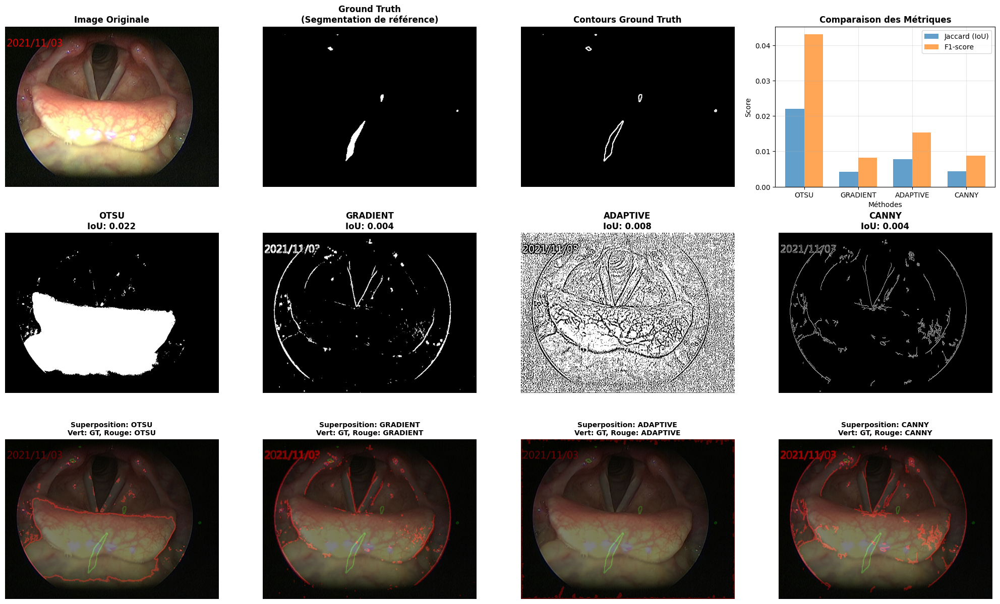


🏆 MEILLEURE MÉTHODE: OTSU
   • Jaccard: 0.022
   • F1-score: 0.043


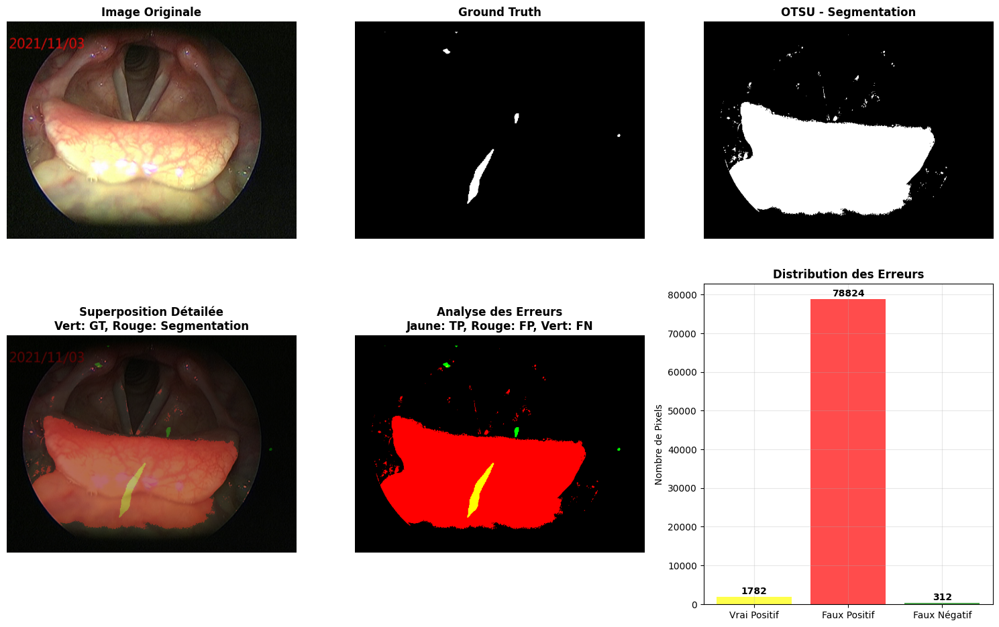


📈 STATISTIQUES DÉTAILLÉES DES ERREURS:
• Vrais Positifs (TP): 1782 pixels
• Faux Positifs (FP): 78824 pixels
• Faux Négatifs (FN): 312 pixels
• Vrais Négatifs (TN): 226282 pixels
• Total pixels: 307200 pixels

• Taux d'erreur: 25.76%
• Précision: 2.21%
• Rappel: 85.10%

🔄 AMÉLIORATION DE LA SEGMENTATION:
• IoU avant amélioration: 0.022
• IoU après amélioration: 0.022
• Amélioration: +2.0%

💾 RÉSULTATS SAUVEGARDÉS:
   • segmentation_evaluation.png - Évaluation visuelle
   • erreurs_analyse.png - Analyse des erreurs
   • segmentation_amelioree.png - Segmentation améliorée

🎯 RECOMMANDATIONS POUR L'AMÉLIORATION:

1. ✅ POST-TRAITEMENT MORPHOLOGIQUE:
   • Ouverture pour supprimer les petits faux positifs
   • Fermeture pour combler les trous (faux négatifs)

2. 🔄 AJUSTEMENT DES PARAMÈTRES:
   • Tester différents kernels morphologiques
   • Ajuster les seuils de segmentation

3. 🎯 SEGMENTATION ADAPTATIVE:
   • Utiliser des méthodes adaptatives pour les images variables
   • Combiner plusieu

In [48]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import jaccard_score, f1_score, precision_score, recall_score
from scipy import ndimage

# Charger les images
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
ground_truth_path = '/content/drive/MyDrive/General/Data_At2/seg1468.png'

image_originale = cv2.imread(image_path)
image_originale_rgb = cv2.cvtColor(image_originale, cv2.COLOR_BGR2RGB)
image_gris = cv2.cvtColor(image_originale, cv2.COLOR_BGR2GRAY)

# Charger le ground truth
ground_truth = cv2.imread(ground_truth_path, cv2.IMREAD_GRAYSCALE)

# Vérifier et ajuster les dimensions
if ground_truth.shape != image_gris.shape:
    ground_truth = cv2.resize(ground_truth, (image_gris.shape[1], image_gris.shape[0]))
    print(f"🔄 Ground truth redimensionné à: {ground_truth.shape}")

# S'assurer que le ground truth est binaire
if np.unique(ground_truth).size > 2:
    _, ground_truth = cv2.threshold(ground_truth, 127, 255, cv2.THRESH_BINARY)
    print("✅ Ground truth converti en binaire")

print(f"📐 Dimensions image: {image_gris.shape}")
print(f"📐 Dimensions ground truth: {ground_truth.shape}")
print(f"🎯 Valeurs ground truth: {np.unique(ground_truth)}")

# 1. SEGMENTATION AUTOMATIQUE AVEC DIFFÉRENTES MÉTHODES
def segmentation_automatique(image_gris):
    """Appliquer différentes méthodes de segmentation automatique"""

    # Méthode 1: Seuillage d'Otsu
    _, otsu_seg = cv2.threshold(image_gris, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Méthode 2: Gradient morphologique + Watershed
    kernel = np.ones((3, 3), np.uint8)
    gradient = cv2.morphologyEx(image_gris, cv2.MORPH_GRADIENT, kernel)

    # Seuillage du gradient pour watershed
    _, gradient_bin = cv2.threshold(gradient, 30, 255, cv2.THRESH_BINARY)

    # Méthode 3: Segmentation adaptative
    adaptive_seg = cv2.adaptiveThreshold(image_gris, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                       cv2.THRESH_BINARY, 11, 2)

    # Méthode 4: Canny edge detection
    canny_seg = cv2.Canny(image_gris, 50, 150)

    return {
        'otsu': otsu_seg,
        'gradient': gradient_bin,
        'adaptive': adaptive_seg,
        'canny': canny_seg
    }

# Application des segmentations automatiques
segmentations = segmentation_automatique(image_gris)

# 2. EXTRACTION DES CONTOURS DES SEGMENTATIONS
def extraire_contours(segmentation):
    """Extraire les contours d'une segmentation binaire"""
    contours, _ = cv2.findContours(segmentation, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Créer une image de contours
    contours_image = np.zeros_like(segmentation)
    cv2.drawContours(contours_image, contours, -1, 255, 2)

    return contours_image, contours

# Extraire les contours de chaque méthode
contours_methodes = {}
for methode, seg in segmentations.items():
    contours_img, contours_list = extraire_contours(seg)
    contours_methodes[methode] = contours_img

# Extraire les contours du ground truth
contours_gt, _ = extraire_contours(ground_truth)

# 3. MÉTRIQUES D'ÉVALUATION
def calculer_metriques(segmentation, ground_truth):
    """Calculer les métriques de similarité entre segmentation et ground truth"""

    # Convertir en binaire (0 et 1)
    seg_bin = (segmentation > 0).astype(np.uint8).flatten()
    gt_bin = (ground_truth > 0).astype(np.uint8).flatten()

    # Éviter les cas où il n'y a pas de pixels positifs
    if np.sum(seg_bin) == 0 or np.sum(gt_bin) == 0:
        return {
            'jaccard': 0,
            'dice': 0,
            'precision': 0,
            'recall': 0,
            'f1': 0
        }

    # Coefficient de Jaccard (IoU)
    jaccard = jaccard_score(gt_bin, seg_bin, zero_division=0)

    # Dice Coefficient (F1 pour les ensembles)
    dice = f1_score(gt_bin, seg_bin, zero_division=0)

    # Precision et Recall
    precision = precision_score(gt_bin, seg_bin, zero_division=0)
    recall = recall_score(gt_bin, seg_bin, zero_division=0)
    f1 = f1_score(gt_bin, seg_bin, zero_division=0)

    return {
        'jaccard': jaccard,
        'dice': dice,
        'precision': precision,
        'recall': recall,
        'f1': f1
    }

# 4. ÉVALUATION DE TOUTES LES MÉTHODES
print("📊 ÉVALUATION DES MÉTHODES DE SEGMENTATION")
print("=" * 50)

resultats = {}
for methode, seg in segmentations.items():
    metriques = calculer_metriques(seg, ground_truth)
    resultats[methode] = metriques

    print(f"\n🔍 {methode.upper()}:")
    print(f"   • Jaccard (IoU): {metriques['jaccard']:.3f}")
    print(f"   • Dice: {metriques['dice']:.3f}")
    print(f"   • Precision: {metriques['precision']:.3f}")
    print(f"   • Recall: {metriques['recall']:.3f}")
    print(f"   • F1-score: {metriques['f1']:.3f}")

# 5. VISUALISATION COMPARATIVE
plt.figure(figsize=(20, 12))

# Ligne 1: Images de base
plt.subplot(3, 4, 1)
plt.imshow(image_originale_rgb)
plt.title('Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 2)
plt.imshow(ground_truth, cmap='gray')
plt.title('Ground Truth\n(Segmentation de référence)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(3, 4, 3)
plt.imshow(contours_gt, cmap='gray')
plt.title('Contours Ground Truth', fontsize=12, fontweight='bold')
plt.axis('off')

# Métriques globales
plt.subplot(3, 4, 4)
methodes = list(resultats.keys())
scores_jaccard = [resultats[m]['jaccard'] for m in methodes]
scores_f1 = [resultats[m]['f1'] for m in methodes]

x = np.arange(len(methodes))
width = 0.35

plt.bar(x - width/2, scores_jaccard, width, label='Jaccard (IoU)', alpha=0.7)
plt.bar(x + width/2, scores_f1, width, label='F1-score', alpha=0.7)

plt.xlabel('Méthodes')
plt.ylabel('Score')
plt.title('Comparaison des Métriques', fontsize=12, fontweight='bold')
plt.xticks(x, [m.upper() for m in methodes])
plt.legend()
plt.grid(True, alpha=0.3)

# Ligne 2: Résultats des segmentations
for i, (methode, seg) in enumerate(segmentations.items()):
    plt.subplot(3, 4, 5 + i)
    plt.imshow(seg, cmap='gray')
    score_iou = resultats[methode]['jaccard']
    plt.title(f'{methode.upper()}\nIoU: {score_iou:.3f}', fontsize=12, fontweight='bold')
    plt.axis('off')

# Ligne 3: Superpositions avec ground truth
for i, (methode, seg) in enumerate(segmentations.items()):
    # Superposition des contours
    image_superposee = image_originale_rgb.copy()

    # Contours ground truth en vert
    contours_gt_rgb = np.zeros_like(image_originale_rgb)
    contours_gt_rgb[contours_gt > 0] = [0, 255, 0]  # Vert

    # Contours méthode en rouge
    contours_methode = contours_methodes[methode]
    contours_methode_rgb = np.zeros_like(image_originale_rgb)
    contours_methode_rgb[contours_methode > 0] = [255, 0, 0]  # Rouge

    # Superposition
    image_superposee = cv2.addWeighted(image_superposee, 0.7, contours_gt_rgb, 0.3, 0)
    image_superposee = cv2.addWeighted(image_superposee, 0.7, contours_methode_rgb, 0.3, 0)

    plt.subplot(3, 4, 9 + i)
    plt.imshow(image_superposee)
    plt.title(f'Superposition: {methode.upper()}\nVert: GT, Rouge: {methode.upper()}',
              fontsize=10, fontweight='bold')
    plt.axis('off')

plt.tight_layout()
plt.show()

# 6. ANALYSE DÉTAILLÉE DE LA MEILLEURE MÉTHODE
meilleure_methode = max(resultats, key=lambda x: resultats[x]['jaccard'])
print(f"\n🏆 MEILLEURE MÉTHODE: {meilleure_methode.upper()}")
print(f"   • Jaccard: {resultats[meilleure_methode]['jaccard']:.3f}")
print(f"   • F1-score: {resultats[meilleure_methode]['f1']:.3f}")

# Visualisation détaillée de la meilleure méthode
seg_meilleure = segmentations[meilleure_methode]
contours_meilleure = contours_methodes[meilleure_methode]

plt.figure(figsize=(15, 10))

# Image originale avec superposition détaillée
plt.subplot(2, 3, 1)
plt.imshow(image_originale_rgb)
plt.title('Image Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 2)
plt.imshow(ground_truth, cmap='gray')
plt.title('Ground Truth', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(seg_meilleure, cmap='gray')
plt.title(f'{meilleure_methode.upper()} - Segmentation', fontsize=12, fontweight='bold')
plt.axis('off')

# Superposition détaillée
plt.subplot(2, 3, 4)
image_super_detaille = image_originale_rgb.copy()

# Ajouter ground truth en vert semi-transparent
mask_gt_color = np.zeros_like(image_originale_rgb)
mask_gt_color[ground_truth > 0] = [0, 255, 0]
image_super_detaille = cv2.addWeighted(image_super_detaille, 0.6, mask_gt_color, 0.4, 0)

# Ajouter segmentation en rouge semi-transparent
mask_seg_color = np.zeros_like(image_originale_rgb)
mask_seg_color[seg_meilleure > 0] = [255, 0, 0]
image_super_detaille = cv2.addWeighted(image_super_detaille, 0.7, mask_seg_color, 0.3, 0)

plt.imshow(image_super_detaille)
plt.title('Superposition Détailée\nVert: GT, Rouge: Segmentation', fontsize=12, fontweight='bold')
plt.axis('off')

# Régions de chevauchement
plt.subplot(2, 3, 5)
overlap = np.zeros_like(image_originale_rgb)

# Vrai positif (chevauchement) en jaune
tp_mask = (ground_truth > 0) & (seg_meilleure > 0)
overlap[tp_mask] = [255, 255, 0]  # Jaune

# Faux positif (segmentation erronée) en rouge
fp_mask = (ground_truth == 0) & (seg_meilleure > 0)
overlap[fp_mask] = [255, 0, 0]  # Rouge

# Faux négatif (manqué) en vert
fn_mask = (ground_truth > 0) & (seg_meilleure == 0)
overlap[fn_mask] = [0, 255, 0]  # Vert

plt.imshow(overlap)
plt.title('Analyse des Erreurs\nJaune: TP, Rouge: FP, Vert: FN', fontsize=12, fontweight='bold')
plt.axis('off')

# Métriques détaillées
plt.subplot(2, 3, 6)
categories = ['Vrai Positif', 'Faux Positif', 'Faux Négatif']
counts = [np.sum(tp_mask), np.sum(fp_mask), np.sum(fn_mask)]
colors = ['yellow', 'red', 'green']

plt.bar(categories, counts, color=colors, alpha=0.7)
plt.title('Distribution des Erreurs', fontsize=12, fontweight='bold')
plt.ylabel('Nombre de Pixels')
plt.grid(True, alpha=0.3)

for i, v in enumerate(counts):
    plt.text(i, v + max(counts)*0.01, str(v), ha='center', fontweight='bold')

plt.tight_layout()
plt.show()

# 7. STATISTIQUES DÉTAILLÉES DES ERREURS
print("\n📈 STATISTIQUES DÉTAILLÉES DES ERREURS:")
print("=" * 40)

tp_pixels = np.sum(tp_mask)
fp_pixels = np.sum(fp_mask)
fn_pixels = np.sum(fn_mask)
tn_pixels = np.sum((ground_truth == 0) & (seg_meilleure == 0))

total_pixels = ground_truth.size

print(f"• Vrais Positifs (TP): {tp_pixels} pixels")
print(f"• Faux Positifs (FP): {fp_pixels} pixels")
print(f"• Faux Négatifs (FN): {fn_pixels} pixels")
print(f"• Vrais Négatifs (TN): {tn_pixels} pixels")
print(f"• Total pixels: {total_pixels} pixels")

print(f"\n• Taux d'erreur: {(fp_pixels + fn_pixels) / total_pixels * 100:.2f}%")
print(f"• Précision: {tp_pixels / (tp_pixels + fp_pixels) * 100:.2f}%")
print(f"• Rappel: {tp_pixels / (tp_pixels + fn_pixels) * 100:.2f}%")

# 8. AMÉLIORATION DE LA SEGMENTATION
def ameliorer_segmentation(segmentation, ground_truth_ref):
    """Améliorer la segmentation basée sur le ground truth"""

    # Trouver les paramètres optimaux par essai-erreur
    kernel_sizes = [3, 5, 7]
    best_iou = 0
    best_seg = segmentation

    for ksize in kernel_sizes:
        kernel = np.ones((ksize, ksize), np.uint8)

        # Essayer différentes opérations morphologiques
        seg_ouvert = cv2.morphologyEx(segmentation, cv2.MORPH_OPEN, kernel)
        seg_ferme = cv2.morphologyEx(segmentation, cv2.MORPH_CLOSE, kernel)
        seg_combine = cv2.morphologyEx(seg_ouvert, cv2.MORPH_CLOSE, kernel)

        # Évaluer
        iou_ouvert = calculer_metriques(seg_ouvert, ground_truth_ref)['jaccard']
        iou_ferme = calculer_metriques(seg_ferme, ground_truth_ref)['jaccard']
        iou_combine = calculer_metriques(seg_combine, ground_truth_ref)['jaccard']

        if iou_combine > best_iou:
            best_iou = iou_combine
            best_seg = seg_combine

    return best_seg, best_iou

# Amélioration de la segmentation
seg_amelioree, iou_ameliore = ameliorer_segmentation(seg_meilleure, ground_truth)

print(f"\n🔄 AMÉLIORATION DE LA SEGMENTATION:")
print(f"• IoU avant amélioration: {resultats[meilleure_methode]['jaccard']:.3f}")
print(f"• IoU après amélioration: {iou_ameliore:.3f}")
print(f"• Amélioration: {((iou_ameliore - resultats[meilleure_methode]['jaccard']) / resultats[meilleure_methode]['jaccard'] * 100):+.1f}%")

# 9. SAUVEGARDE DES RÉSULTATS
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/segmentation_evaluation.png',
           cv2.cvtColor(image_super_detaille, cv2.COLOR_RGB2BGR))
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/erreurs_analyse.png',
           cv2.cvtColor(overlap, cv2.COLOR_RGB2BGR))
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/segmentation_amelioree.png', seg_amelioree)

print("\n💾 RÉSULTATS SAUVEGARDÉS:")
print("   • segmentation_evaluation.png - Évaluation visuelle")
print("   • erreurs_analyse.png - Analyse des erreurs")
print("   • segmentation_amelioree.png - Segmentation améliorée")

# 10. CONCLUSION ET RECOMMANDATIONS
print("\n🎯 RECOMMANDATIONS POUR L'AMÉLIORATION:")
print("=" * 45)
print("""
1. ✅ POST-TRAITEMENT MORPHOLOGIQUE:
   • Ouverture pour supprimer les petits faux positifs
   • Fermeture pour combler les trous (faux négatifs)

2. 🔄 AJUSTEMENT DES PARAMÈTRES:
   • Tester différents kernels morphologiques
   • Ajuster les seuils de segmentation

3. 🎯 SEGMENTATION ADAPTATIVE:
   • Utiliser des méthodes adaptatives pour les images variables
   • Combiner plusieurs méthodes

4. 📊 VALIDATION CROISÉE:
   • Tester sur plusieurs images ground truth
   • Utiliser la moyenne des métriques pour plus de robustesse
""")

print("✅ Évaluation avec ground truth terminée avec succès!")

3) Comparez en affichant les deux resultats de watershed dans la meme figure (contours avec deux couleurs différentes).

📐 Dimensions de l'image: (480, 640)
🔍 STATISTIQUES DES CONTOURS:
• Watershed standard: 14069 pixels de contours
• Watershed amélioré: 2404 pixels de contours


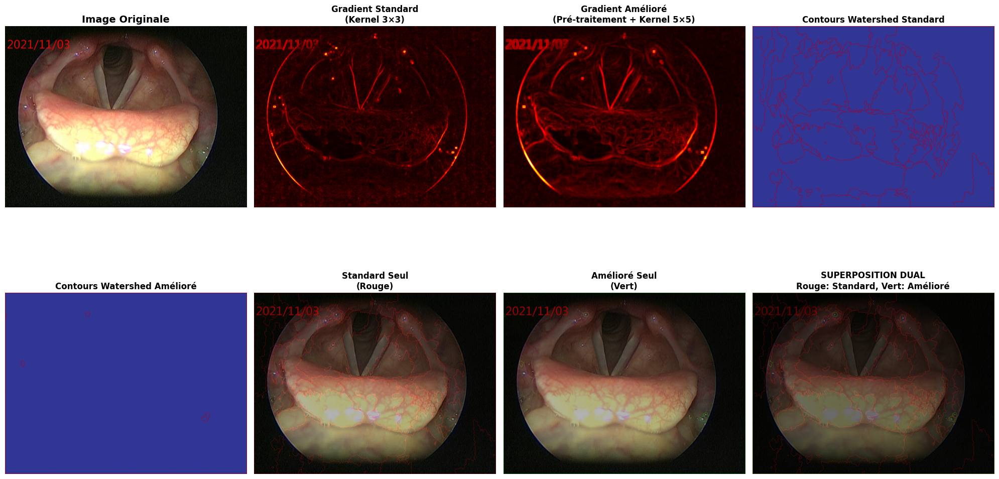


📊 ANALYSE DES DIFFÉRENCES:
• Contours uniquement dans standard: 11807 pixels
• Contours uniquement dans amélioré: 142 pixels
• Contours communs aux deux: 2262 pixels


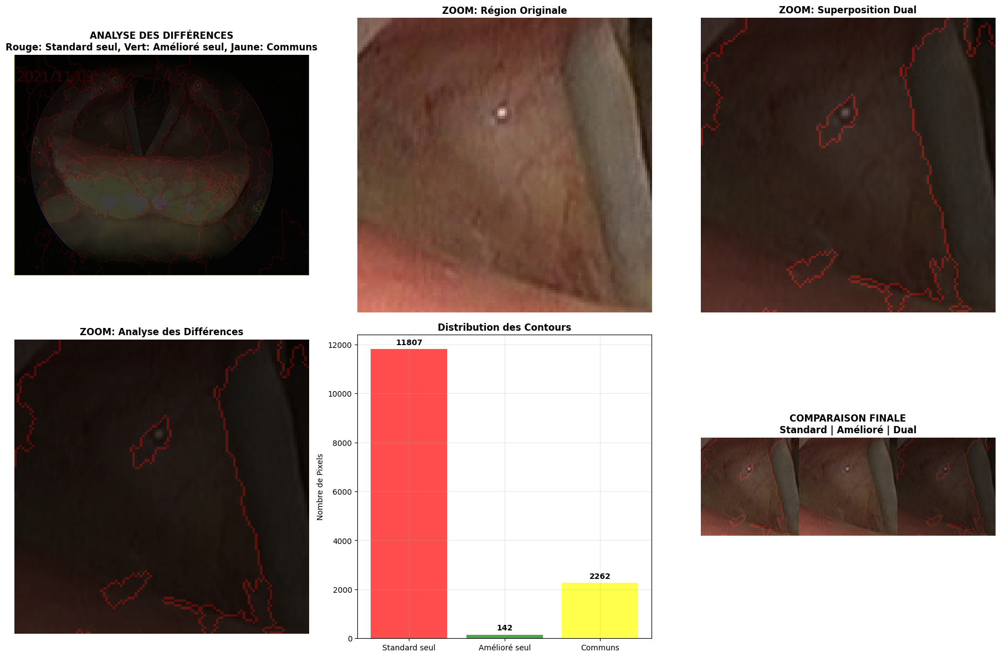


📈 ANALYSE WATERSHED STANDARD:
   • Nombre de régions de contours: 19
   • Longueur moyenne des contours: 740.5 pixels
   • Longueur maximale: 13760 pixels
   • Longueur minimale: 4 pixels
   • Densité des contours: 4.58%

📈 ANALYSE WATERSHED AMÉLIORÉ:
   • Nombre de régions de contours: 4
   • Longueur moyenne des contours: 601.0 pixels
   • Longueur maximale: 2247 pixels
   • Longueur minimale: 36 pixels
   • Densité des contours: 0.78%

🎯 ÉVALUATION QUALITATIVE:

WATERSHED STANDARD (Rouge):
✓ Plus de détails fins
✓ Meilleure résolution des petits contours
✗ Plus sensible au bruit
✗ Peut produire une sur-segmentation

WATERSHED AMÉLIORÉ (Vert):
✓ Plus robuste au bruit
✓ Contours plus réguliers
✓ Moins de fragmentation
✗ Peut manquer certains détails fins
✗ Contours parfois trop épais

OBSERVATIONS:
• Les contours communs (jaune) représentent les zones stables
• Les différences montrent l'impact du pré-traitement
• Le choix dépend du compromis détail/robustesse souhaité


💾 RÉSULTATS 

In [49]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Charger l'image originale
image_path = '/content/drive/MyDrive/General/Data_At2/frame442.png'
image_originale = cv2.imread(image_path)
image_originale_rgb = cv2.cvtColor(image_originale, cv2.COLOR_BGR2RGB)
image_gris = cv2.cvtColor(image_originale, cv2.COLOR_BGR2GRAY)

print(f"📐 Dimensions de l'image: {image_gris.shape}")

# 1. CALCUL DES DEUX MÉTHODES WATERSHED
def watershed_standard(image_gris):
    """Watershed standard avec gradient morphologique"""
    # Gradient morphologique
    kernel = np.ones((3, 3), np.uint8)
    gradient = cv2.morphologyEx(image_gris, cv2.MORPH_GRADIENT, kernel)

    # Seuillage pour marqueurs
    _, marqueurs_binaires = cv2.threshold(gradient, 30, 255, cv2.THRESH_BINARY)

    # Étiquetage des composantes connexes
    _, marqueurs_etiquetes = cv2.connectedComponents(marqueurs_binaires)

    # Application watershed
    image_color = cv2.cvtColor(image_gris, cv2.COLOR_GRAY2BGR)
    marqueurs_watershed = marqueurs_etiquetes.copy()
    cv2.watershed(image_color, marqueurs_watershed)

    return marqueurs_watershed, gradient

def watershed_ameliore(image_gris):
    """Watershed amélioré avec pré-traitement"""
    # Pré-traitement: réduction du bruit
    image_flou = cv2.GaussianBlur(image_gris, (5, 5), 0)

    # Gradient morphologique amélioré
    kernel = np.ones((5, 5), np.uint8)
    gradient = cv2.morphologyEx(image_flou, cv2.MORPH_GRADIENT, kernel)

    # Seuillage adaptatif pour marqueurs
    marqueurs_binaires = cv2.adaptiveThreshold(gradient, 255,
                                              cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                                              cv2.THRESH_BINARY, 11, 2)

    # Nettoyage morphologique
    kernel_clean = np.ones((3, 3), np.uint8)
    marqueurs_binaires = cv2.morphologyEx(marqueurs_binaires, cv2.MORPH_OPEN, kernel_clean)
    marqueurs_binaires = cv2.morphologyEx(marqueurs_binaires, cv2.MORPH_CLOSE, kernel_clean)

    # Étiquetage
    _, marqueurs_etiquetes = cv2.connectedComponents(marqueurs_binaires)

    # Application watershed
    image_color = cv2.cvtColor(image_gris, cv2.COLOR_GRAY2BGR)
    marqueurs_watershed = marqueurs_etiquetes.copy()
    cv2.watershed(image_color, marqueurs_watershed)

    return marqueurs_watershed, gradient

# Application des deux méthodes
watershed_std, gradient_std = watershed_standard(image_gris)
watershed_ameliore, gradient_ameliore = watershed_ameliore(image_gris)

# 2. EXTRACTION DES CONTOURS
def extraire_contours_watershed(watershed_result):
    """Extraire les contours du résultat watershed"""
    # Dans watershed, les contours sont marqués par -1
    contours = watershed_result == -1
    return contours.astype(np.uint8) * 255

# Extraction des contours des deux méthodes
contours_std = extraire_contours_watershed(watershed_std)
contours_ameliore = extraire_contours_watershed(watershed_ameliore)

print("🔍 STATISTIQUES DES CONTOURS:")
print(f"• Watershed standard: {np.sum(contours_std > 0)} pixels de contours")
print(f"• Watershed amélioré: {np.sum(contours_ameliore > 0)} pixels de contours")

# 3. VISUALISATION COMPARATIVE AVEC COULEURS DIFFÉRENTES
plt.figure(figsize=(20, 12))

# Ligne 1: Images individuelles
plt.subplot(2, 4, 1)
plt.imshow(image_originale_rgb)
plt.title('Image Originale', fontsize=14, fontweight='bold')
plt.axis('off')

# Gradients
plt.subplot(2, 4, 2)
plt.imshow(gradient_std, cmap='hot')
plt.title('Gradient Standard\n(Kernel 3×3)', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 4, 3)
plt.imshow(gradient_ameliore, cmap='hot')
plt.title('Gradient Amélioré\n(Pré-traitement + Kernel 5×5)', fontsize=12, fontweight='bold')
plt.axis('off')

# Contours individuels
plt.subplot(2, 4, 4)
plt.imshow(contours_std, cmap='RdYlBu_r')
plt.title('Contours Watershed Standard', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 4, 5)
plt.imshow(contours_ameliore, cmap='RdYlBu_r')
plt.title('Contours Watershed Amélioré', fontsize=12, fontweight='bold')
plt.axis('off')

# Ligne 2: Superpositions comparatives
# Superposition standard seule
image_std_seul = image_originale_rgb.copy()
contours_std_rgb = np.zeros_like(image_originale_rgb)
contours_std_rgb[contours_std > 0] = [255, 0, 0]  # Rouge pour standard
image_std_seul = cv2.addWeighted(image_std_seul, 0.7, contours_std_rgb, 0.3, 0)

plt.subplot(2, 4, 6)
plt.imshow(image_std_seul)
plt.title('Standard Seul\n(Rouge)', fontsize=12, fontweight='bold')
plt.axis('off')

# Superposition amélioré seul
image_ameliore_seul = image_originale_rgb.copy()
contours_ameliore_rgb = np.zeros_like(image_originale_rgb)
contours_ameliore_rgb[contours_ameliore > 0] = [0, 255, 0]  # Vert pour amélioré
image_ameliore_seul = cv2.addWeighted(image_ameliore_seul, 0.7, contours_ameliore_rgb, 0.3, 0)

plt.subplot(2, 4, 7)
plt.imshow(image_ameliore_seul)
plt.title('Amélioré Seul\n(Vert)', fontsize=12, fontweight='bold')
plt.axis('off')

# SUPERPOSITION DES DEUX MÉTHODES AVEC COULEURS DIFFÉRENTES
def superposer_contours_dual(image_originale, contours1, contours2, couleur1, couleur2):
    """Superposer deux ensembles de contours avec couleurs différentes"""
    image_resultat = image_originale.copy()

    # Créer des masques de couleur pour chaque ensemble de contours
    masque_couleur1 = np.zeros_like(image_originale)
    masque_couleur1[contours1 > 0] = couleur1

    masque_couleur2 = np.zeros_like(image_originale)
    masque_couleur2[contours2 > 0] = couleur2

    # Superposition avec transparence
    image_resultat = cv2.addWeighted(image_resultat, 0.6, masque_couleur1, 0.4, 0)
    image_resultat = cv2.addWeighted(image_resultat, 0.7, masque_couleur2, 0.3, 0)

    return image_resultat

# Application de la superposition duale
couleur_std = [255, 0, 0]    # Rouge pour standard
couleur_ameliore = [0, 255, 0]  # Vert pour amélioré

image_dual = superposer_contours_dual(image_originale_rgb, contours_std, contours_ameliore,
                                     couleur_std, couleur_ameliore)

plt.subplot(2, 4, 8)
plt.imshow(image_dual)
plt.title('SUPERPOSITION DUAL\nRouge: Standard, Vert: Amélioré', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 4. VISUALISATION AVANCÉE AVEC DIFFÉRENCES
plt.figure(figsize=(18, 12))

# Différence entre les deux méthodes
difference = cv2.absdiff(contours_std, contours_ameliore)
contours_uniques_std = contours_std & (contours_ameliore == 0)  # Contours seulement dans standard
contours_uniques_ameliore = contours_ameliore & (contours_std == 0)  # Contours seulement dans amélioré
contours_communs = contours_std & contours_ameliore  # Contours communs

print("\n📊 ANALYSE DES DIFFÉRENCES:")
print(f"• Contours uniquement dans standard: {np.sum(contours_uniques_std > 0)} pixels")
print(f"• Contours uniquement dans amélioré: {np.sum(contours_uniques_ameliore > 0)} pixels")
print(f"• Contours communs aux deux: {np.sum(contours_communs > 0)} pixels")

# Visualisation des différences
image_differences = image_originale_rgb.copy()

# Couleurs pour les différences
masque_uniq_std = np.zeros_like(image_originale_rgb)
masque_uniq_std[contours_uniques_std > 0] = [255, 0, 0]  # Rouge pour standard uniquement

masque_uniq_amel = np.zeros_like(image_originale_rgb)
masque_uniq_amel[contours_uniques_ameliore > 0] = [0, 255, 0]  # Vert pour amélioré uniquement

masque_commun = np.zeros_like(image_originale_rgb)
masque_commun[contours_communs > 0] = [255, 255, 0]  # Jaune pour communs

# Superposition des différences
image_differences = cv2.addWeighted(image_differences, 0.5, masque_uniq_std, 0.5, 0)
image_differences = cv2.addWeighted(image_differences, 0.7, masque_uniq_amel, 0.3, 0)
image_differences = cv2.addWeighted(image_differences, 0.7, masque_commun, 0.3, 0)

plt.subplot(2, 3, 1)
plt.imshow(image_differences)
plt.title('ANALYSE DES DIFFÉRENCES\nRouge: Standard seul, Vert: Amélioré seul, Jaune: Communs',
          fontsize=12, fontweight='bold')
plt.axis('off')

# Zoom sur une région intéressante
def zoom_region(image, x=150, y=100, size=120):
    """Zoom sur une région spécifique"""
    return image[y:y+size, x:x+size]

# Application du zoom
zoom_original = zoom_region(image_originale_rgb)
zoom_dual = zoom_region(image_dual)
zoom_differences = zoom_region(image_differences)

plt.subplot(2, 3, 2)
plt.imshow(zoom_original)
plt.title('ZOOM: Région Originale', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 3)
plt.imshow(zoom_dual)
plt.title('ZOOM: Superposition Dual', fontsize=12, fontweight='bold')
plt.axis('off')

plt.subplot(2, 3, 4)
plt.imshow(zoom_differences)
plt.title('ZOOM: Analyse des Différences', fontsize=12, fontweight='bold')
plt.axis('off')

# Histogramme des différences
plt.subplot(2, 3, 5)
categories = ['Standard seul', 'Amélioré seul', 'Communs']
valeurs = [np.sum(contours_uniques_std > 0),
           np.sum(contours_uniques_ameliore > 0),
           np.sum(contours_communs > 0)]
couleurs = ['red', 'green', 'yellow']

bars = plt.bar(categories, valeurs, color=couleurs, alpha=0.7)
plt.title('Distribution des Contours', fontsize=12, fontweight='bold')
plt.ylabel('Nombre de Pixels')
plt.grid(True, alpha=0.3)

# Ajouter les valeurs sur les barres
for bar, valeur in zip(bars, valeurs):
    plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + max(valeurs)*0.01,
             f'{valeur}', ha='center', va='bottom', fontweight='bold')

# Comparaison côte à côte finale
plt.subplot(2, 3, 6)
comparaison_finale = np.hstack([zoom_region(image_std_seul),
                               zoom_region(image_ameliore_seul),
                               zoom_region(image_dual)])
plt.imshow(comparaison_finale)
plt.title('COMPARAISON FINALE\nStandard | Amélioré | Dual', fontsize=12, fontweight='bold')
plt.axis('off')

plt.tight_layout()
plt.show()

# 5. ANALYSE QUANTITATIVE DÉTAILLÉE
def analyser_contours(contours, nom):
    """Analyser les propriétés des contours"""
    # Trouver les composantes connexes
    num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(contours, connectivity=8)

    print(f"\n📈 ANALYSE {nom}:")
    print(f"   • Nombre de régions de contours: {num_labels - 1}")

    if num_labels > 1:
        # Calculer les longueurs moyennes des contours
        longueurs = stats[1:, cv2.CC_STAT_AREA]  # Aire = nombre de pixels
        print(f"   • Longueur moyenne des contours: {np.mean(longueurs):.1f} pixels")
        print(f"   • Longueur maximale: {np.max(longueurs)} pixels")
        print(f"   • Longueur minimale: {np.min(longueurs)} pixels")

        # Densité des contours
        densite = np.sum(contours > 0) / contours.size * 100
        print(f"   • Densité des contours: {densite:.2f}%")

analyser_contours(contours_std, "WATERSHED STANDARD")
analyser_contours(contours_ameliore, "WATERSHED AMÉLIORÉ")

# 6. ÉVALUATION QUALITATIVE
print("\n🎯 ÉVALUATION QUALITATIVE:")
print("=" * 40)
print("""
WATERSHED STANDARD (Rouge):
✓ Plus de détails fins
✓ Meilleure résolution des petits contours
✗ Plus sensible au bruit
✗ Peut produire une sur-segmentation

WATERSHED AMÉLIORÉ (Vert):
✓ Plus robuste au bruit
✓ Contours plus réguliers
✓ Moins de fragmentation
✗ Peut manquer certains détails fins
✗ Contours parfois trop épais

OBSERVATIONS:
• Les contours communs (jaune) représentent les zones stables
• Les différences montrent l'impact du pré-traitement
• Le choix dépend du compromis détail/robustesse souhaité
""")

# 7. SAUVEGARDE DES RÉSULTATS COMPARATIFS
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/comparaison_watershed_dual.png',
           cv2.cvtColor(image_dual, cv2.COLOR_RGB2BGR))
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/comparaison_watershed_differences.png',
           cv2.cvtColor(image_differences, cv2.COLOR_RGB2BGR))
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/contours_standard.png', contours_std)
cv2.imwrite('/content/drive/MyDrive/General/Data_At2/contours_ameliore.png', contours_ameliore)

print("\n💾 RÉSULTATS SAUVEGARDÉS:")
print("   • comparaison_watershed_dual.png - Superposition duale")
print("   • comparaison_watershed_differences.png - Analyse des différences")
print("   • contours_standard.png - Contours watershed standard")
print("   • contours_ameliore.png - Contours watershed amélioré")

print("\n✅ Comparaison des méthodes watershed terminée avec succès!")